In [1]:
##################################
### Import the usual libraries ###
##################################

#numpy
import numpy as np

# scipy
from scipy.stats import binned_statistic

#astropy
import astropy
from astropy.io import fits, ascii
from astropy.table import Table, Column, QTable

#matplotlib
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.patches as mpatches
from matplotlib.ticker import MultipleLocator, FormatStrFormatter, AutoMinorLocator
from matplotlib.offsetbox import AnchoredText

# Yumi's Code to convert (RA,DEC) to MS coordinates
import MagellanicStream as ms

# .py files for grad calc
# import astrofunctions as astro
import lmcgeometry as lgeo
import mlefitting as mle
# import utilities as util

# Nidever Utilities
from dlnpyutils import utils as dln

# Ignore warnings unless crashes
import warnings
warnings.filterwarnings('ignore')

#progress bars
from tqdm import tqdm_notebook

#emcee
import emcee
import corner as corner
import time

In [2]:
# LMC DR 17 data
lmc = fits.getdata('/Users/joshuapovick/Desktop/Research/fits/lmc_rgbmembers.dr17_qacuts.fits.gz',1)
lmc = Table(lmc)

smc = fits.getdata('/Users/joshuapovick/Desktop/Research/fits/smc_rgbmembers.dr17_qacuts.fits.gz',1)
smc = Table(smc)

### ALPHA_FE
lmc['ALPHA_FE'] = lmc['ALPHA_M']+lmc['M_H']-lmc['FE_H']
lmc['ALPHA_FE_ERR'] = np.sqrt(lmc['ALPHA_M']**2+lmc['M_H']**2+lmc['FE_H']**2)

In [3]:
lmc.columns

<TableColumns names=('FILE','APOGEE_ID','TARGET_ID','APSTAR_ID','ASPCAP_ID','TELESCOPE','LOCATION_ID','FIELD','ALT_ID','RA','DEC','GLON','GLAT','J','J_ERR','H','H_ERR','K','K_ERR','SRC_H','WASH_M','WASH_M_ERR','WASH_T2','WASH_T2_ERR','DDO51','DDO51_ERR','IRAC_3_6','IRAC_3_6_ERR','IRAC_4_5','IRAC_4_5_ERR','IRAC_5_8','IRAC_5_8_ERR','IRAC_8_0','IRAC_8_0_ERR','WISE_4_5','WISE_4_5_ERR','TARG_4_5','TARG_4_5_ERR','WASH_DDO51_GIANT_FLAG','WASH_DDO51_STAR_FLAG','TARG_PMRA','TARG_PMDEC','TARG_PM_SRC','AK_TARG','AK_TARG_METHOD','AK_WISE','SFD_EBV','APOGEE_TARGET1','APOGEE_TARGET2','APOGEE2_TARGET1','APOGEE2_TARGET2','APOGEE2_TARGET3','APOGEE2_TARGET4','TARGFLAGS','SURVEY','PROGRAMNAME','NVISITS','SNR','SNREV','STARFLAG','STARFLAGS','ANDFLAG','ANDFLAGS','VHELIO_AVG','VSCATTER','VERR','RV_TEFF','RV_LOGG','RV_FEH','RV_ALPHA','RV_CARB','RV_CHI2','RV_CCFWHM','RV_AUTOFWHM','RV_FLAG','N_COMPONENTS','MEANFIB','SIGFIB','MIN_H','MAX_H','MIN_JK','MAX_JK','GAIAEDR3_SOURCE_ID','GAIAEDR3_PARALLAX','GAIAEDR3_PA

In [13]:
### Radii LMC
x,y,dist = lgeo.LMCdisk_cart(lmc['RA'],lmc['DEC'])
radius = np.asarray(lgeo.elliptical_radius(x,y))
     
### All elements APOGEE measures abundances for
# elems = ['C_FE','N_FE','O_FE','MG_FE','AL_FE','SI_FE','CA_FE','FE_H','NI_FE','CE_FE','ALPHA_FE']
# labs = ['[C/Fe]','[N/Fe]','[O/Fe]','[Mg/Fe]','[Al/Fe]','[Si/Fe]','[Ca/Fe]','[Fe/H]','[Ni/Fe]','[Ce/Fe]',
#              r'[$\alpha$/Fe]']

elems = ['FE_H','O_FE','MG_FE','SI_FE','CA_FE','NA_FE','AL_FE','CR_FE','CO_FE','NI_FE']
labs = ['[Fe/H]','[O/Fe]','[Mg/Fe]','[Si/Fe]','[Ca/Fe]','[Na/Fe]','[Al/Fe]','[Cr/Fe]','[Co/Fe]','[Ni/Fe]']

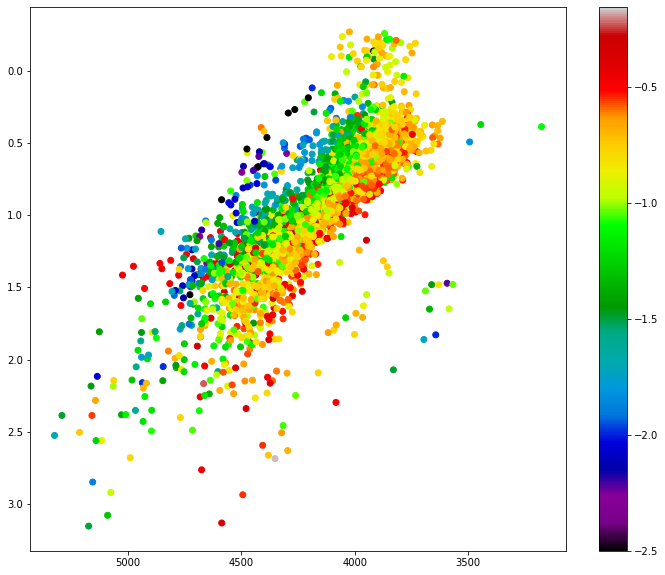

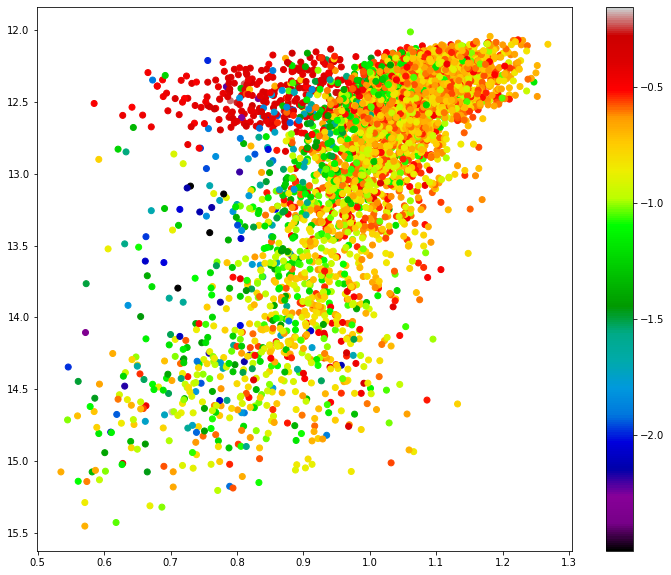

In [5]:
plt.figure(figsize=[12,10])
plt.scatter(lmc['TEFF'],lmc['LOGG'],c=lmc['FE_H'],cmap='nipy_spectral')
plt.colorbar()
plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
plt.show()

plt.figure(figsize=[12,10])
plt.scatter(lmc['J']-lmc['K'],lmc['K'],c=lmc['FE_H'],cmap='nipy_spectral')
plt.colorbar()
plt.gca().invert_yaxis()
plt.show()

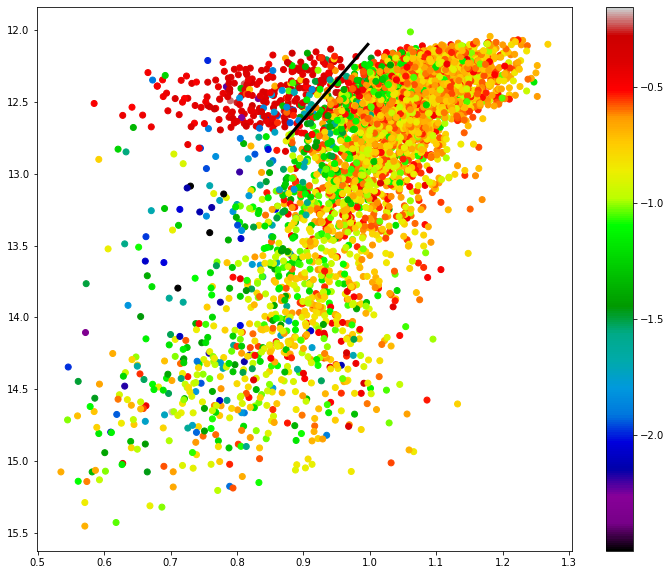

 
-5.372 x + 17.46


In [6]:
test_bloop = np.poly1d(np.polyfit([0.876,0.997],[12.75,12.1],1.))

plt.figure(figsize=[12,10])
plt.scatter(lmc['J']-lmc['K'],lmc['K'],c=lmc['FE_H'],cmap='nipy_spectral')
plt.colorbar()
plt.plot([0.876,0.997],[test_bloop(0.876),test_bloop(0.997)],c='k',lw=3.0)
plt.gca().invert_yaxis()
plt.show()

print(test_bloop)

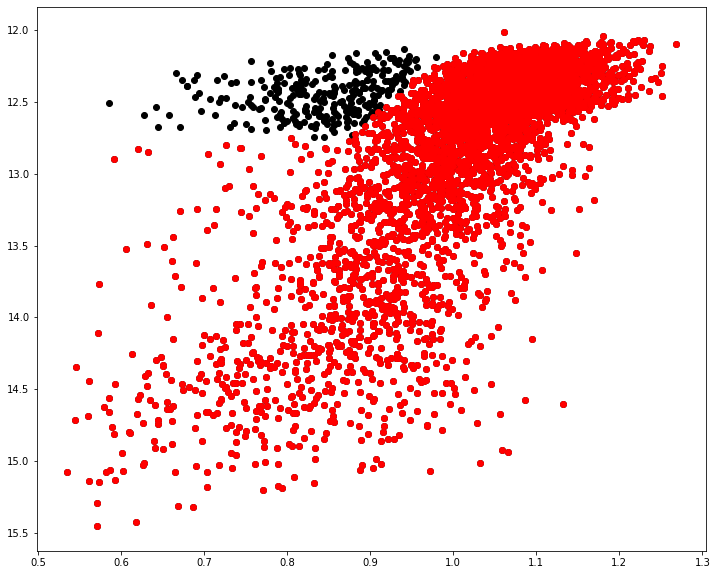

In [7]:
def bloopjkk(color):
    '''
    Function to calculate bloop boundary in J-K K space
    
    Input:
    -----
        color: J-K color
        
    Output:
    ------
        Value of cut
    '''
    x=color
    return np.piecewise(x,[x<=0.876,x>0.876],[lambda x: 12.75, lambda x: -5.372*x+17.46])

bloop_cut = np.where(lmc['K']>bloopjkk(lmc['J']-lmc['K']))

plt.figure(figsize=[12,10])
plt.scatter(lmc['J']-lmc['K'],lmc['K'],c='k')
plt.scatter((lmc['J']-lmc['K'])[bloop_cut],lmc['K'][bloop_cut],c='r')
plt.gca().invert_yaxis()
plt.show()

lmc = lmc[bloop_cut]
radius = radius[bloop_cut]
dist = dist[bloop_cut]

In [8]:
##########################
### Functions for MCMC ###
##########################

from scipy.optimize import minimize

def mad(dat):
    '''
    Calculate the median absolute deviation (MAD)
    
    Parameters:
    ----------
        dat: array-like object containing data
    
    Returns:
    -------
        dev: MAD(dat)
    '''
    dev = np.median(np.absolute(dat - np.median(dat)))
    return dev

def line(m,b,x):
    '''
    Slope-intercept form of a line
    
    Parameters:
    ----------
        m: slope of line
        x: exog of line
        b: intercept of line
        
    Returns:
    -------
        y: endog of line
    '''
    y = m*x + b
    return y

def lnL(theta,x,y,xerr,yerr):
    '''
    Log likelihood for line
    
    Parameters:
    ----------
        theta: parameters to plug into line (m,b)
        x: exog of line
        y: endog of line
        xerr: exog error
        yerr: endog error
    
    Returns:
    -------
        lnl: log likelihood 
    '''
    
    m, b = theta
    modl = line(m,b,x)
    inv_sig2 = np.reciprocal(np.square(yerr)+np.square(xerr))#+np.square(sigmodl))
    lnl = -0.5 * np.sum(np.multiply(np.square((y - modl)),inv_sig2) - np.log(inv_sig2/(2*np.pi)))
    return lnl

def lnPrior(theta):
    m, b = theta
    if -1.0 < m < 1.0 and -2.0 < b < 2.0:
        return 0.0
    return -np.inf

def lnProb(theta, x, y, xerr, yerr):
    lnP = lnPrior(theta)
    if not np.isfinite(lnP):
        return -np.inf
    return lnP + lnL(theta, x, y, xerr, yerr)

def MLELinearParameters(rad,abund,abund_err,bin_width):
    '''
    Calculate the MLE parameters for a linear abundance trend
    
    Inputs:
    ------
        rad: radial coordinate
        abund: elemental abundance
        yerr: error in y coordinate
        bin_width: width of bin
        
    Outputs:
    ------- 
        mle_m,mle_b: MLE parameters
    '''
    
    # bin data and calculate statistic and error for each bin
    bins = np.arange(np.floor(np.min(rad)),np.ceil(np.max(rad))+bin_width,bin_width)
    bin_stats, _, _ = binned_statistic(radius,abund,statistic='median',bins=bins)
    
    # get MAD of each bin
    bin_stats_err, _, _ = binned_statistic(rad,abund,statistic=lambda y: np.median(np.abs(y-np.median(y))),
                                           bins=bins)
    
    # shift radial values to center of bins
    center_rad_bins = np.delete(bin_edges,-1)+0.5*bin_width
    
    # calculate guess for MLE
    m_guess = (bin_stats[1]-bin_stats[0])/(center_rad_bins[1]-center_rad_bins[0])
    b_guess = bin_stats[0]
    
    # do MLE with log likelihood (lnL)
    nll = lambda *args: -lnL(*args)
    initial = np.array([m_guess, b_guess]) + 0.1 * np.random.randn(2)
    soln = minimize(nll, initial, args=(center_rad_bins, bin_stats, 0.5, bin_stats_err))
    mle_m, mle_b = soln.x
    
    return mle_m,mle_b

# Find Gradients

In [14]:
# cln = np.where(np.isfinite(lmc['C_FE'])==True)
# binned_statistic(radius[cln],lmc['C_FE'][cln],statistic='median')

mle_ms = []
mle_bs = []

for i in range(len(elems)):
    cln = np.where((np.isfinite(lmc[elems[i]])==True)&(lmc[elems[i]]!=-9999.0)&(lmc['SNR']>100.))
    bins = np.arange(np.floor(np.min(radius[cln])),np.ceil(np.max(radius[cln]))+1.0,1.0)
    bin_stats, bin_edges, bin_number = binned_statistic(radius[cln],lmc[elems[i]][cln],statistic='median',
                                                        bins=bins)
    bin_stats_err, _, _ = binned_statistic(radius[cln],lmc[elems[i]][cln],
                                           statistic=lambda y: np.median(np.abs(y-np.median(y))),bins=bins)
#     bin_stats_err = []
#     for j in range(len(np.unique(bin_number))):
#         bin_j = np.where(bin_number==np.unique(bin_number)[j])
#         bin_stats_err.append(mad(lmc[elems[i]][bin_j]))
    
    center_rad_bins = np.arange(len(bin_stats))+0.5
    
    m_guess = (bin_stats[1]-bin_stats[0])/(center_rad_bins[1]-center_rad_bins[0])
    b_guess = bin_stats[0]
    
    nll = lambda *args: -lnL(*args)
    initial = np.array([m_guess, b_guess]) + 1e-3*np.random.randn(2)
    soln = minimize(nll, initial, args=(center_rad_bins,bin_stats,0.5*np.ones(len(bin_stats)),bin_stats_err))
    mle_m, mle_b = soln.x
    
    mle_ms.append(mle_m)
    mle_bs.append(mle_b)

### [Fe/H] ###


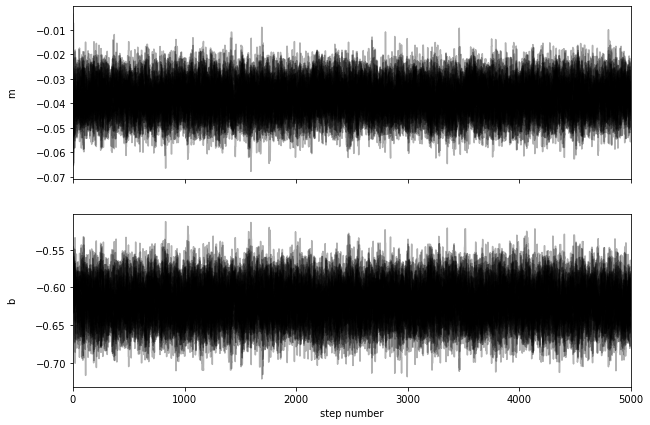

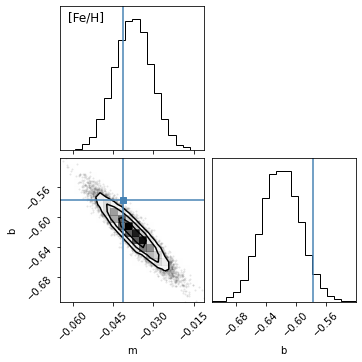

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [O/Fe] ###


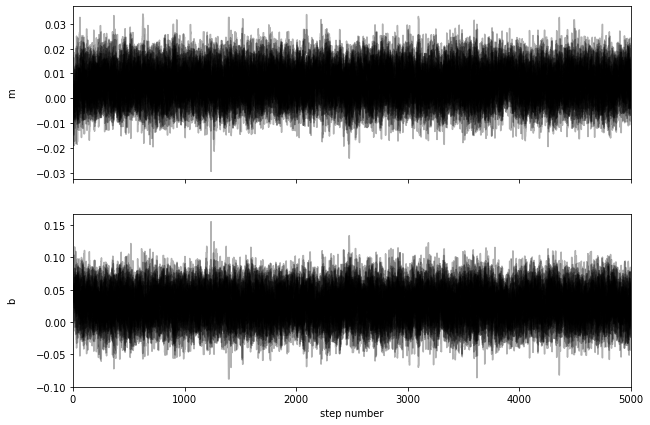

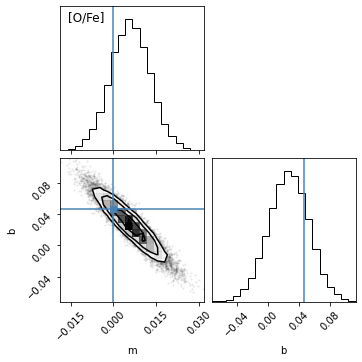

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Mg/Fe] ###


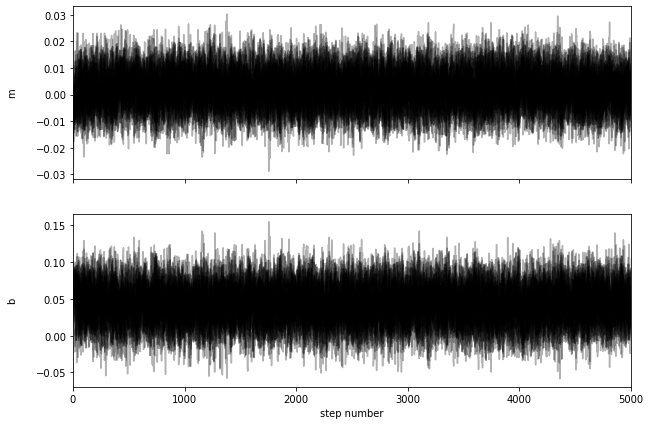

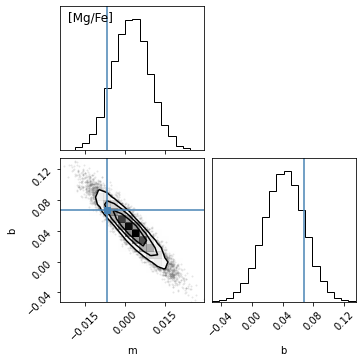

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Si/Fe] ###


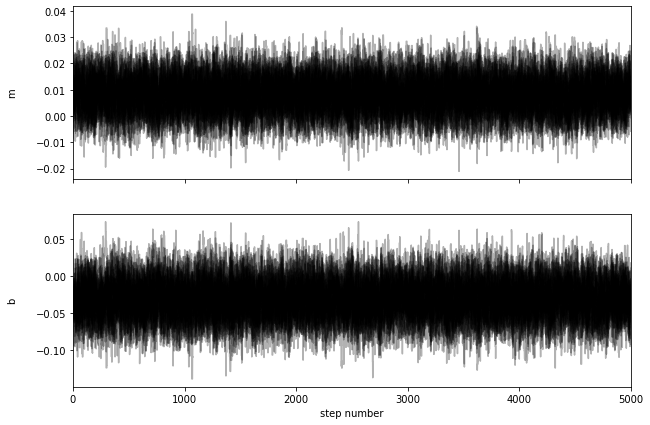

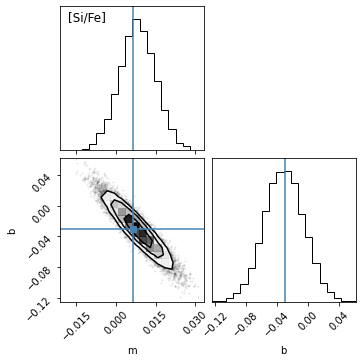

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ca/Fe] ###


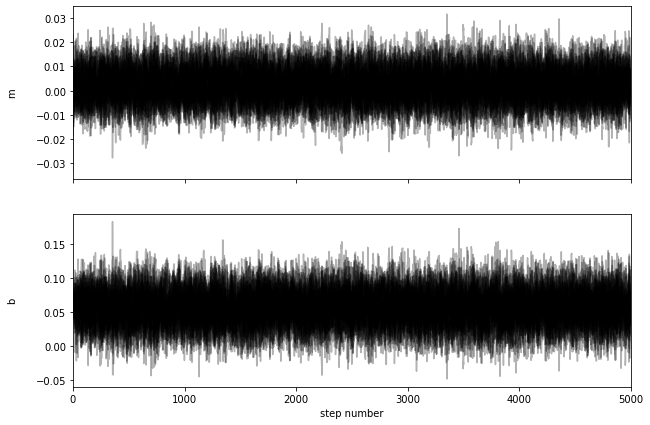

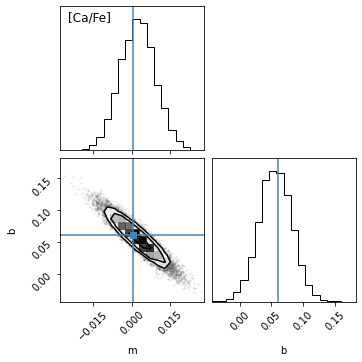

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Na/Fe] ###


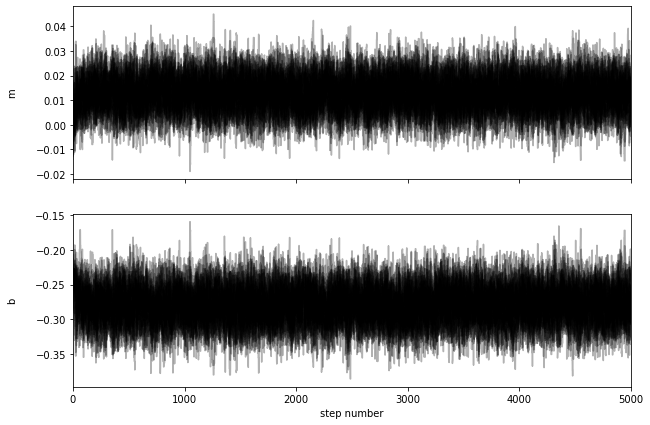

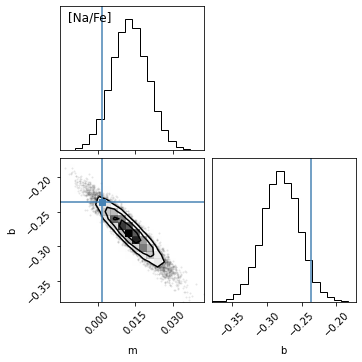

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Al/Fe] ###


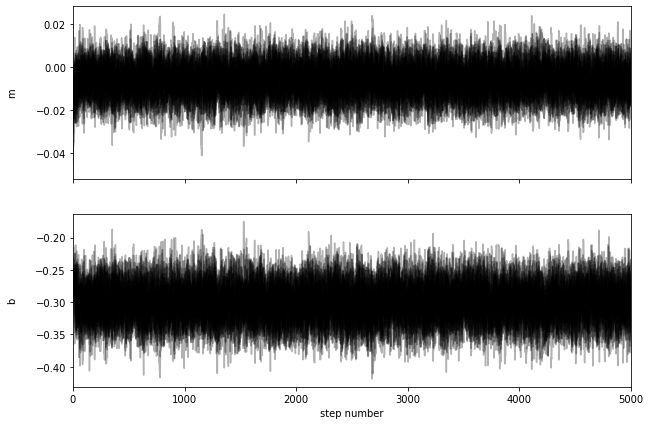

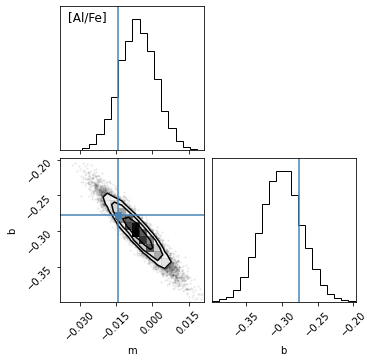

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Cr/Fe] ###


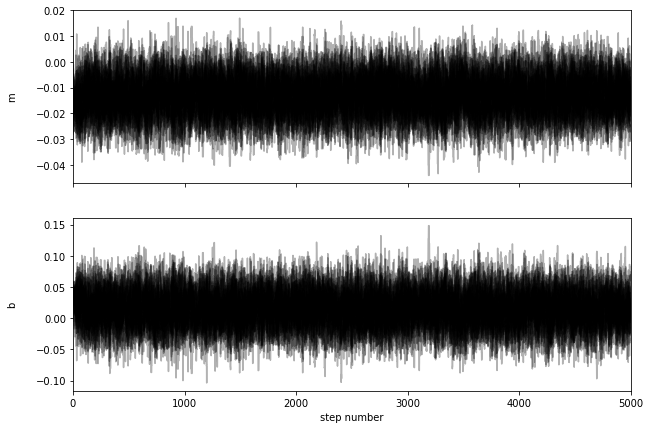

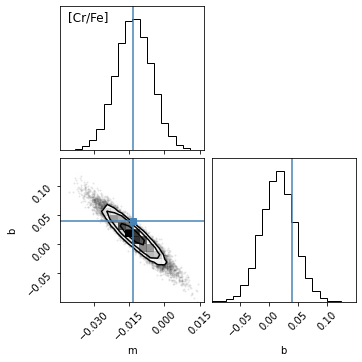

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Co/Fe] ###


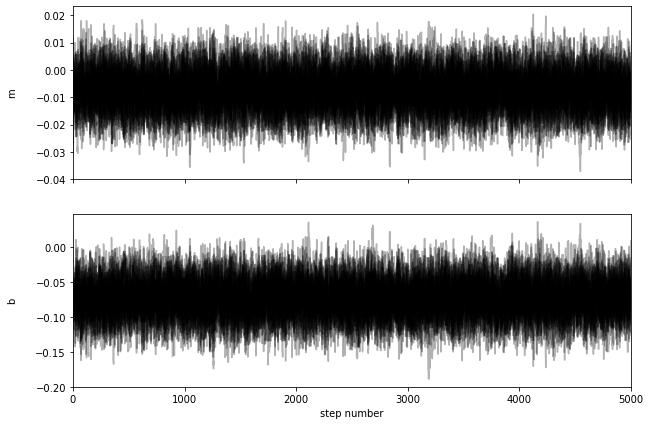

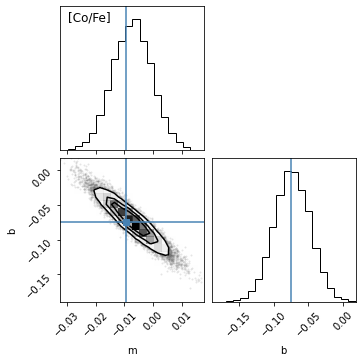

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ni/Fe] ###


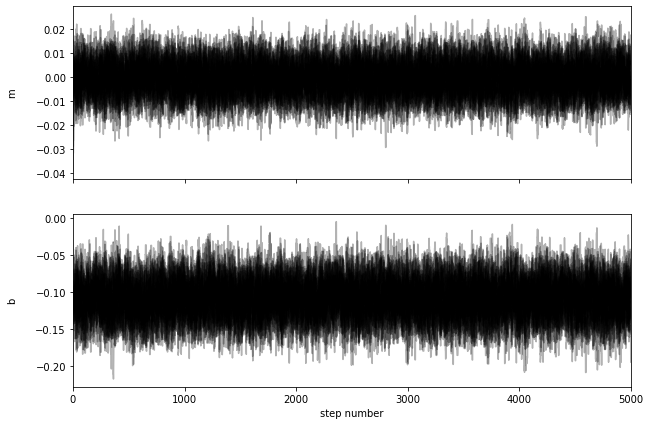

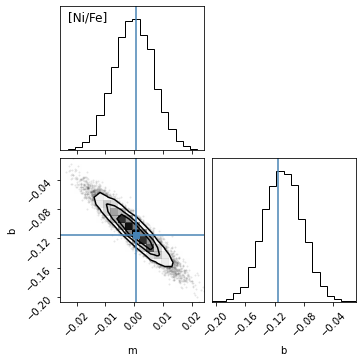

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [15]:
from IPython.display import display, Math

grads = []
grads_err = []
inter = []
inter_err = []
for i in tqdm_notebook(range(len(elems))):
    cln = np.where((np.isfinite(lmc[elems[i]])==True)&(lmc[elems[i]]!=-9999.0)&(lmc['SNR']>100.))
    pos = [mle_ms[i],mle_bs[i]]+1e-2*np.random.randn(32,2)
#     nwlakers, ndim = pos.shape
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, args=(radius[cln],lmc[elems[i]][cln],
                                                                  0.5*np.ones(len(lmc[cln])),
                                                                  lmc[elems[i]+'_ERR'][cln]))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('initial_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_ms[i], mle_bs[i]])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('initial_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    grads.append(np.median(flat_samples[:,0]))
    grads_err.append(mad(flat_samples[:,0]))
    inter.append(np.median(flat_samples[:,1]))
    inter_err.append(mad(flat_samples[:,1]))

In [16]:
for i in range(len(grads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],grads[i],grads_err[i],
                                                                          inter[i],inter_err[i]))

FE_H slope: -0.0376 +/- 0.0047; inter: -0.6204 +/- 0.0177
O_FE slope: 0.0059 +/- 0.0047; inter: 0.0269 +/- 0.0173
MG_FE slope: 0.0022 +/- 0.0047; inter: 0.0424 +/- 0.0174
SI_FE slope: 0.0081 +/- 0.0046; inter: -0.0309 +/- 0.0174
CA_FE slope: 0.0023 +/- 0.0047; inter: 0.0561 +/- 0.0177
NA_FE slope: 0.0128 +/- 0.0048; inter: -0.2797 +/- 0.0178
AL_FE slope: -0.0061 +/- 0.0051; inter: -0.3008 +/- 0.0193
CR_FE slope: -0.0131 +/- 0.0051; inter: 0.0154 +/- 0.0192
CO_FE slope: -0.0073 +/- 0.0047; inter: -0.0736 +/- 0.0172
NI_FE slope: -0.0004 +/- 0.0047; inter: -0.1088 +/- 0.0177


In [17]:
# Ages
ages = fits.getdata('/Users/joshuapovick/Desktop/Research/LMC_Ages/Polynomial_LMC_Ages/TEST_pca_ols_agesDR17.fits')

#####################
### Make Age Bins ###
#####################

young = np.where((ages['AGE']>0.0)&(ages['AGE']<=np.log10(0.5*10**9)))
yless = np.where((ages['AGE']>np.log10(0.5*10**9))&(ages['AGE']<=np.log10(2.0*10**9)))
ymed = np.where((ages['AGE']>np.log10(2.0*10**9))&(ages['AGE']<=np.log10(7*10**9)))
omed = np.where((ages['AGE']>np.log10(7*10**9))&(ages['AGE']<=np.log10(10.5*10**9)))
old = np.where(ages['AGE']>np.log10(10.5*10**9))

lmcyoung = lmc[young]
lmcyless = lmc[yless]
lmcymed = lmc[ymed]
lmcomed = lmc[omed]
lmcold = lmc[old]
radiusyoung = radius[young]
radiusyless = radius[yless]
radiusymed = radius[ymed]
radiusomed = radius[omed]
radiusold = radius[old]

In [18]:
np.where(ages['AGE']==-9999.0)

(array([2288, 2478, 3729, 3831, 4449]),)

# Young Gradients

### Young [Fe/H] ###


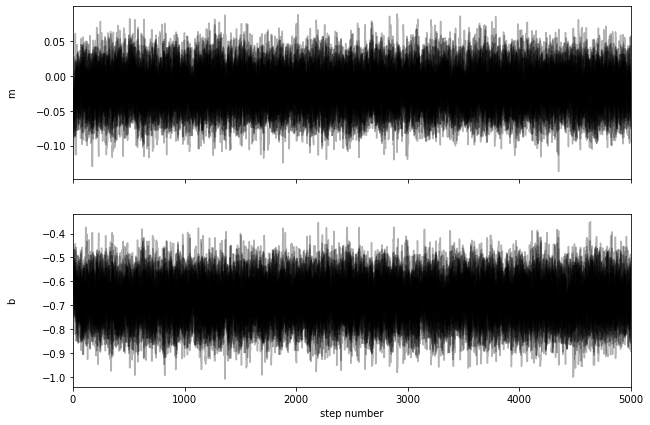

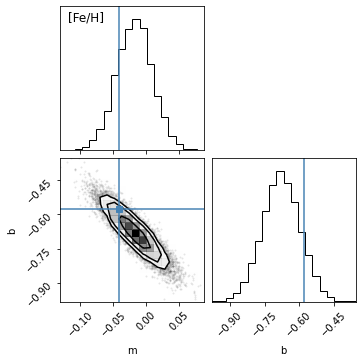

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### Young [O/Fe] ###


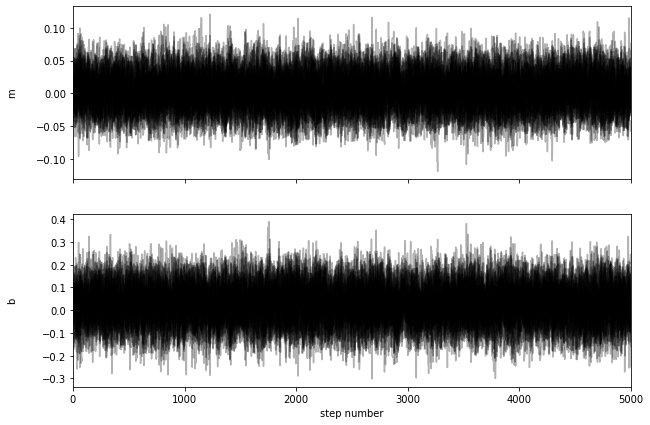

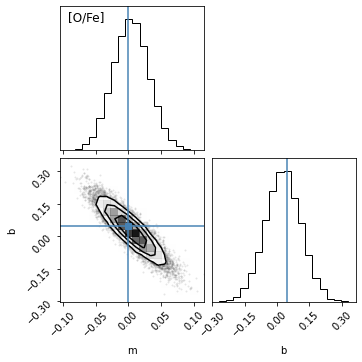

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### Young [Mg/Fe] ###


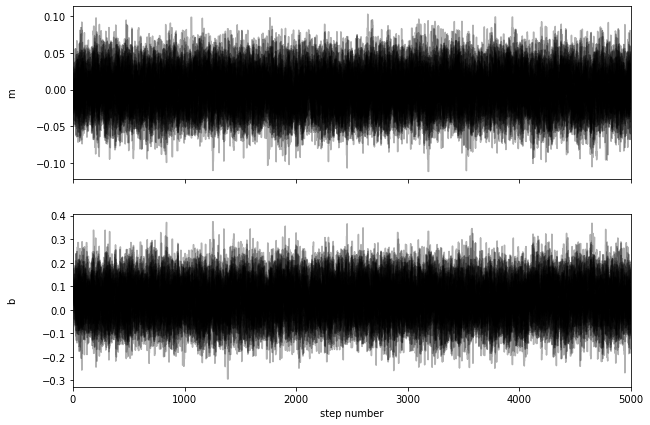

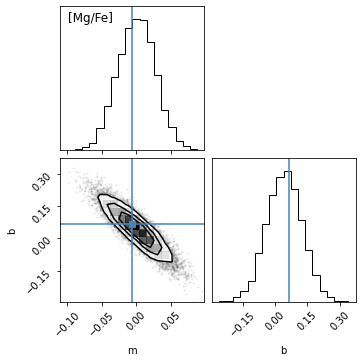

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### Young [Si/Fe] ###


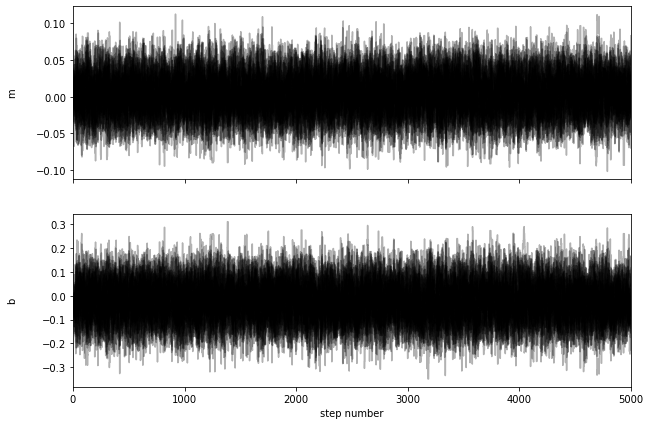

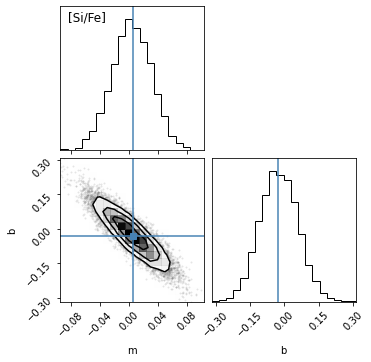

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### Young [Ca/Fe] ###


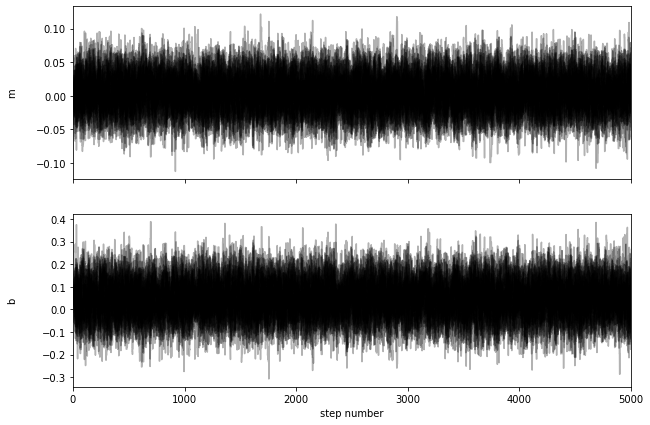

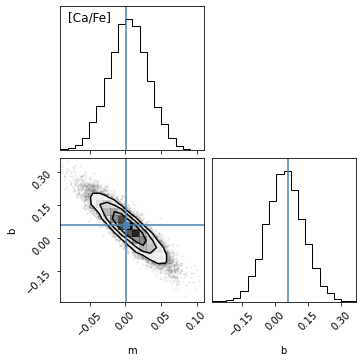

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### Young [Na/Fe] ###


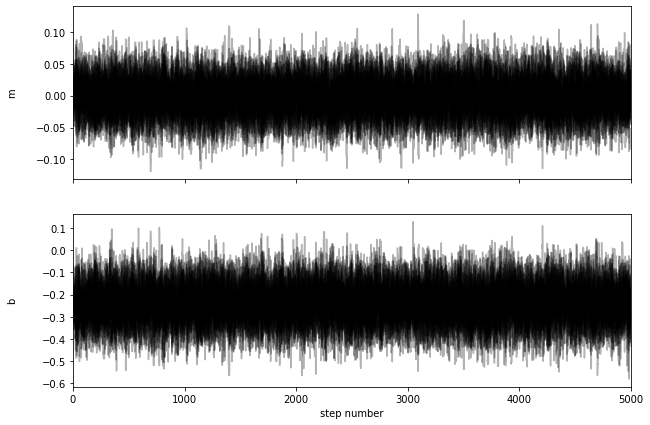

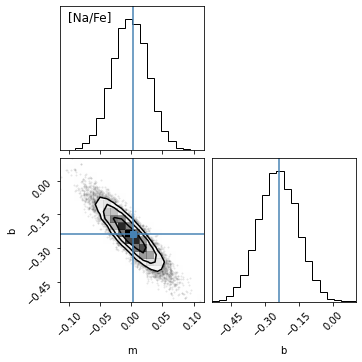

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### Young [Al/Fe] ###


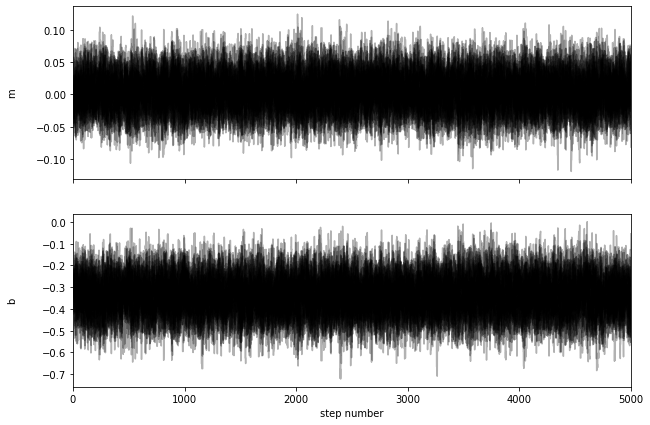

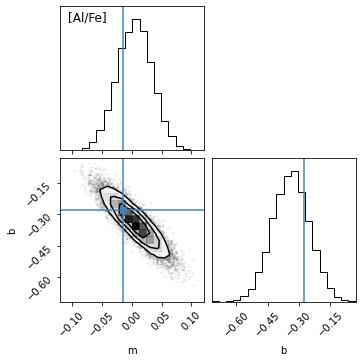

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### Young [Cr/Fe] ###


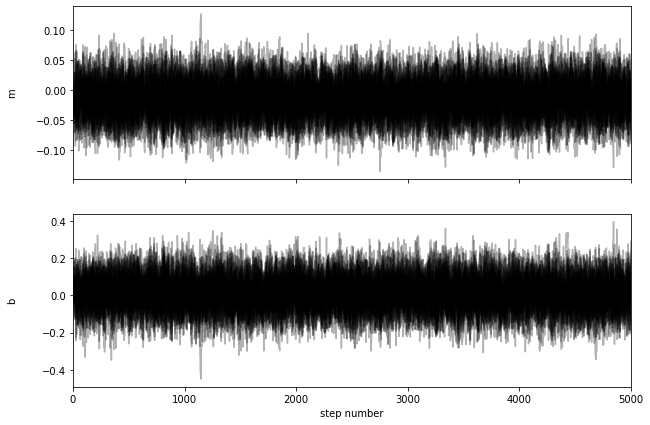

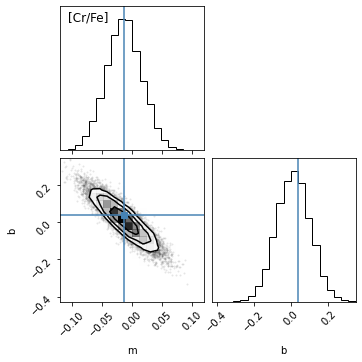

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### Young [Co/Fe] ###


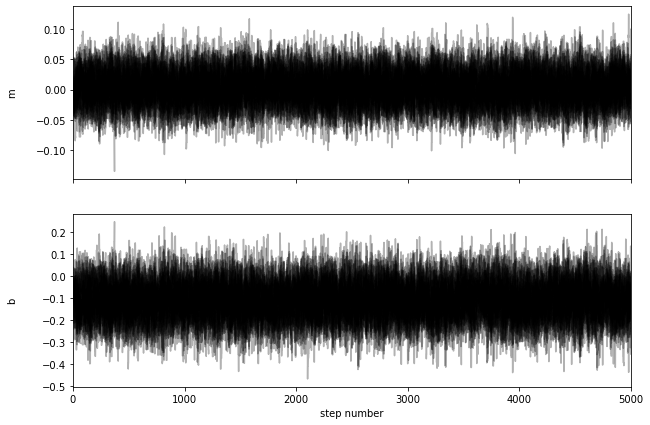

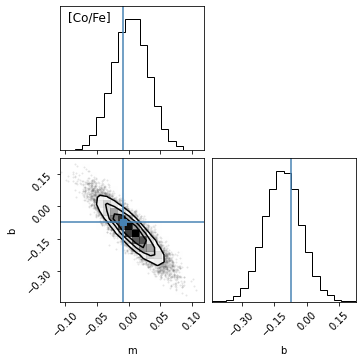

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### Young [Ni/Fe] ###


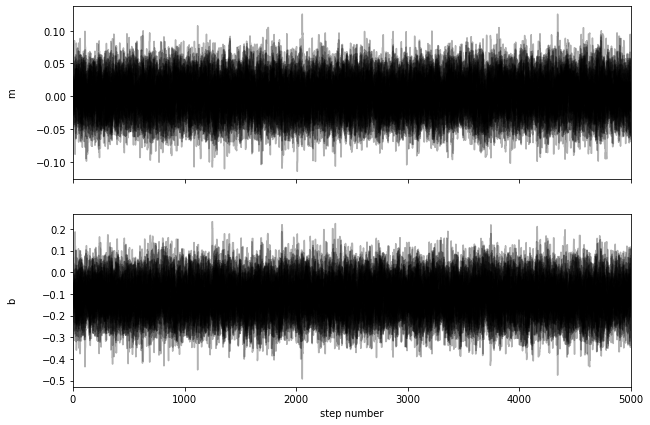

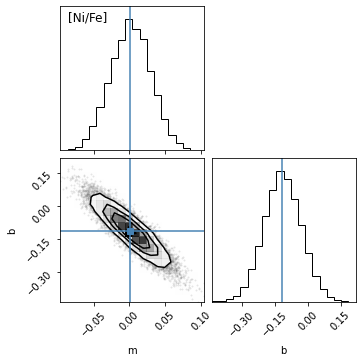

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [19]:
young_grads = []
young_grads_err = []
young_inter = []
young_inter_err = []
for i in tqdm_notebook(range(len(elems))):
    cln = np.where((np.isfinite(lmcyoung[elems[i]])==True)&(lmcyoung[elems[i]]!=-9999.0)&(lmcyoung['SNR']>100.))
    pos = [mle_ms[i],mle_bs[i]]+1e-2*np.random.randn(32,2)
#     nwlakers, ndim = pos.shape
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, 
                                    args=(radiusyoung[cln],lmcyoung[elems[i]][cln],
                                          0.5*np.ones(len(lmcyoung[cln])),lmcyoung[elems[i]+'_ERR'][cln]))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### Young {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('initial_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_ms[i], mle_bs[i]])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('initial_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    young_grads.append(np.median(flat_samples[:,0]))
    young_grads_err.append(mad(flat_samples[:,0]))
    young_inter.append(np.median(flat_samples[:,1]))
    young_inter_err.append(mad(flat_samples[:,1]))

In [20]:
for i in range(len(grads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],young_grads[i],
                                                                         young_grads_err[i],young_inter[i],
                                                                         young_inter_err[i]))

FE_H slope: -0.0178 +/- 0.0182; inter: -0.6786 +/- 0.0557
O_FE slope: 0.0038 +/- 0.0185; inter: 0.0282 +/- 0.0556
MG_FE slope: 0.0004 +/- 0.0185; inter: 0.0434 +/- 0.0554
SI_FE slope: 0.0037 +/- 0.0186; inter: -0.0244 +/- 0.0567
CA_FE slope: 0.0047 +/- 0.0184; inter: 0.0457 +/- 0.0557
NA_FE slope: -0.0022 +/- 0.0196; inter: -0.2410 +/- 0.0592
AL_FE slope: 0.0052 +/- 0.0199; inter: -0.3380 +/- 0.0593
CR_FE slope: -0.0134 +/- 0.0198; inter: 0.0114 +/- 0.0605
CO_FE slope: 0.0034 +/- 0.0189; inter: -0.1104 +/- 0.0567
NI_FE slope: 0.0016 +/- 0.0193; inter: -0.1146 +/- 0.0568


In [32]:
young_grads

[-0.01781332561020321,
 0.0038344477325412815,
 0.000411599926803838,
 0.003714164836829908,
 0.00466453449958946,
 -0.002220964231556226,
 0.005231933294415403,
 -0.013390156708776468,
 0.003389602958341363,
 0.001628778947937802]

# Yless Gradients

### yless [Fe/H] ###


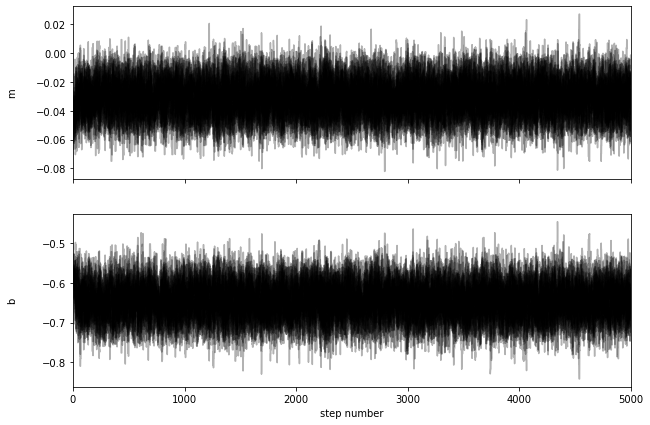

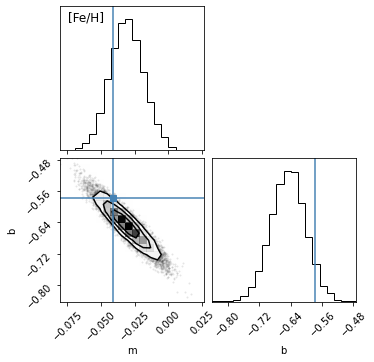

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### yless [O/Fe] ###


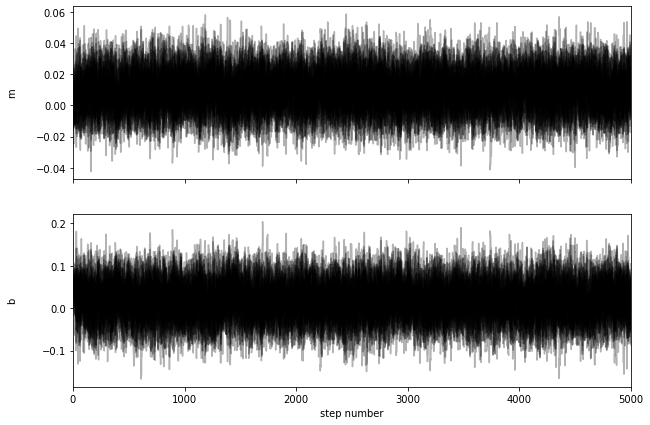

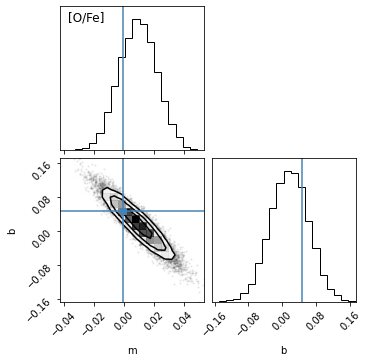

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### yless [Mg/Fe] ###


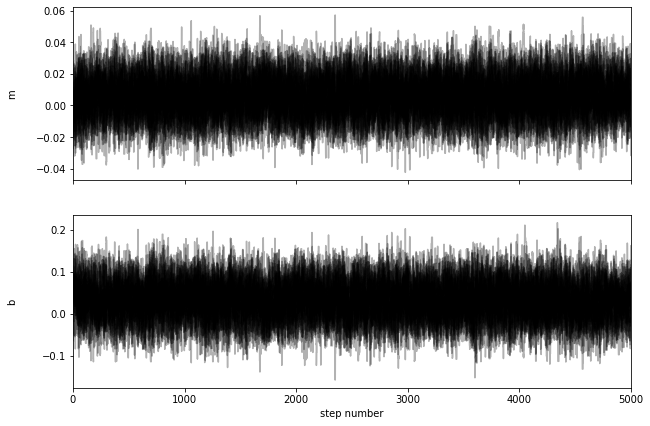

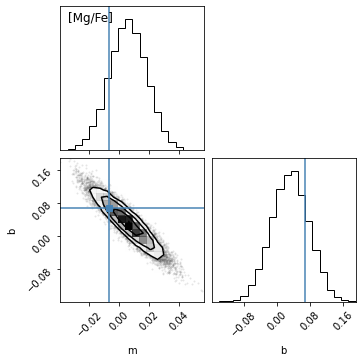

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### yless [Si/Fe] ###


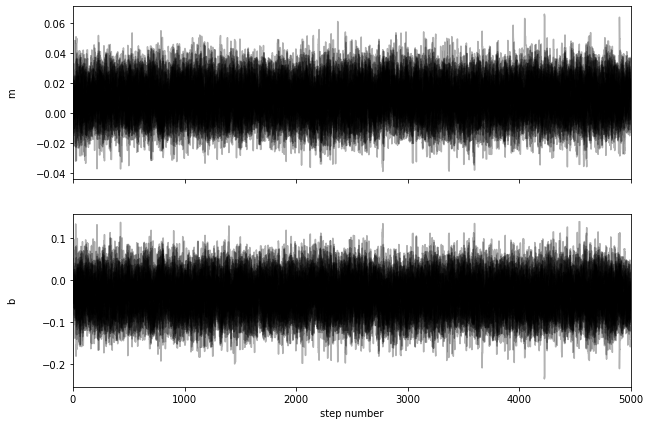

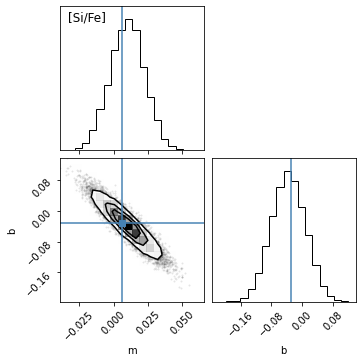

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### yless [Ca/Fe] ###


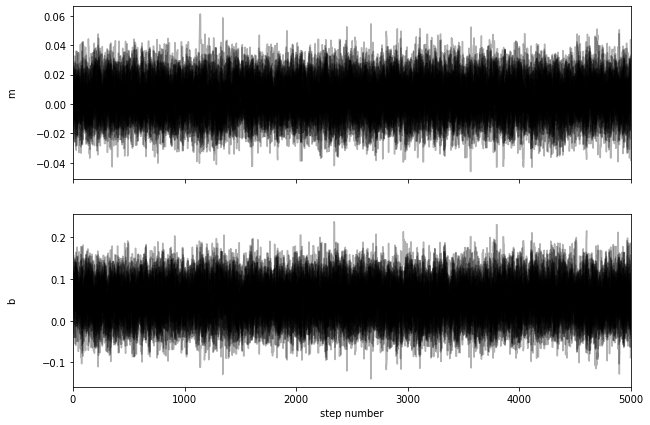

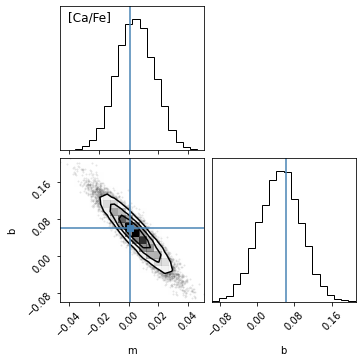

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### yless [Na/Fe] ###


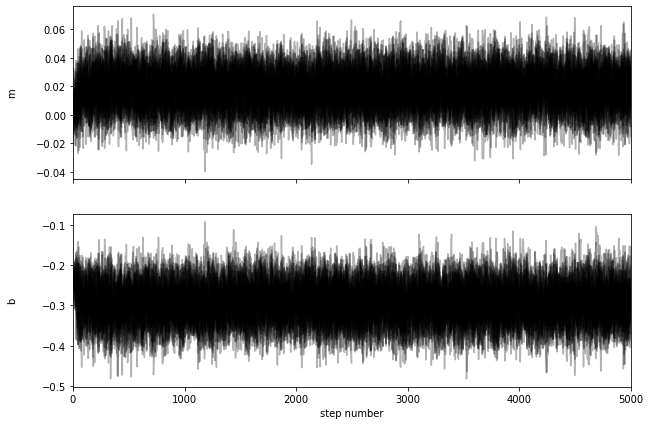

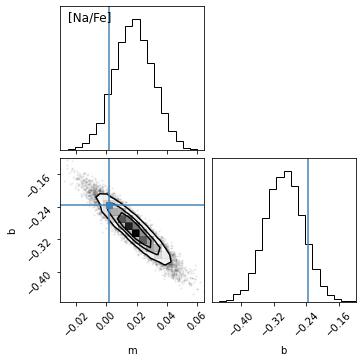

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### yless [Al/Fe] ###


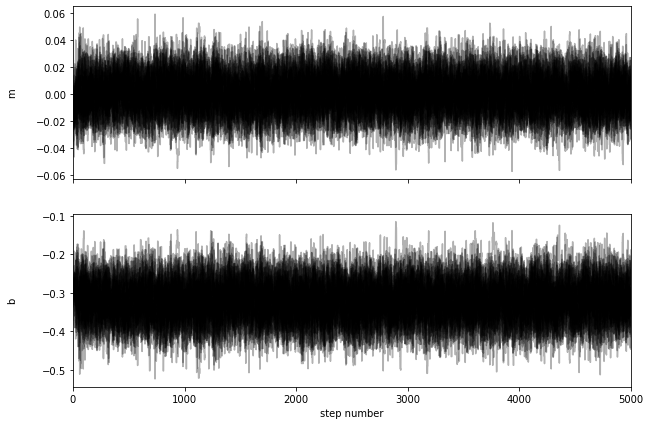

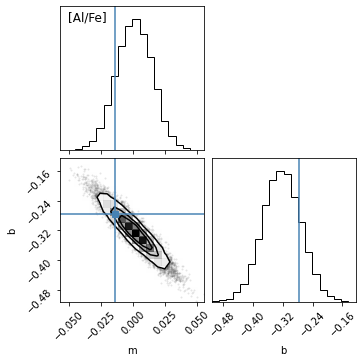

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### yless [Cr/Fe] ###


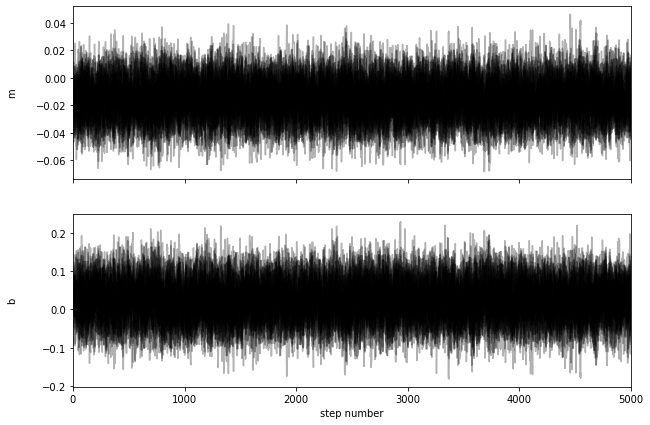

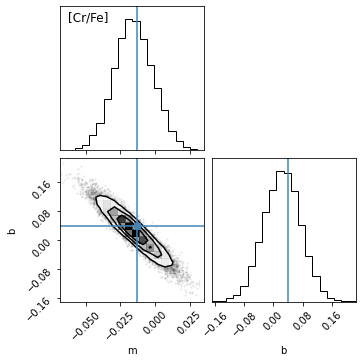

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### yless [Co/Fe] ###


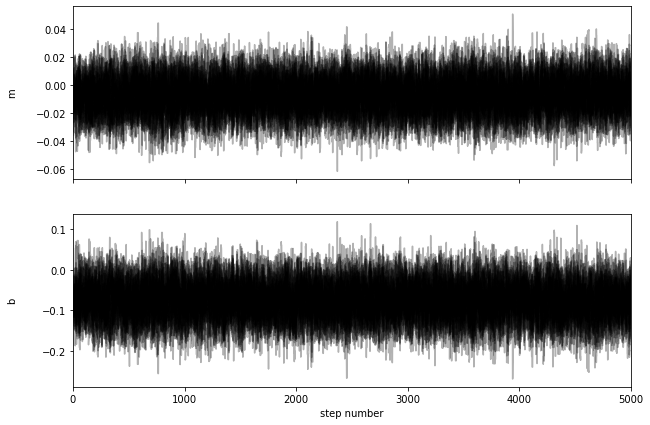

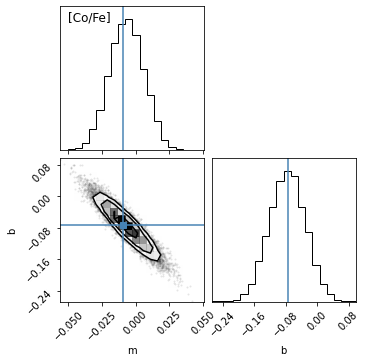

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### yless [Ni/Fe] ###


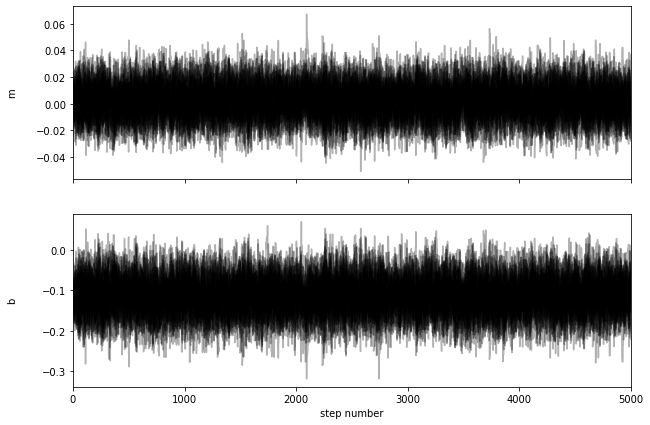

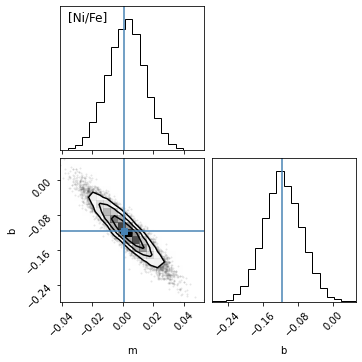

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [21]:
yless_grads = []
yless_grads_err = []
yless_inter = []
yless_inter_err = []
for i in tqdm_notebook(range(len(elems))):
    cln = np.where((np.isfinite(lmcyless[elems[i]])==True)&(lmcyless[elems[i]]!=-9999.0)&(lmcyless['SNR']>100.))
    pos = [mle_ms[i],mle_bs[i]]+1e-2*np.random.randn(32,2)
#     nwlakers, ndim = pos.shape
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, 
                                    args=(radiusyless[cln],lmcyless[elems[i]][cln],
                                          0.5*np.ones(len(lmcyless[cln])),lmcyless[elems[i]+'_ERR'][cln]))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### yless {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('initial_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_ms[i], mle_bs[i]])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('initial_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    yless_grads.append(np.median(flat_samples[:,0]))
    yless_grads_err.append(mad(flat_samples[:,0]))
    yless_inter.append(np.median(flat_samples[:,1]))
    yless_inter_err.append(mad(flat_samples[:,1]))

In [22]:
for i in range(len(grads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],yless_grads[i],
                                                                         yless_grads_err[i],yless_inter[i],
                                                                         yless_inter_err[i]))

FE_H slope: -0.0312 +/- 0.0084; inter: -0.6456 +/- 0.0295
O_FE slope: 0.0096 +/- 0.0087; inter: 0.0169 +/- 0.0303
MG_FE slope: 0.0059 +/- 0.0085; inter: 0.0321 +/- 0.0303
SI_FE slope: 0.0100 +/- 0.0084; inter: -0.0358 +/- 0.0299
CA_FE slope: 0.0046 +/- 0.0085; inter: 0.0495 +/- 0.0306
NA_FE slope: 0.0178 +/- 0.0089; inter: -0.2941 +/- 0.0314
AL_FE slope: 0.0010 +/- 0.0096; inter: -0.3229 +/- 0.0345
CR_FE slope: -0.0156 +/- 0.0094; inter: 0.0244 +/- 0.0346
CO_FE slope: -0.0068 +/- 0.0087; inter: -0.0757 +/- 0.0310
NI_FE slope: 0.0024 +/- 0.0082; inter: -0.1152 +/- 0.0295


# Ymed Gradients

### ymed [Fe/H] ###


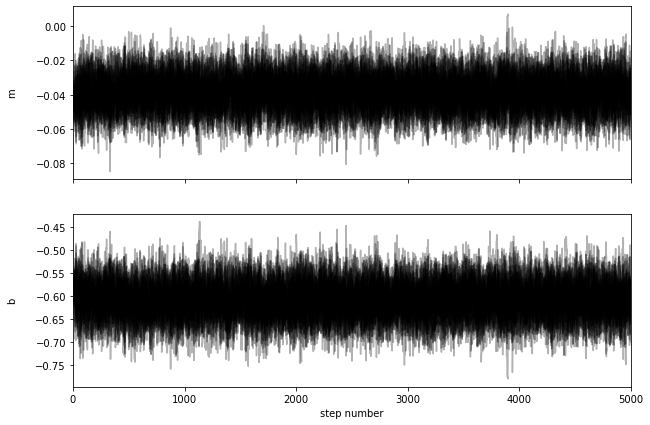

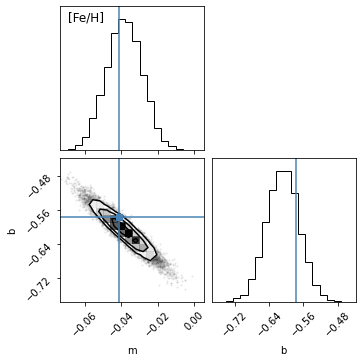

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### ymed [O/Fe] ###


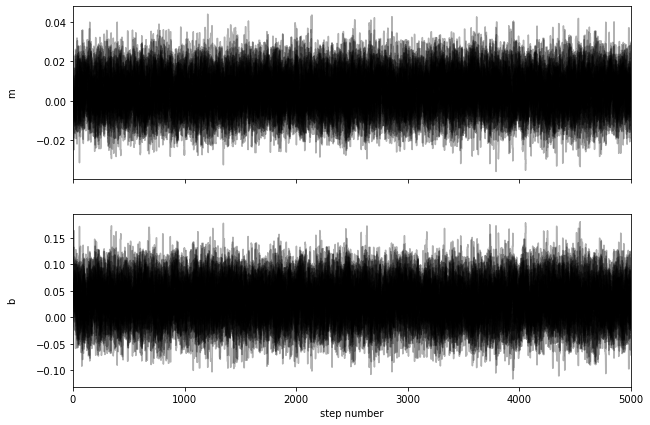

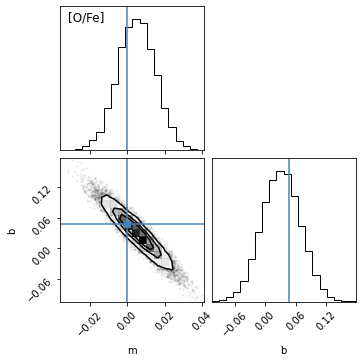

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### ymed [Mg/Fe] ###


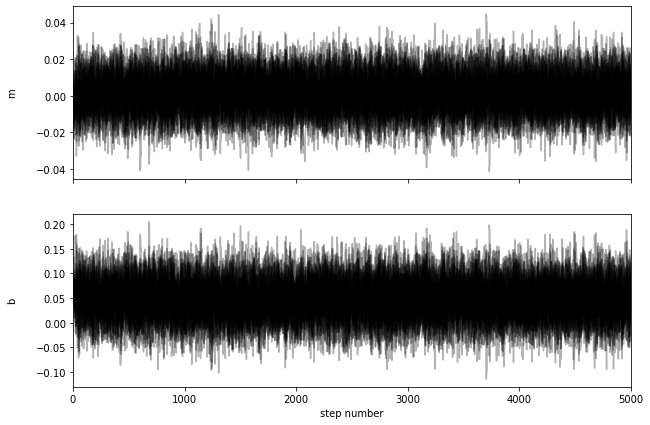

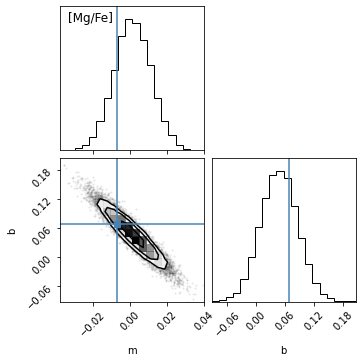

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### ymed [Si/Fe] ###


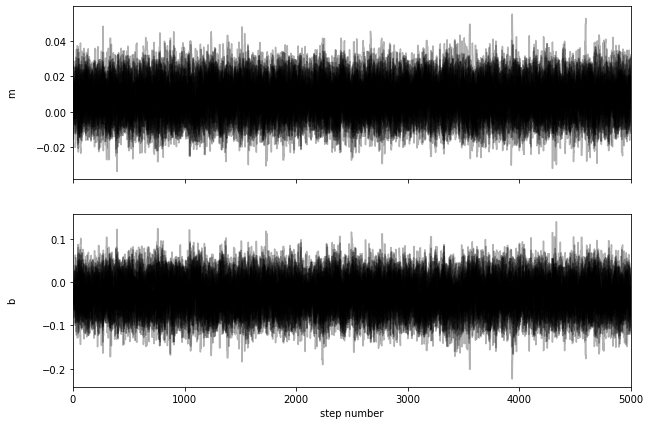

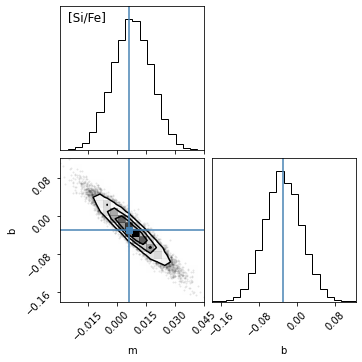

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### ymed [Ca/Fe] ###


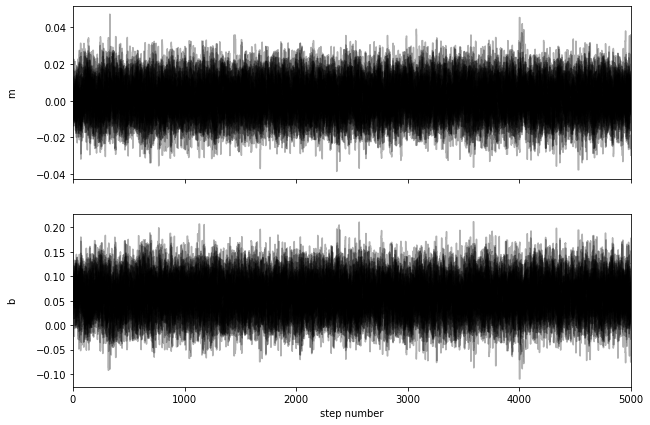

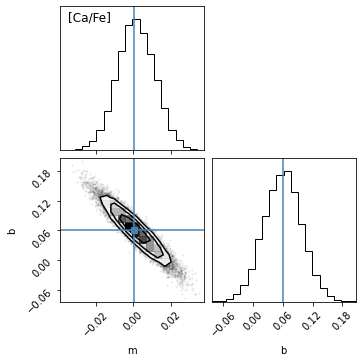

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### ymed [Na/Fe] ###


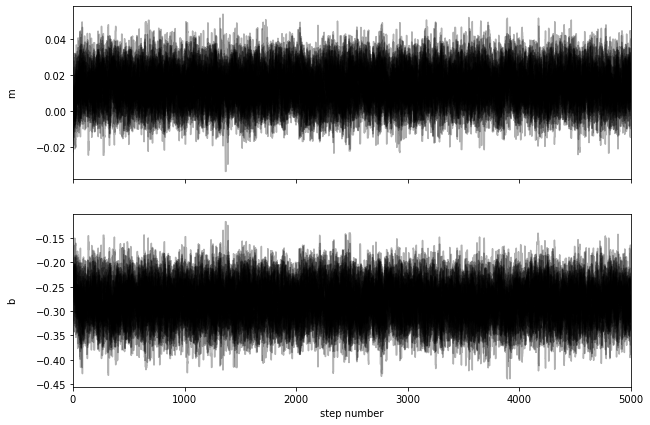

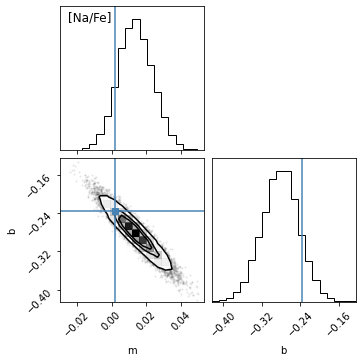

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### ymed [Al/Fe] ###


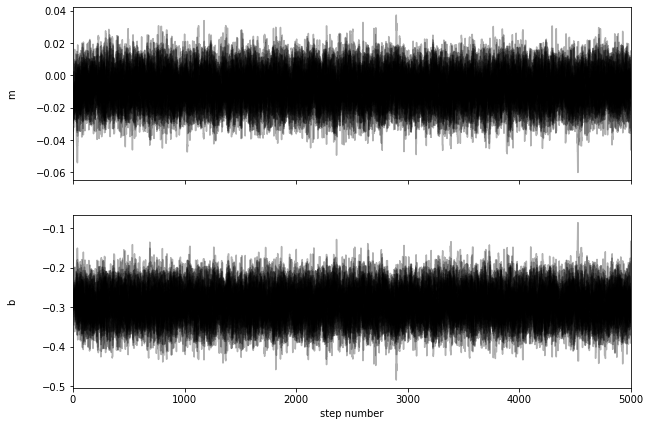

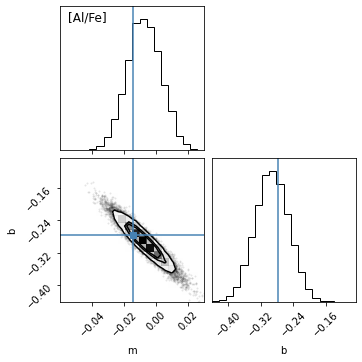

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### ymed [Cr/Fe] ###


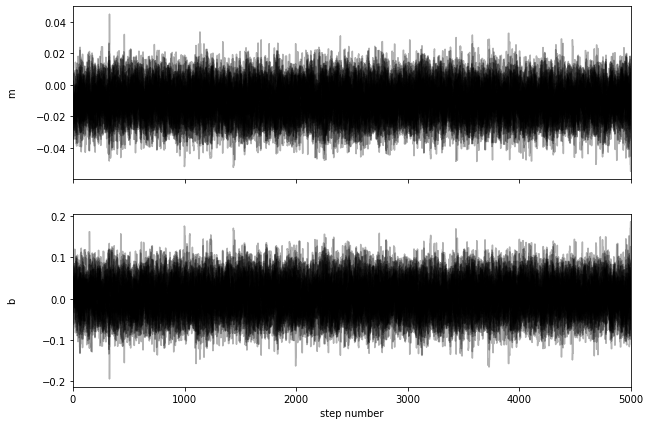

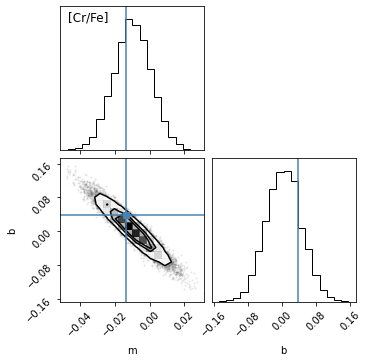

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### ymed [Co/Fe] ###


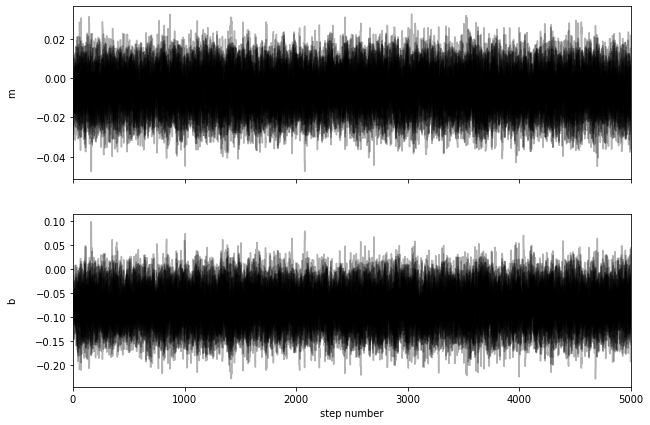

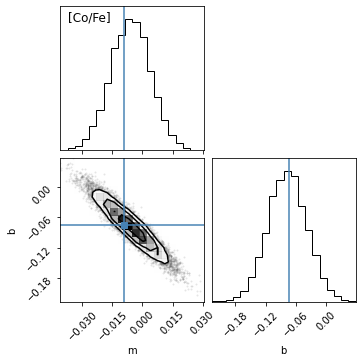

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### ymed [Ni/Fe] ###


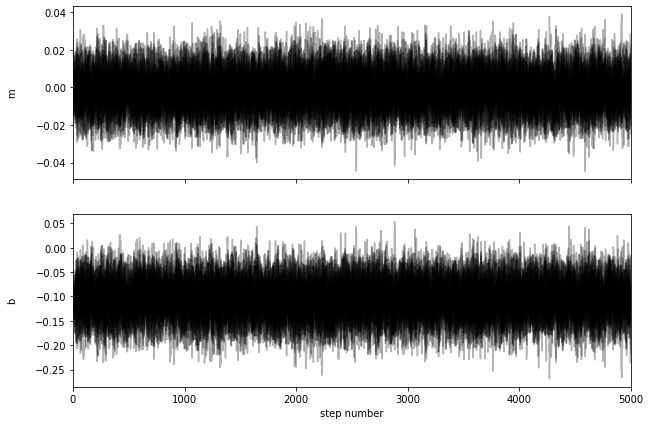

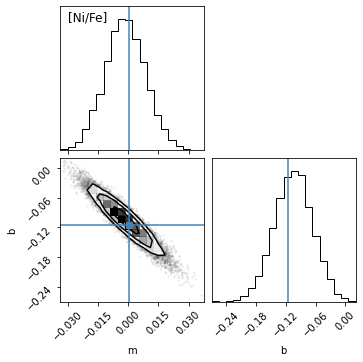

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [23]:
ymed_grads = []
ymed_grads_err = []
ymed_inter = []
ymed_inter_err = []
for i in tqdm_notebook(range(len(elems))):
    cln = np.where((np.isfinite(lmcymed[elems[i]])==True)&(lmcymed[elems[i]]!=-9999.0)&(lmcymed['SNR']>100.))
    pos = [mle_ms[i],mle_bs[i]]+1e-2*np.random.randn(32,2)
#     nwlakers, ndim = pos.shape
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, 
                                    args=(radiusymed[cln],lmcymed[elems[i]][cln],
                                          0.5*np.ones(len(lmcymed[cln])),lmcymed[elems[i]+'_ERR'][cln]))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### ymed {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('initial_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_ms[i], mle_bs[i]])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('initial_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    ymed_grads.append(np.median(flat_samples[:,0]))
    ymed_grads_err.append(mad(flat_samples[:,0]))
    ymed_inter.append(np.median(flat_samples[:,1]))
    ymed_inter_err.append(mad(flat_samples[:,1]))

In [24]:
for i in range(len(grads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],ymed_grads[i],
                                                                         ymed_grads_err[i],ymed_inter[i],
                                                                         ymed_inter_err[i]))

FE_H slope: -0.0385 +/- 0.0067; inter: -0.6082 +/- 0.0260
O_FE slope: 0.0048 +/- 0.0068; inter: 0.0314 +/- 0.0259
MG_FE slope: 0.0014 +/- 0.0068; inter: 0.0467 +/- 0.0258
SI_FE slope: 0.0077 +/- 0.0068; inter: -0.0296 +/- 0.0261
CA_FE slope: 0.0013 +/- 0.0068; inter: 0.0601 +/- 0.0258
NA_FE slope: 0.0136 +/- 0.0068; inter: -0.2806 +/- 0.0258
AL_FE slope: -0.0076 +/- 0.0072; inter: -0.2926 +/- 0.0280
CR_FE slope: -0.0099 +/- 0.0072; inter: 0.0047 +/- 0.0279
CO_FE slope: -0.0059 +/- 0.0068; inter: -0.0772 +/- 0.0259
NI_FE slope: -0.0015 +/- 0.0067; inter: -0.1046 +/- 0.0258


# Omed Gradients

### omed [Fe/H] ###


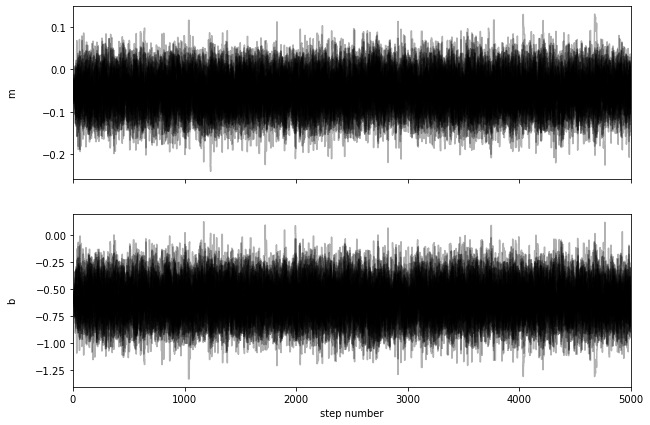

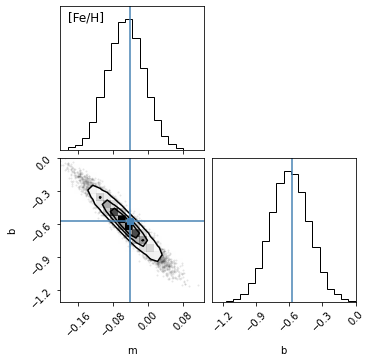

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### omed [O/Fe] ###


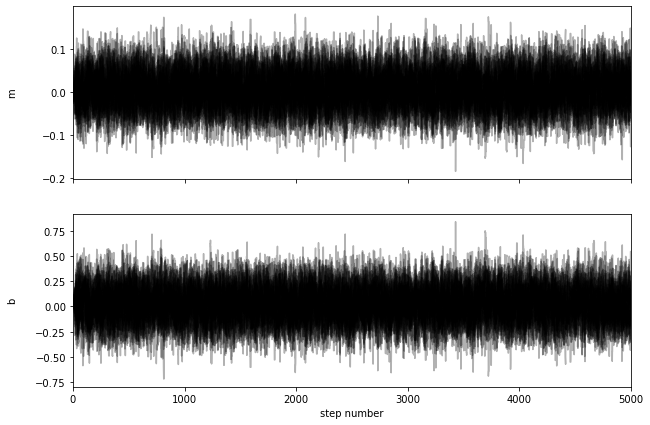

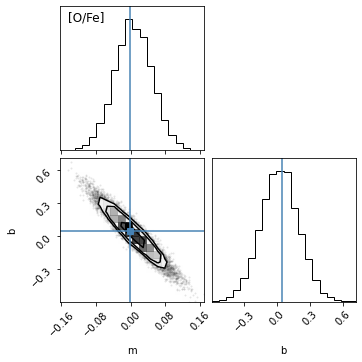

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### omed [Mg/Fe] ###


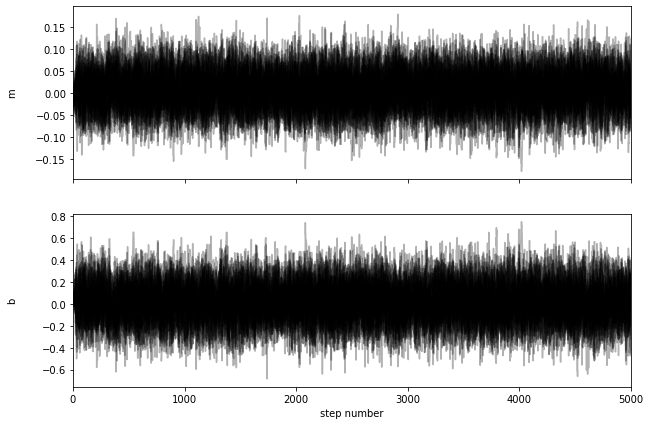

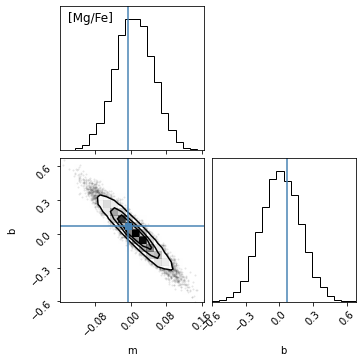

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### omed [Si/Fe] ###


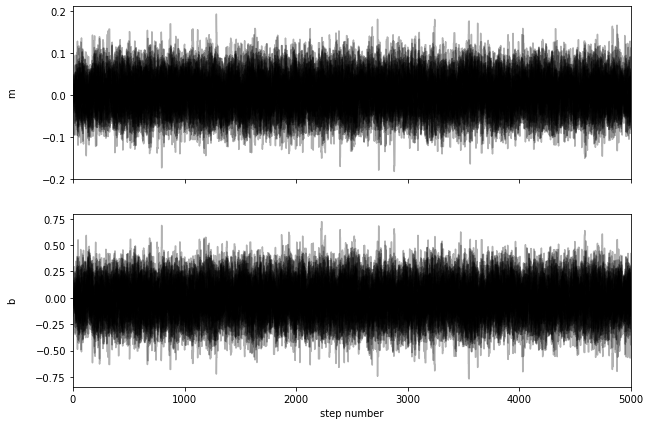

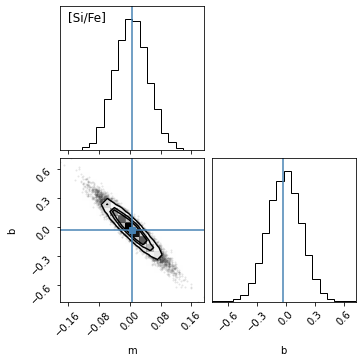

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### omed [Ca/Fe] ###


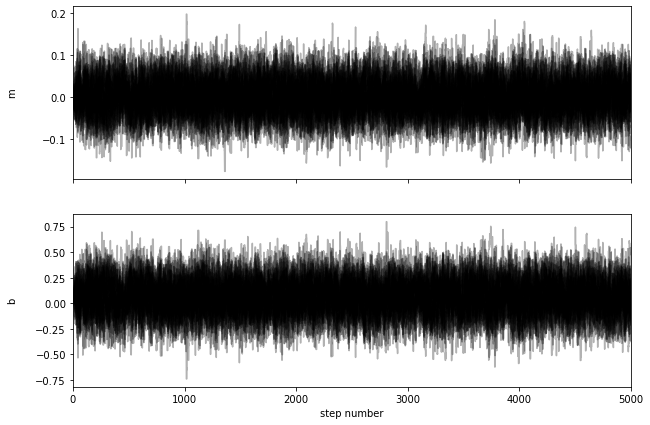

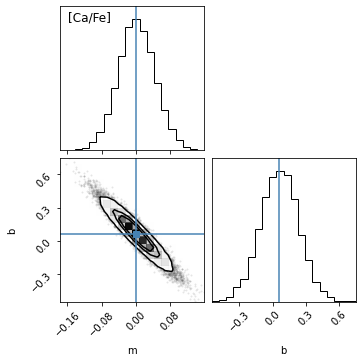

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### omed [Na/Fe] ###


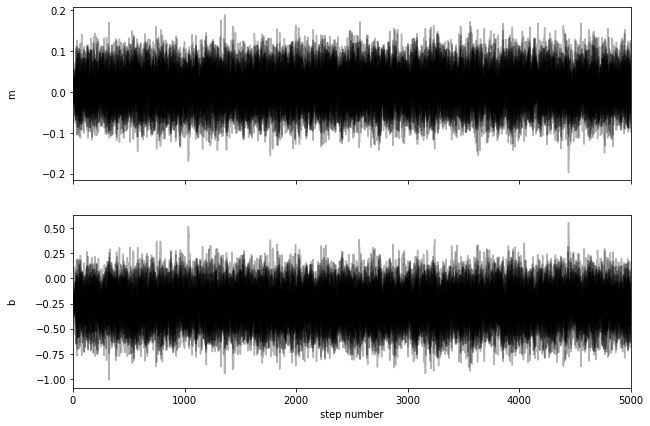

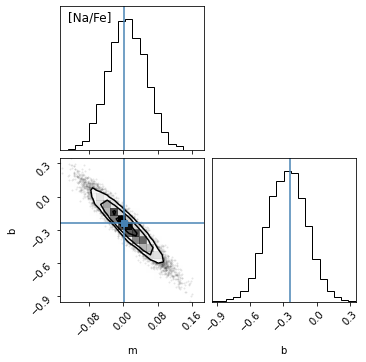

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### omed [Al/Fe] ###


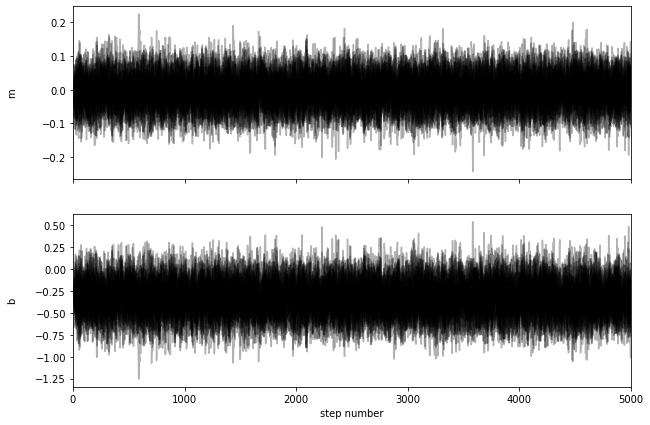

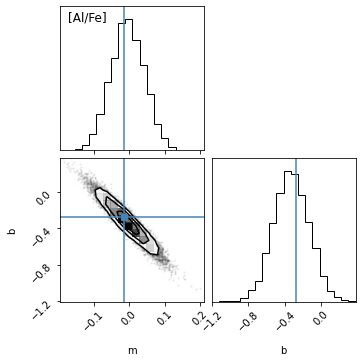

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### omed [Cr/Fe] ###


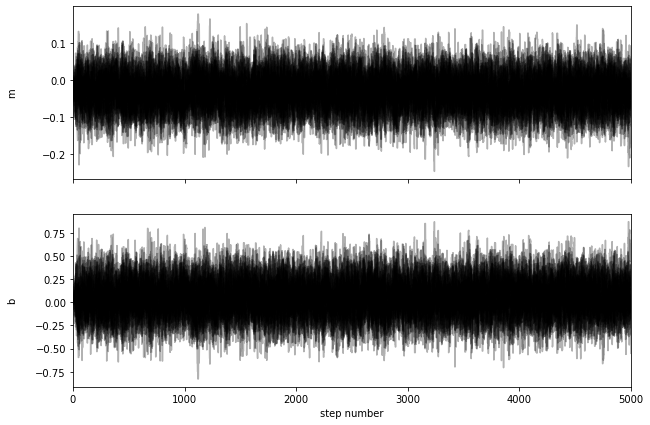

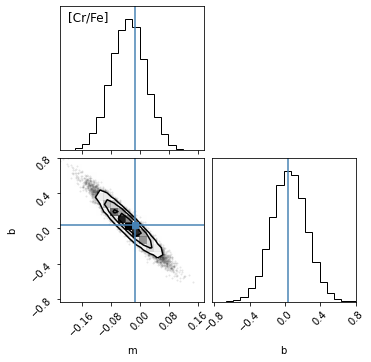

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### omed [Co/Fe] ###


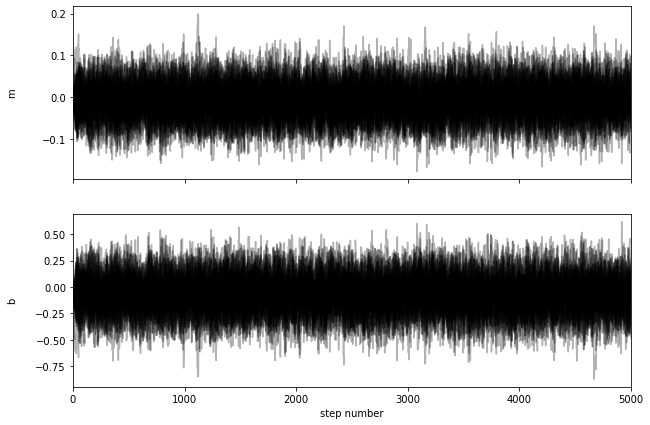

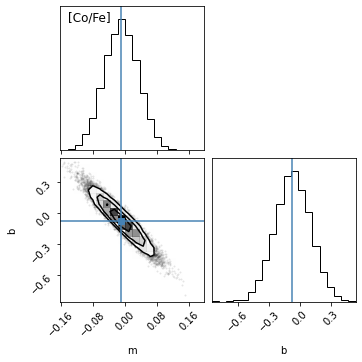

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### omed [Ni/Fe] ###


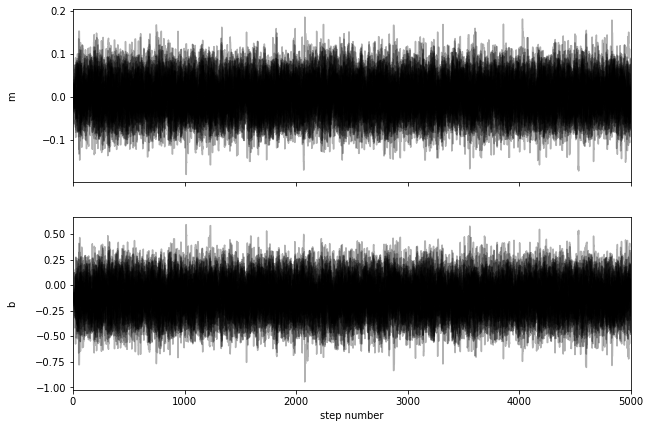

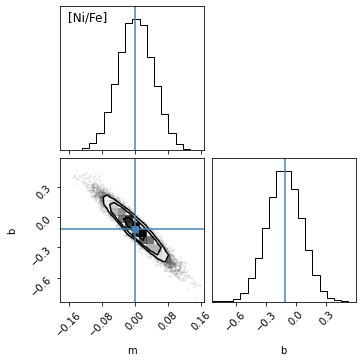

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [25]:
omed_grads = []
omed_grads_err = []
omed_inter = []
omed_inter_err = []
for i in tqdm_notebook(range(len(elems))):
    cln = np.where((np.isfinite(lmcomed[elems[i]])==True)&(lmcomed[elems[i]]!=-9999.0)&(lmcomed['SNR']>100.))
    pos = [mle_ms[i],mle_bs[i]]+1e-2*np.random.randn(32,2)
#     nwlakers, ndim = pos.shape
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, 
                                    args=(radiusomed[cln],lmcomed[elems[i]][cln],
                                          0.5*np.ones(len(lmcomed[cln])),lmcomed[elems[i]+'_ERR'][cln]))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### omed {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('initial_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_ms[i], mle_bs[i]])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('initial_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    omed_grads.append(np.median(flat_samples[:,0]))
    omed_grads_err.append(mad(flat_samples[:,0]))
    omed_inter.append(np.median(flat_samples[:,1]))
    omed_inter_err.append(mad(flat_samples[:,1]))

In [26]:
for i in range(len(grads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],omed_grads[i],
                                                                         omed_grads_err[i],omed_inter[i],
                                                                         omed_inter_err[i]))

FE_H slope: -0.0517 +/- 0.0291; inter: -0.5977 +/- 0.1168
O_FE slope: 0.0059 +/- 0.0291; inter: 0.0213 +/- 0.1162
MG_FE slope: 0.0075 +/- 0.0294; inter: 0.0140 +/- 0.1187
SI_FE slope: 0.0042 +/- 0.0292; inter: -0.0129 +/- 0.1162
CA_FE slope: 0.0005 +/- 0.0287; inter: 0.0630 +/- 0.1164
NA_FE slope: 0.0088 +/- 0.0297; inter: -0.2654 +/- 0.1179
AL_FE slope: -0.0051 +/- 0.0321; inter: -0.3322 +/- 0.1324
CR_FE slope: -0.0317 +/- 0.0320; inter: 0.0493 +/- 0.1324
CO_FE slope: -0.0089 +/- 0.0289; inter: -0.0706 +/- 0.1169
NI_FE slope: 0.0023 +/- 0.0289; inter: -0.1159 +/- 0.1155


# Old Gradients

### old [Fe/H] ###


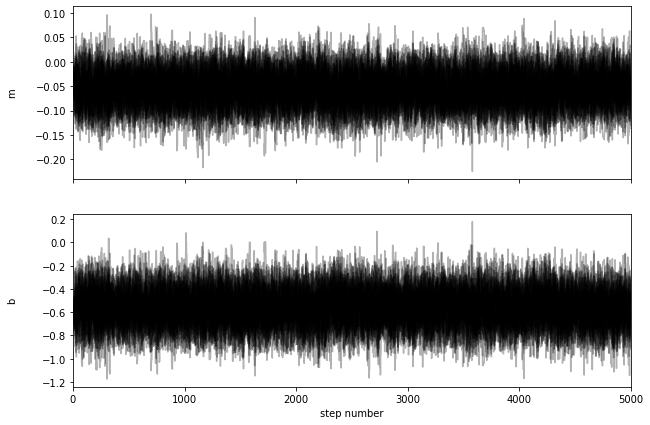

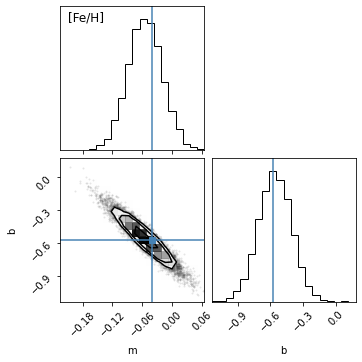

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### old [O/Fe] ###


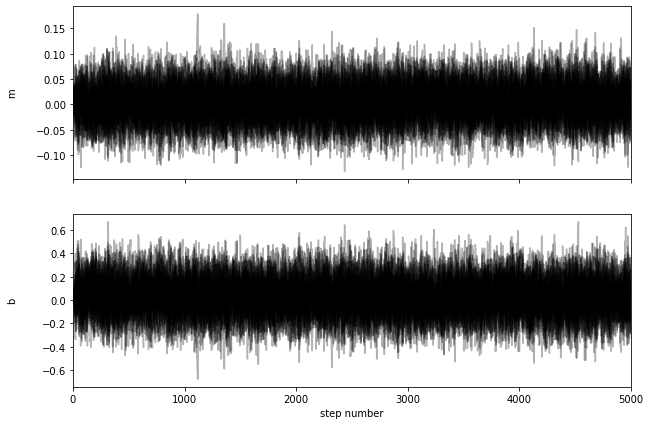

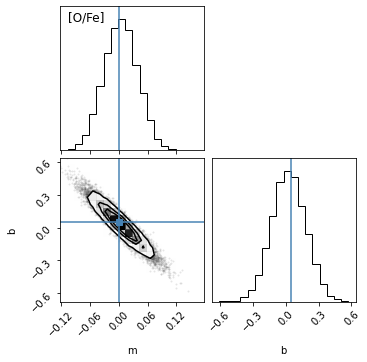

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### old [Mg/Fe] ###


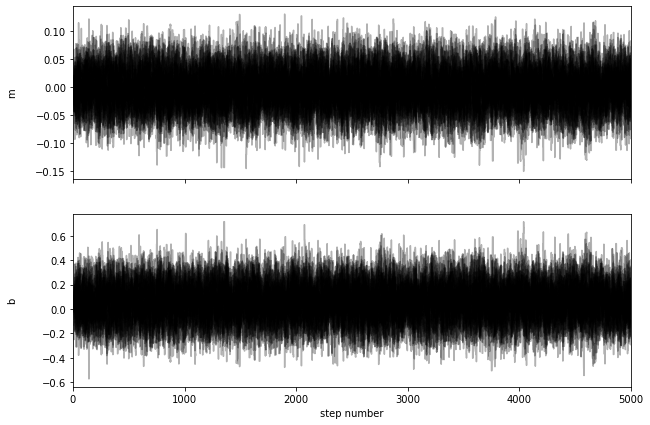

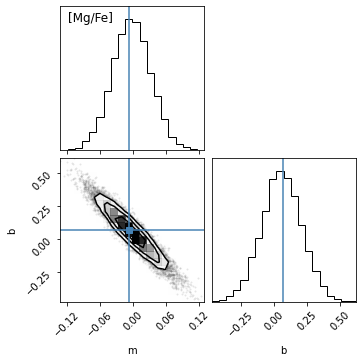

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### old [Si/Fe] ###


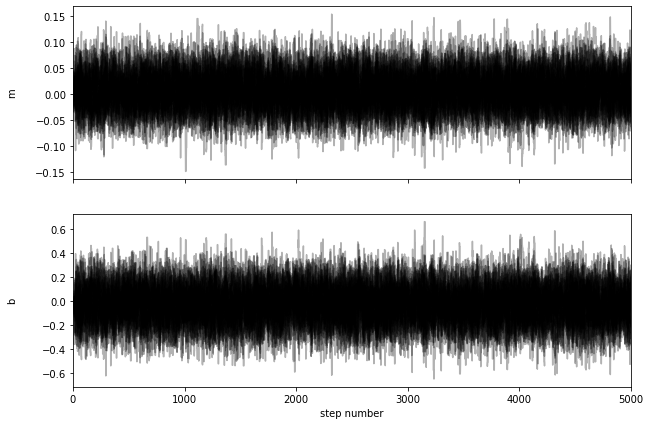

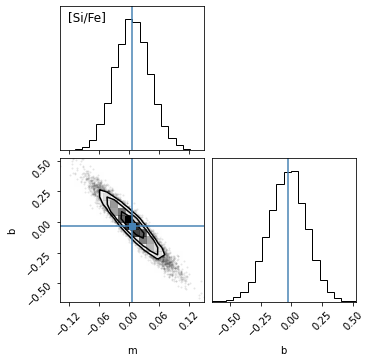

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### old [Ca/Fe] ###


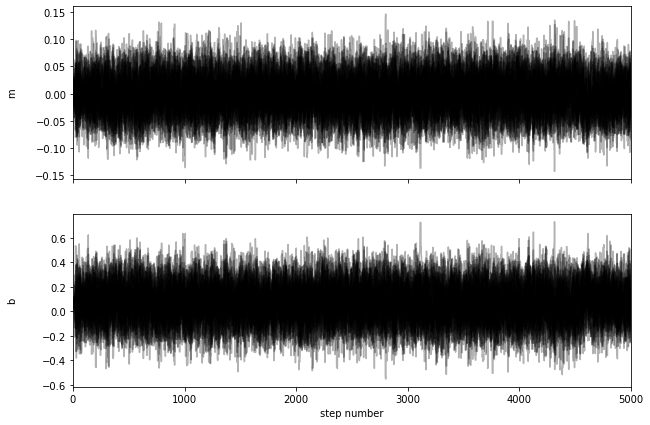

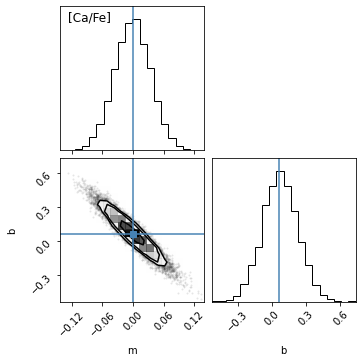

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### old [Na/Fe] ###


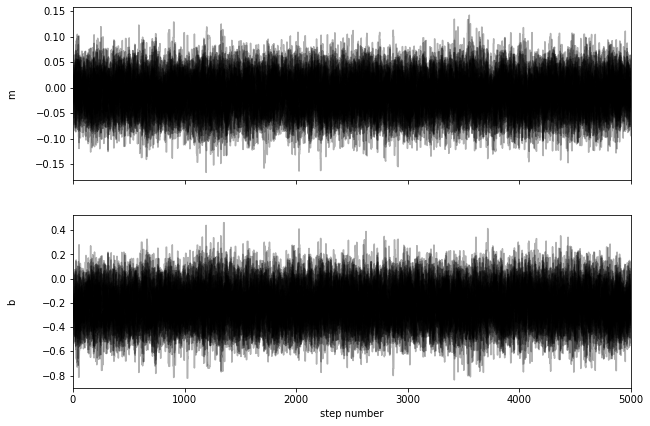

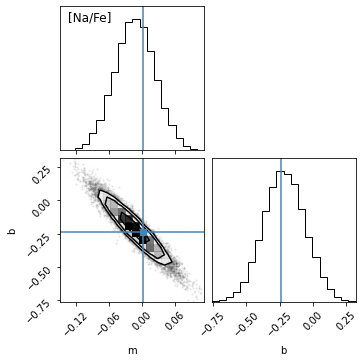

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### old [Al/Fe] ###


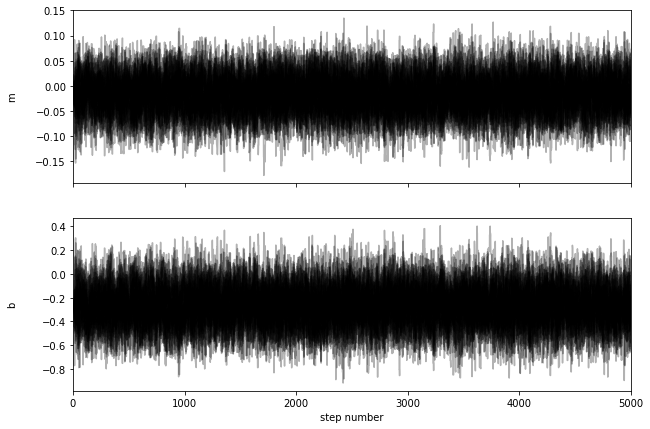

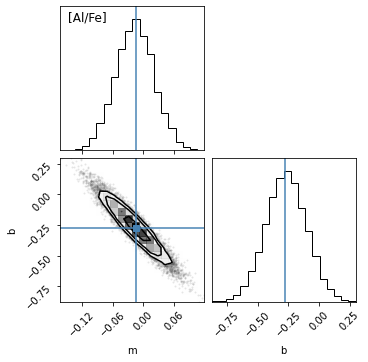

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### old [Cr/Fe] ###


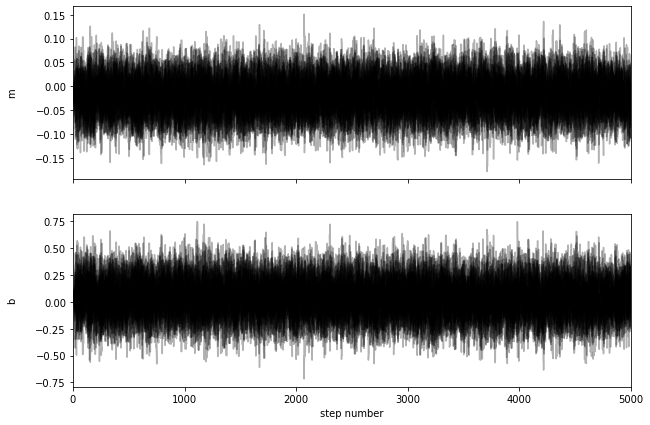

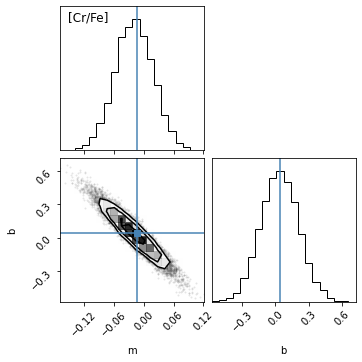

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### old [Co/Fe] ###


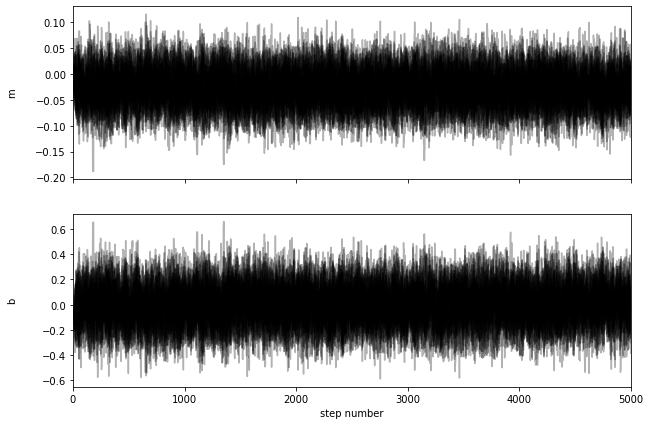

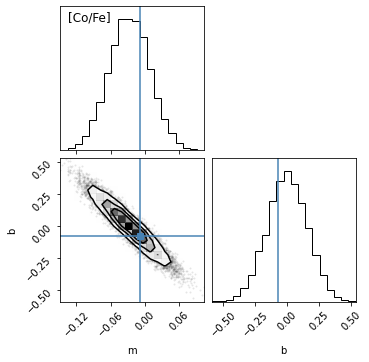

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### old [Ni/Fe] ###


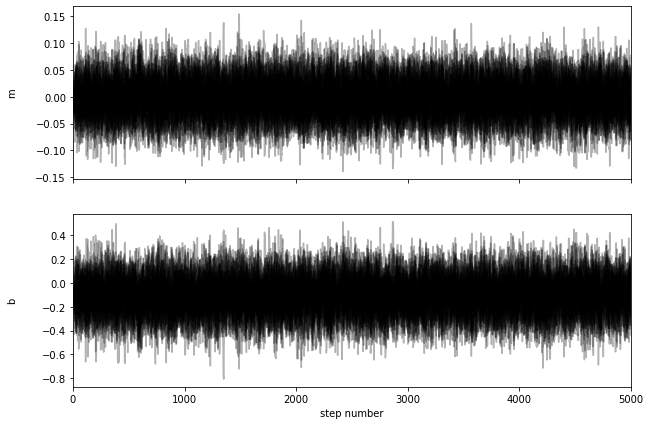

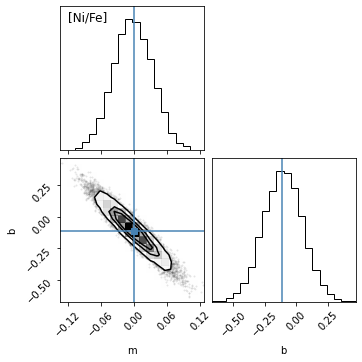

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [27]:
old_grads = []
old_grads_err = []
old_inter = []
old_inter_err = []
for i in tqdm_notebook(range(len(elems))):
    cln = np.where((np.isfinite(lmcold[elems[i]])==True)&(lmcold[elems[i]]!=-9999.0)&(lmcold['SNR']>100.))
    pos = [mle_ms[i],mle_bs[i]]+1e-2*np.random.randn(32,2)
#     nwlakers, ndim = pos.shape
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, 
                                    args=(radiusold[cln],lmcold[elems[i]][cln],
                                          0.5*np.ones(len(lmcold[cln])),lmcold[elems[i]+'_ERR'][cln]))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### old {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('initial_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_ms[i], mle_bs[i]])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('initial_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    old_grads.append(np.median(flat_samples[:,0]))
    old_grads_err.append(mad(flat_samples[:,0]))
    old_inter.append(np.median(flat_samples[:,1]))
    old_inter_err.append(mad(flat_samples[:,1]))

In [28]:
for i in range(len(grads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],old_grads[i],
                                                                         old_grads_err[i],old_inter[i],
                                                                         old_inter_err[i]))

FE_H slope: -0.0544 +/- 0.0233; inter: -0.5603 +/- 0.1025
O_FE slope: 0.0041 +/- 0.0238; inter: 0.0272 +/- 0.1042
MG_FE slope: -0.0028 +/- 0.0234; inter: 0.0573 +/- 0.1012
SI_FE slope: 0.0068 +/- 0.0237; inter: -0.0272 +/- 0.1031
CA_FE slope: -0.0012 +/- 0.0240; inter: 0.0700 +/- 0.1054
NA_FE slope: -0.0130 +/- 0.0247; inter: -0.2160 +/- 0.1054
AL_FE slope: -0.0169 +/- 0.0252; inter: -0.2671 +/- 0.1110
CR_FE slope: -0.0196 +/- 0.0260; inter: 0.0371 +/- 0.1155
CO_FE slope: -0.0270 +/- 0.0243; inter: 0.0016 +/- 0.1043
NI_FE slope: -0.0021 +/- 0.0242; inter: -0.1056 +/- 0.1045


In [31]:
idx

[array(0),
 array([], dtype=int64),
 array([], dtype=int64),
 array(1),
 array(2),
 array(3),
 array(4),
 array(6),
 array(9),
 array([], dtype=int64)]

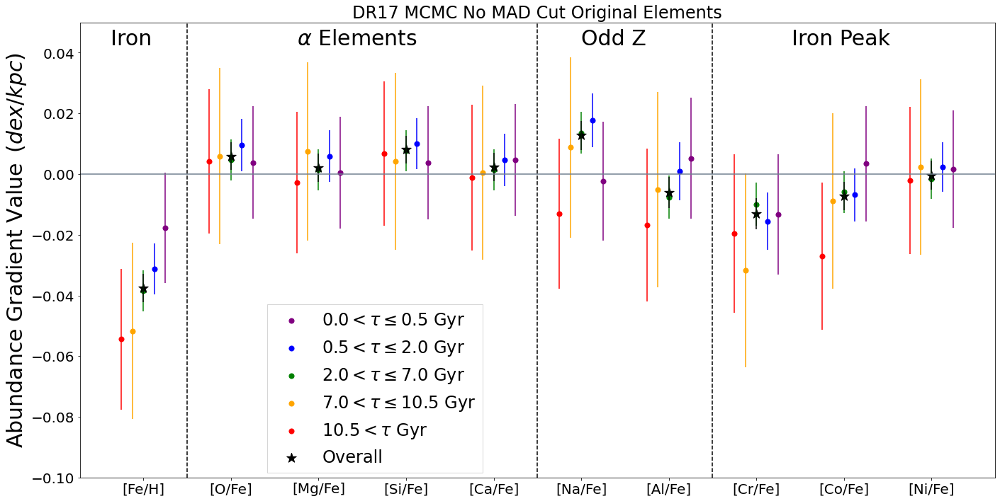

In [63]:
####################
### Summary plot ###
####################

# elements: Fe, C, N, O, Mg, Si, Ca, Al, Ni, Ce
    
idx = [np.squeeze(np.where(np.asarray(elems)=='FE_H')),np.squeeze(np.where(np.asarray(elems)=='O_FE')),
       np.squeeze(np.where(np.asarray(elems)=='MG_FE')),np.squeeze(np.where(np.asarray(elems)=='SI_FE')),
       np.squeeze(np.where(np.asarray(elems)=='CA_FE')),np.squeeze(np.where(np.asarray(elems)=='NA_FE')),
       np.squeeze(np.where(np.asarray(elems)=='AL_FE')),np.squeeze(np.where(np.asarray(elems)=='CR_FE')),
       np.squeeze(np.where(np.asarray(elems)=='CO_FE')),np.squeeze(np.where(np.asarray(elems)=='NI_FE'))]

good_young = []
good_yless = []
good_ymed = []
good_omed = []
good_old = []
good_over = []

err_young = []
err_yless = []
err_ymed = []
err_omed = []
err_old = []
err_over = []

for i in idx:
    good_young.append(young_grads[i])
    good_yless.append(yless_grads[i])
    good_ymed.append(ymed_grads[i])
    good_omed.append(omed_grads[i])
    good_old.append(old_grads[i])
    good_over.append(grads[i])
    
    err_young.append(young_grads_err[i])
    err_yless.append(yless_grads_err[i])
    err_ymed.append(ymed_grads_err[i])
    err_omed.append(omed_grads_err[i])
    err_old.append(old_grads_err[i])
    err_over.append(grads_err[i])

matplotlib.rcParams.update({'font.size': 20})
fig = plt.figure(figsize=[20,10])

plt.scatter(np.add(np.arange(10),0.25),good_young,c='purple',label='$0.0 < \\tau \leq 0.5$ Gyr',s=50)
plt.errorbar(np.add(np.arange(10),0.25),good_young,yerr=err_young,c='purple',ls='none')

plt.scatter(np.add(np.arange(10),0.125),good_yless,c='blue',label='$0.5 < \\tau \leq 2.0$ Gyr',s=50)
plt.errorbar(np.add(np.arange(10),0.125),good_yless,yerr=err_yless,c='blue',ls='none')

plt.scatter([0,1,2,3,4,5,6,7,8,9],good_ymed,c='green',label='$2.0 < \\tau \leq 7.0$ Gyr',s=50)
plt.errorbar([0,1,2,3,4,5,6,7,8,9],good_ymed,yerr=err_ymed,c='green',ls='none')

plt.scatter(np.subtract(np.arange(10),0.125),good_omed,c='orange',label='$7.0 < \\tau \leq 10.5$ Gyr',s=50)
plt.errorbar(np.subtract(np.arange(10),0.125),good_omed,yerr=err_omed,c='orange',ls='none')

plt.scatter(np.subtract(np.arange(10),0.25),good_old,c='red',label='$10.5 < \\tau $ Gyr',s=50)
plt.errorbar(np.subtract(np.arange(10),0.25),good_old,yerr=err_old,c='red',ls='none')

plt.scatter([0,1,2,3,4,5,6,7,8,9],good_over,marker='*',c='black',label='Overall',s=200)
plt.errorbar([0,1,2,3,4,5,6,7,8,9],good_over,yerr=err_over,c='black',ls='none')

xplotlab = ['[Fe/H]','[O/Fe]','[Mg/Fe]','[Si/Fe]','[Ca/Fe]','[Na/Fe]','[Al/Fe]','[Cr/Fe]','[Co/Fe]','[Ni/Fe]']

xplotpos = [0,1,2,3,4,5,6,7,8,9]#,10] 
plt.xticks(xplotpos,xplotlab)

plt.axvline(0.5,c='k',ls='--')
plt.axvline(4.5,c='k',ls='--')
plt.axvline(6.5,c='k',ls='--')
plt.axhline(0.0,c='slategrey',ls='-')
plt.ylabel('Abundance Gradient Value $\,(dex/kpc)$',fontsize=30)

# plt.gca().set_ylim(top=0.05)

plt.text(-0.375,0.0425,'Iron',fontsize=30)
plt.text(1.75,0.0425,'$\\alpha$ Elements',fontsize=30)
plt.text(5.0,0.0425,'Odd Z',fontsize=30)
plt.text(7.4,0.0425,'Iron Peak',fontsize=30)

# plt.ylim(bottom=-0.045)
# plt.ylim(-0.05,0.05)
plt.ylim(-0.1,0.05)

plt.legend(loc=(0.205,0.01),frameon=True,fancybox=False,fontsize='large')
plt.tight_layout()
plt.title(r'DR17 MCMC No MAD Cut Original Elements')
plt.savefig('dr17mcmcoriginalnocutsummary.png',bbox_inches='tight')
plt.show()

<font size='15'>
    <b>
        3 MAD Cut and Refit
    </b>
</font>

### [Fe/H] ###


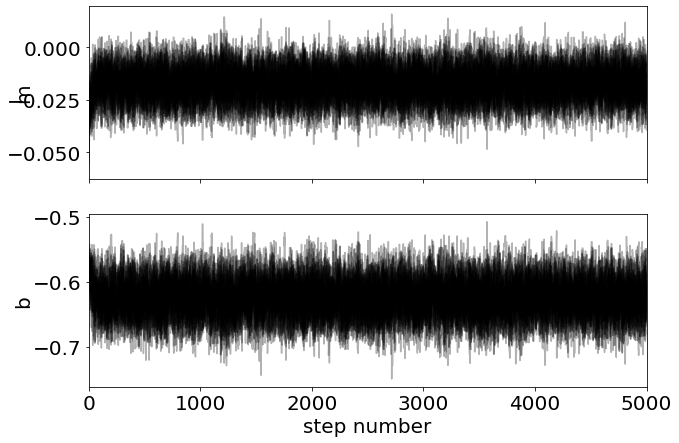

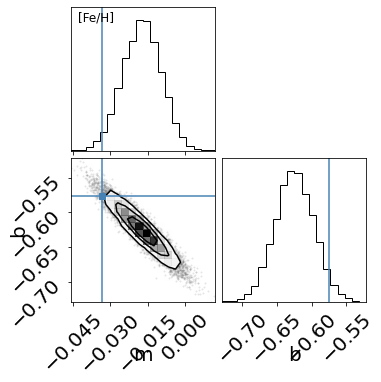

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [O/Fe] ###


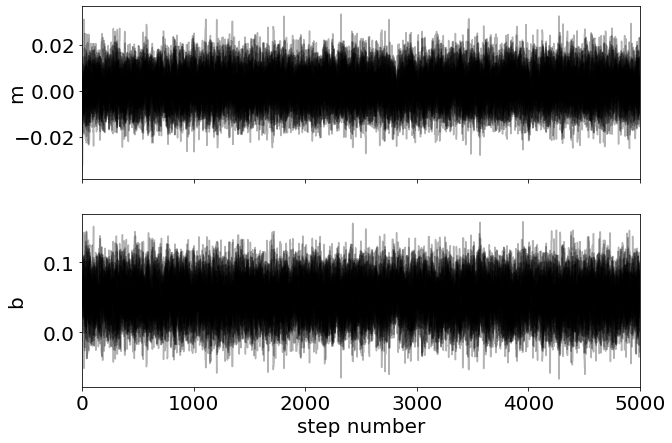

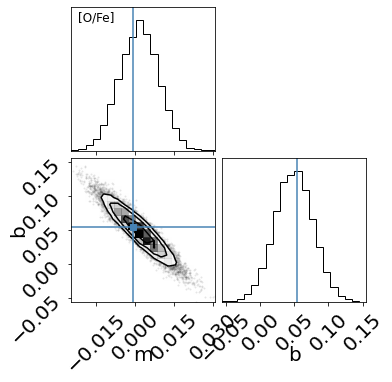

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Mg/Fe] ###


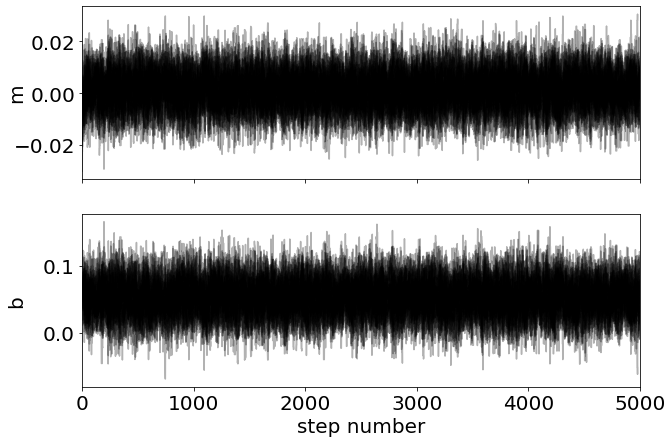

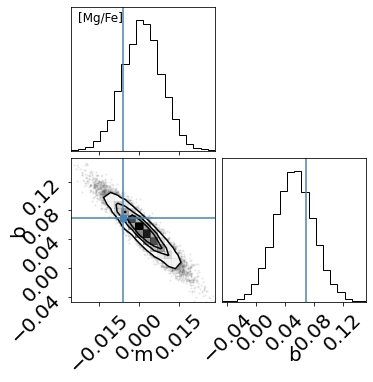

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Si/Fe] ###


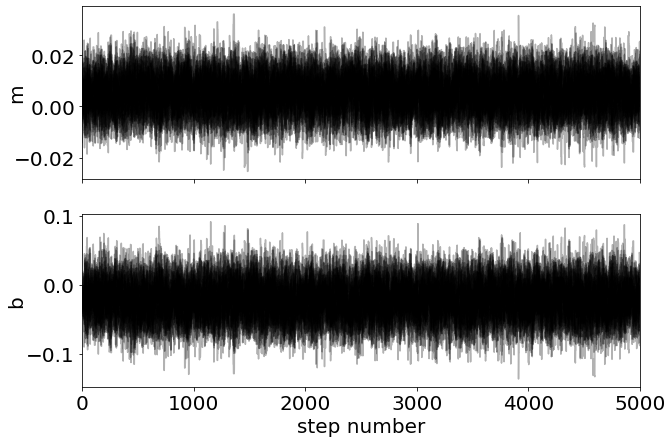

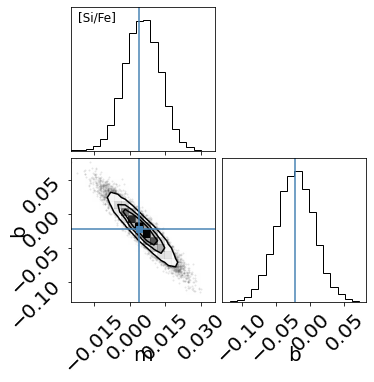

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ca/Fe] ###


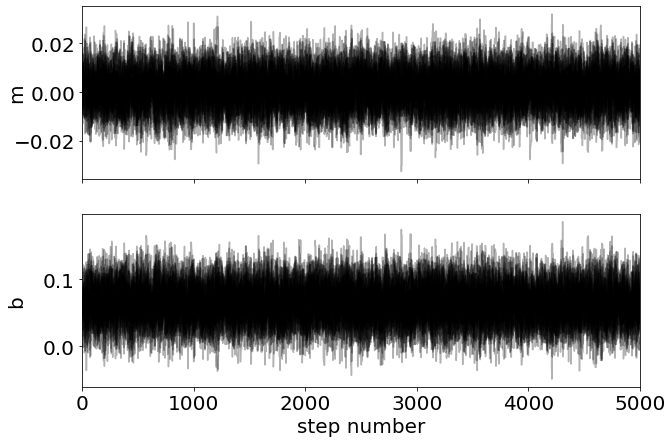

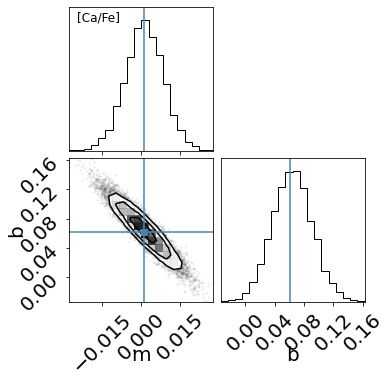

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Na/Fe] ###


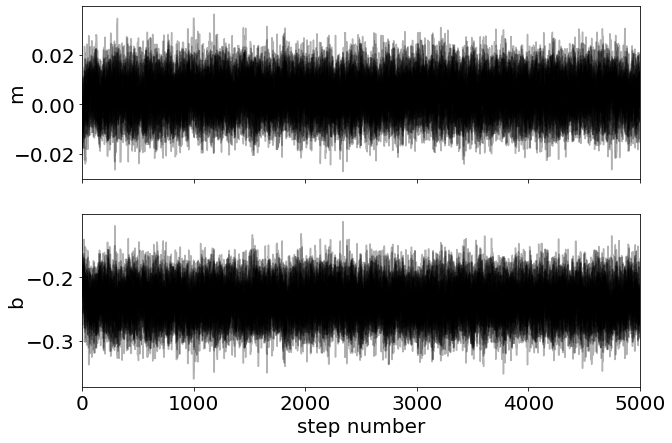

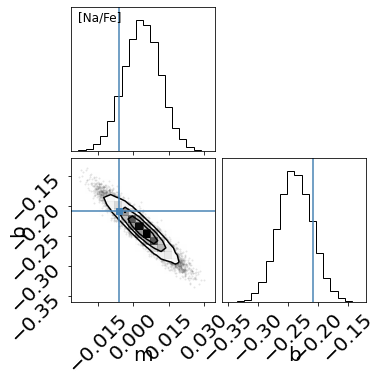

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Al/Fe] ###


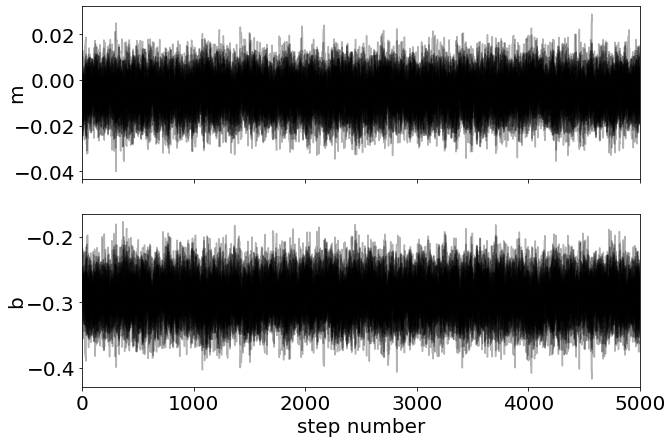

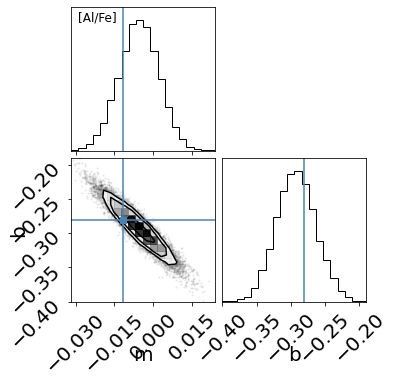

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Cr/Fe] ###


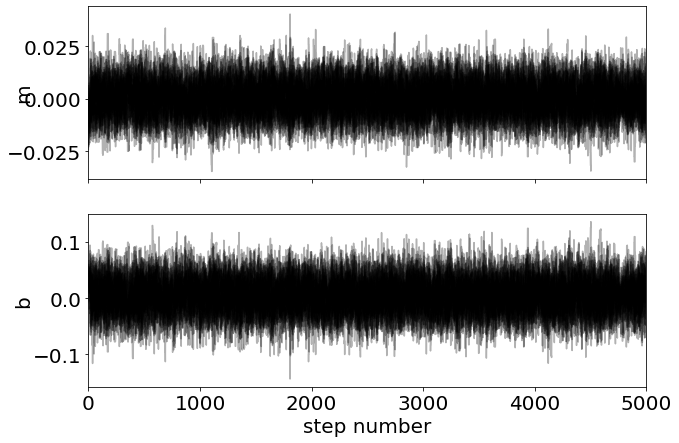

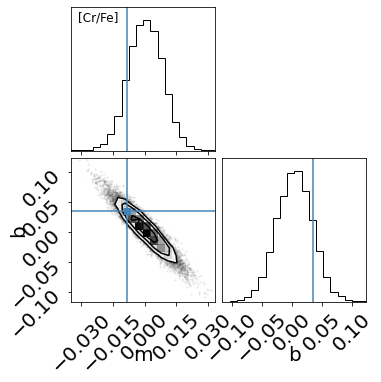

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Co/Fe] ###


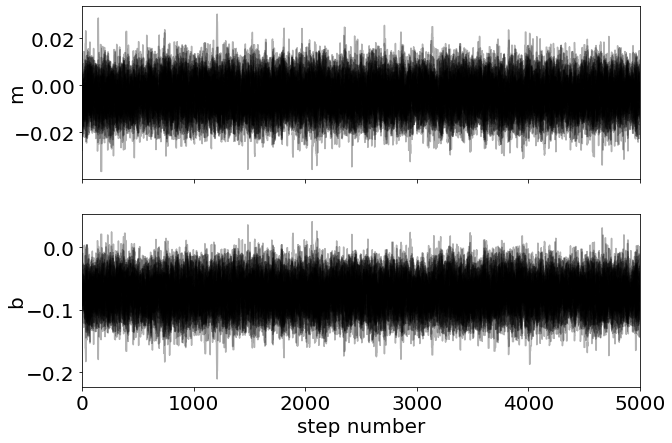

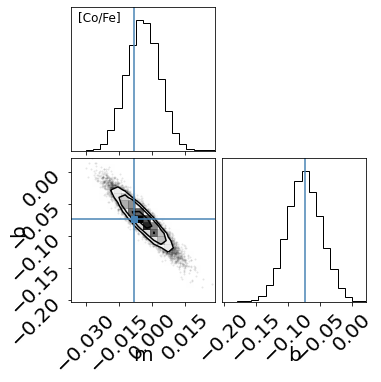

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ni/Fe] ###


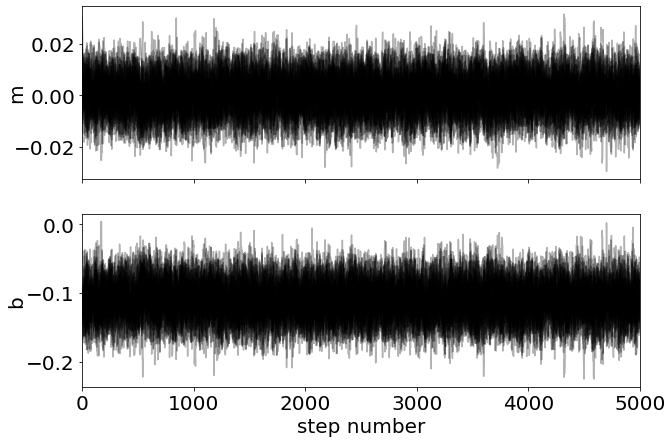

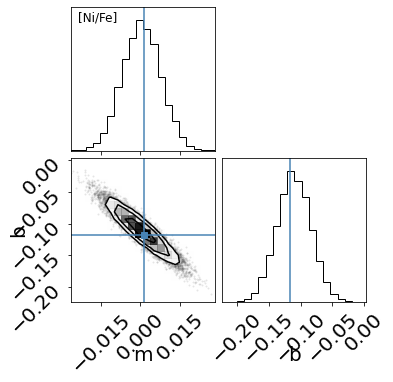

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [51]:
regrads = []
regrads_err = []
reinter = []
reinter_err = []

prune_fact = 3.
for i in tqdm_notebook(range(len(grads))):
    
    def initialmodl(x):
        return grads[i]*x+inter[i]
    
    cln = np.where((np.isfinite(lmc[elems[i]])==True)&(lmc[elems[i]]!=-9999.0)&(lmc['SNR']>100.))
    plugin = initialmodl(radius[cln])
    distmad = mad(plugin-lmc[elems[i]][cln]) 
    
    prune = np.where((lmc[elems[i]][cln]>-prune_fact*distmad+np.median(lmc[elems[i]][cln]))&
                     (lmc[elems[i]][cln]<prune_fact*distmad+np.median(lmc[elems[i]][cln]))) 
    
    prune_radius = radius[cln][prune]
    prune_abund = lmc[elems[i]][cln][prune]
    prune_abund_err = lmc[elems[i]+'_ERR'][cln][prune]
    
    bins = np.arange(np.floor(np.min(prune_radius)),np.ceil(np.max(prune_radius))+1.0,1.0)
    bin_stats, bin_edges, bin_number = binned_statistic(prune_radius,prune_abund,statistic='median',bins=bins)
    bin_stats_err, _, _ = binned_statistic(prune_radius,prune_abund,
                                           statistic=lambda y: np.median(np.abs(y-np.median(y))),bins=bins)
    
    center_rad_bins = np.arange(len(bin_stats))+0.5
    
    m_guess = (bin_stats[1]-bin_stats[0])/(center_rad_bins[1]-center_rad_bins[0])
    b_guess = bin_stats[0]
    
    nll = lambda *args: -lnL(*args)
    initial = np.array([m_guess, b_guess]) + 1e-2*np.random.randn(2)
    soln = minimize(nll, initial, args=(center_rad_bins,bin_stats,0.5*np.ones(len(bin_stats)),bin_stats_err))
    mle_m, mle_b = soln.x
    
    pos = [mle_m,mle_b]+1e-2*np.random.randn(32,2)
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, args=(prune_radius,prune_abund,
                                                                  0.5*np.ones(len(prune_radius)),
                                                                  prune_abund_err))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('refit_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_m, mle_b])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('refit_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    regrads.append(np.median(flat_samples[:,0]))
    regrads_err.append(mad(flat_samples[:,0]))
    reinter.append(np.median(flat_samples[:,1]))
    reinter_err.append(mad(flat_samples[:,1]))

In [52]:
for i in range(len(regrads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],regrads[i],regrads_err[i],
                                                                          reinter[i],reinter_err[i]))

FE_H slope: -0.0174 +/- 0.0052; inter: -0.6252 +/- 0.0188
O_FE slope: 0.0016 +/- 0.0051; inter: 0.0489 +/- 0.0190
MG_FE slope: 0.0013 +/- 0.0049; inter: 0.0529 +/- 0.0182
SI_FE slope: 0.0052 +/- 0.0050; inter: -0.0217 +/- 0.0182
CA_FE slope: 0.0014 +/- 0.0049; inter: 0.0640 +/- 0.0185
NA_FE slope: 0.0036 +/- 0.0052; inter: -0.2385 +/- 0.0192
AL_FE slope: -0.0055 +/- 0.0051; inter: -0.2928 +/- 0.0194
CR_FE slope: 0.0004 +/- 0.0055; inter: 0.0045 +/- 0.0203
CO_FE slope: -0.0042 +/- 0.0050; inter: -0.0744 +/- 0.0182
NI_FE slope: 0.0003 +/- 0.0049; inter: -0.1110 +/- 0.0181


# Young Gradients

### [Fe/H] ###


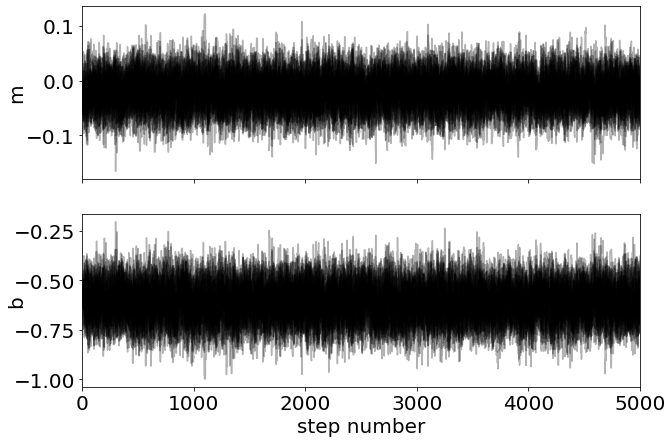

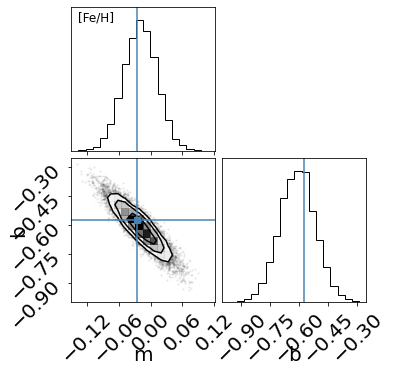

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [O/Fe] ###


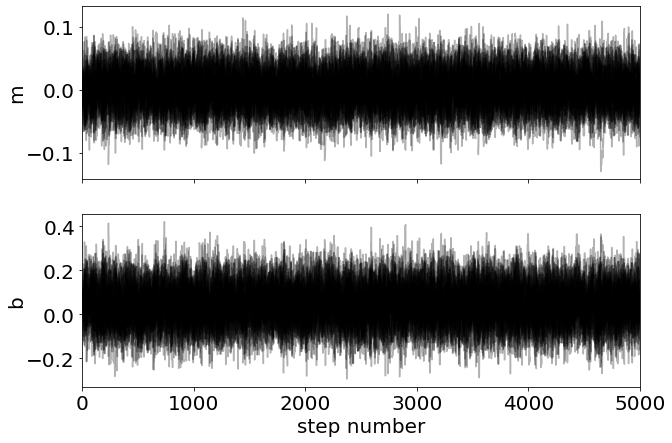

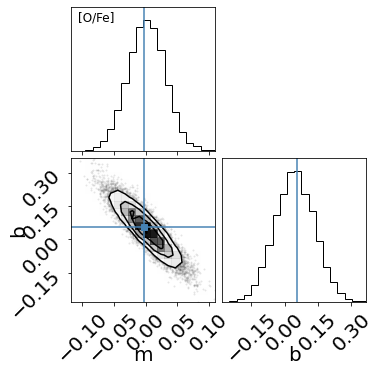

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Mg/Fe] ###


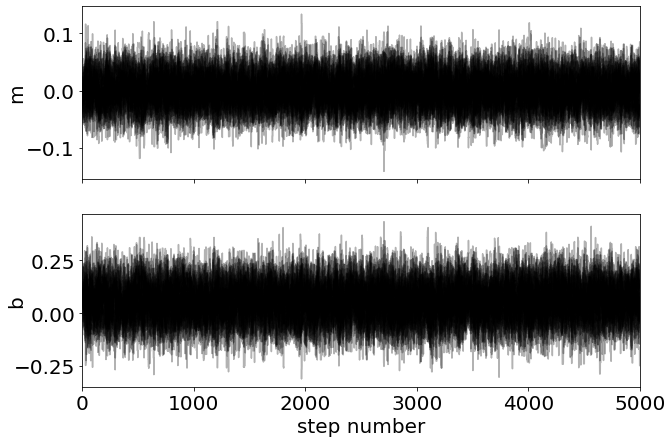

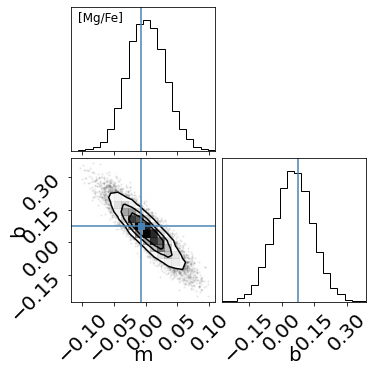

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Si/Fe] ###


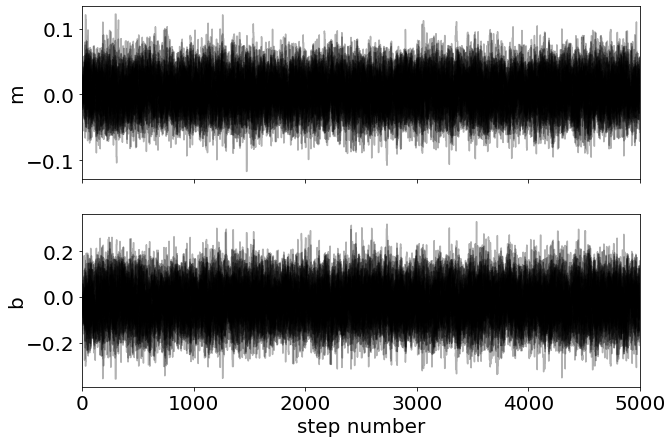

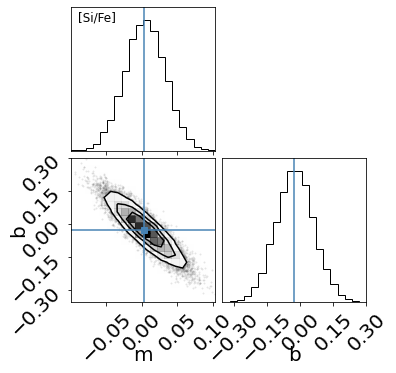

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ca/Fe] ###


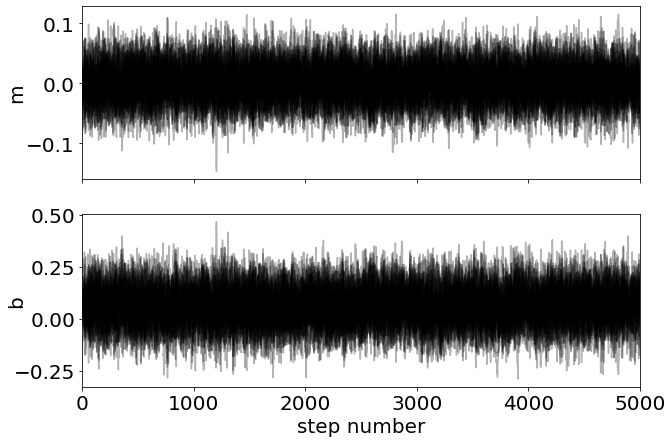

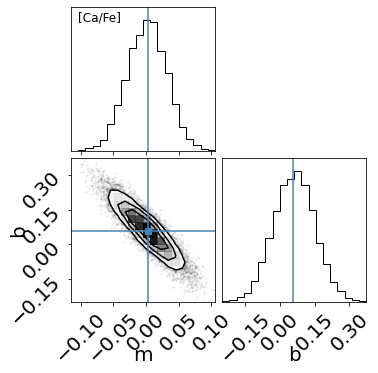

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Na/Fe] ###


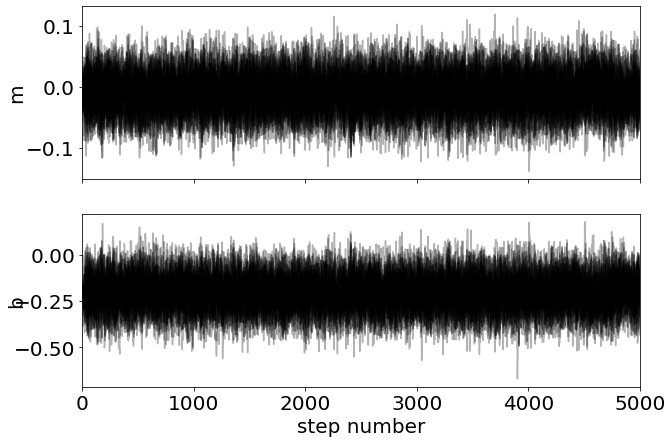

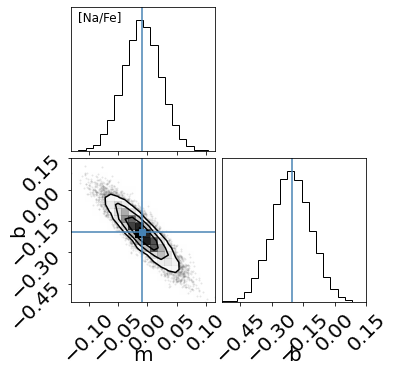

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Al/Fe] ###


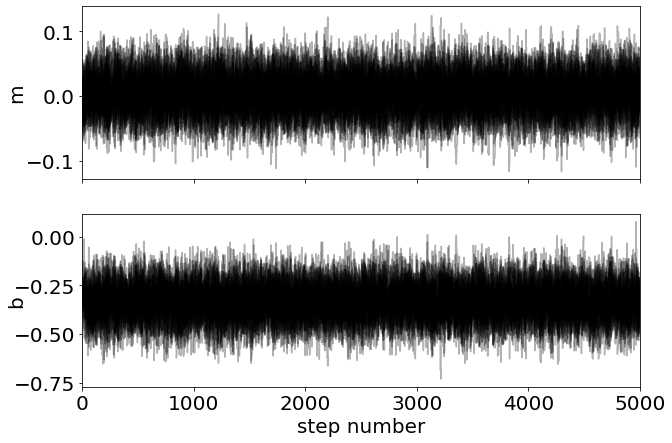

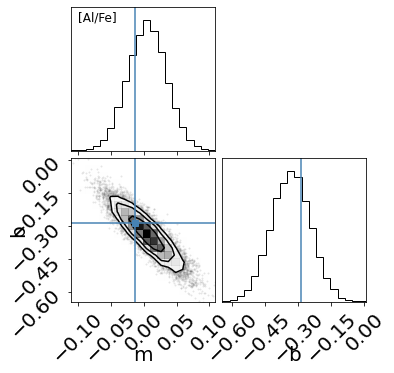

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Cr/Fe] ###


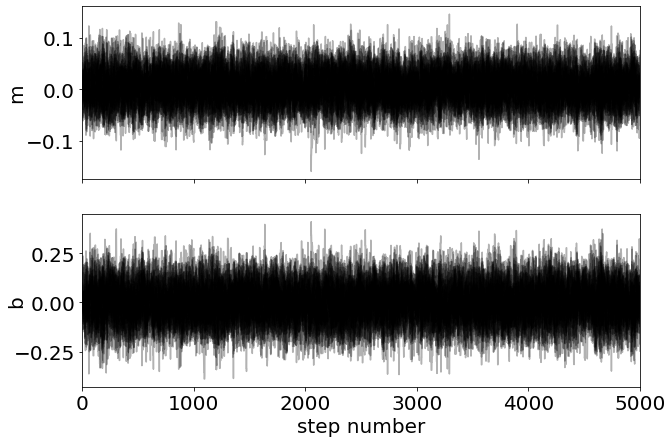

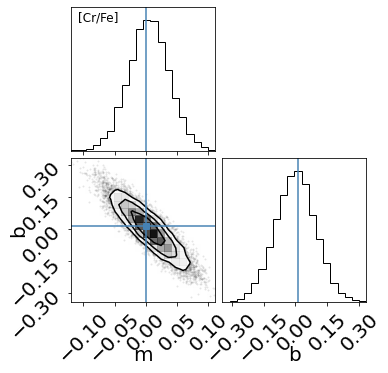

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Co/Fe] ###


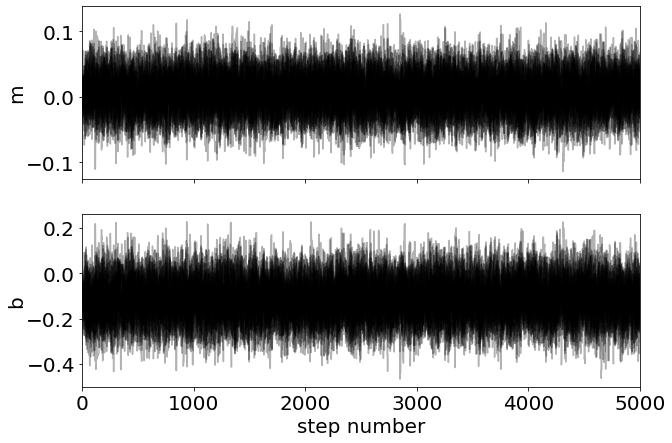

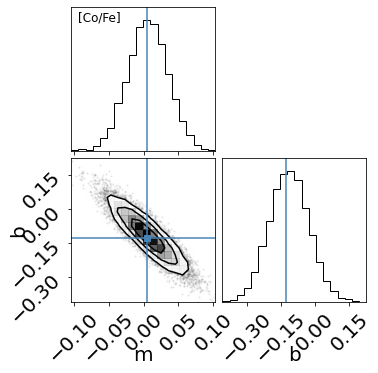

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ni/Fe] ###


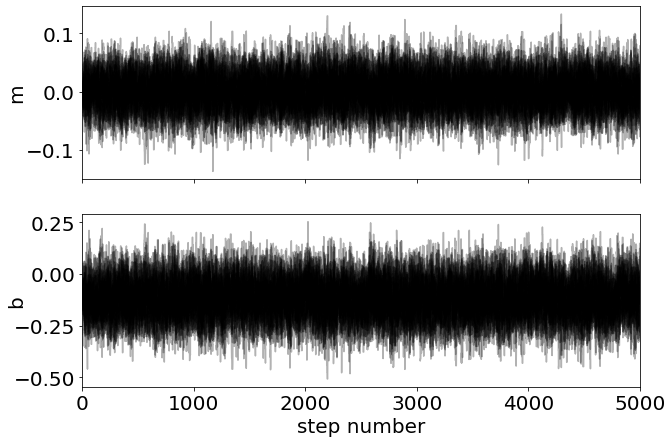

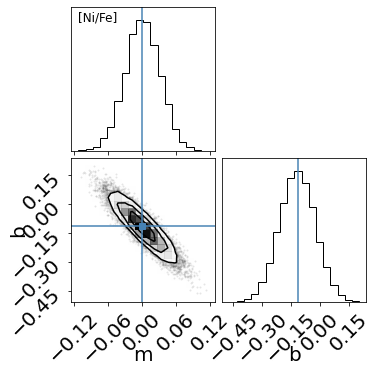

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [53]:
young_regrads = []
young_regrads_err = []
young_reinter = []
young_reinter_err = []

prune_fact = 3.
for i in tqdm_notebook(range(len(young_grads))):
    
    def initialmodl(x):
        return young_grads[i]*x+young_inter[i]
    
    cln = np.where((np.isfinite(lmcyoung[elems[i]])==True)&(lmcyoung[elems[i]]!=-9999.0)&(lmcyoung['SNR']>100.))
    plugin = initialmodl(radiusyoung[cln])
    distmad = mad(plugin-lmcyoung[elems[i]][cln]) 
    
    prune = np.where((lmcyoung[elems[i]][cln]>-prune_fact*distmad+np.median(lmcyoung[elems[i]][cln]))&
                     (lmcyoung[elems[i]][cln]<prune_fact*distmad+np.median(lmcyoung[elems[i]][cln]))) 
    
    prune_radius = radiusyoung[cln][prune]
    prune_abund = lmcyoung[elems[i]][cln][prune]
    prune_abund_err = lmcyoung[elems[i]+'_ERR'][cln][prune]
    
    bins = np.arange(np.floor(np.min(prune_radius)),np.ceil(np.max(prune_radius))+1.0,1.0)
    bin_stats, bin_edges, bin_number = binned_statistic(prune_radius,prune_abund,statistic='median',bins=bins)
    bin_stats_err, _, _ = binned_statistic(prune_radius,prune_abund,
                                           statistic=lambda y: np.median(np.abs(y-np.median(y))),bins=bins)
    
    center_rad_bins = np.arange(len(bin_stats))+0.5
    
    m_guess = (bin_stats[1]-bin_stats[0])/(center_rad_bins[1]-center_rad_bins[0])
    b_guess = bin_stats[0]
    
    nll = lambda *args: -lnL(*args)
    initial = np.array([m_guess, b_guess]) + 1e-2*np.random.randn(2)
    soln = minimize(nll, initial, args=(center_rad_bins,bin_stats,0.5*np.ones(len(bin_stats)),bin_stats_err))
    mle_m, mle_b = soln.x
    
    pos = [mle_m,mle_b]+1e-2*np.random.randn(32,2)
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, args=(prune_radius,prune_abund,
                                                                  0.5*np.ones(len(prune_radius)),
                                                                  prune_abund_err))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('refit_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_m, mle_b])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('refit_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    young_regrads.append(np.median(flat_samples[:,0]))
    young_regrads_err.append(mad(flat_samples[:,0]))
    young_reinter.append(np.median(flat_samples[:,1]))
    young_reinter_err.append(mad(flat_samples[:,1]))

In [54]:
for i in range(len(regrads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],young_regrads[i],
                                                                         young_regrads_err[i],young_reinter[i],
                                                                         young_reinter_err[i]))

FE_H slope: -0.0198 +/- 0.0209; inter: -0.6109 +/- 0.0619
O_FE slope: 0.0011 +/- 0.0199; inter: 0.0443 +/- 0.0608
MG_FE slope: 0.0006 +/- 0.0203; inter: 0.0542 +/- 0.0586
SI_FE slope: 0.0044 +/- 0.0191; inter: -0.0245 +/- 0.0574
CA_FE slope: 0.0015 +/- 0.0204; inter: 0.0622 +/- 0.0601
NA_FE slope: -0.0094 +/- 0.0211; inter: -0.2074 +/- 0.0620
AL_FE slope: 0.0047 +/- 0.0200; inter: -0.3354 +/- 0.0607
CR_FE slope: 0.0048 +/- 0.0215; inter: -0.0004 +/- 0.0632
CO_FE slope: 0.0060 +/- 0.0193; inter: -0.1154 +/- 0.0584
NI_FE slope: 0.0014 +/- 0.0205; inter: -0.1179 +/- 0.0636


# Yless Gradients

### [Fe/H] ###


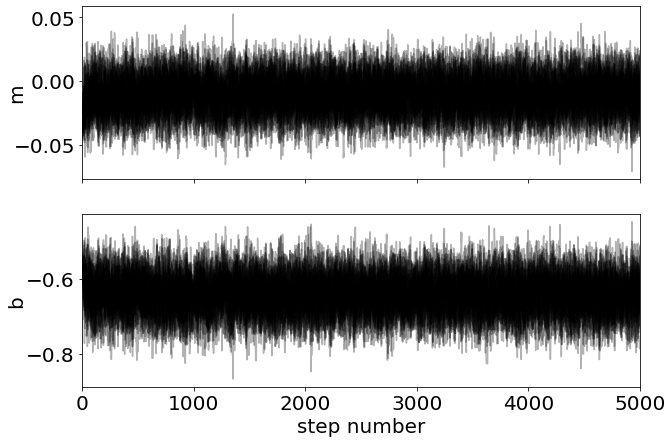

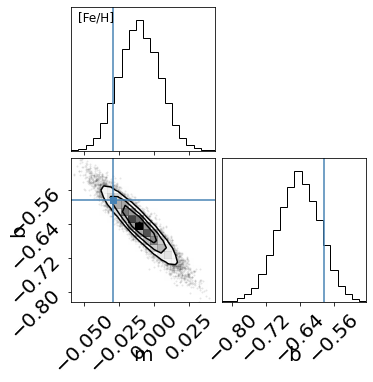

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [O/Fe] ###


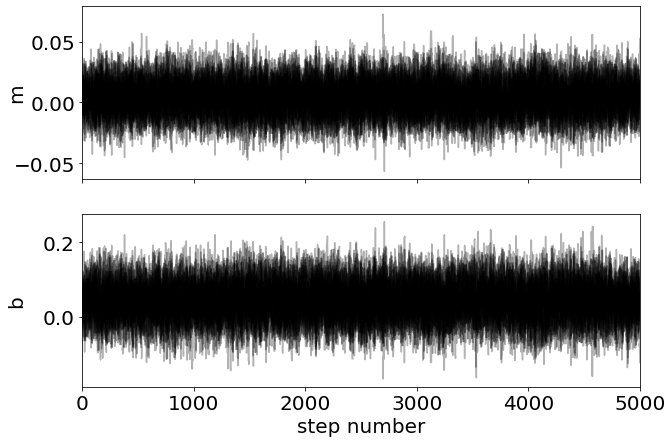

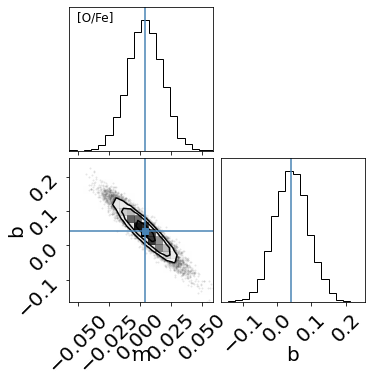

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Mg/Fe] ###


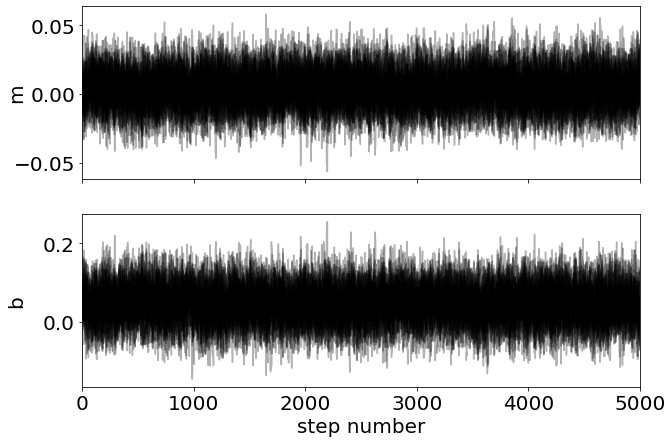

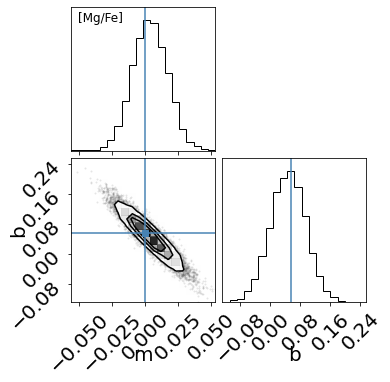

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Si/Fe] ###


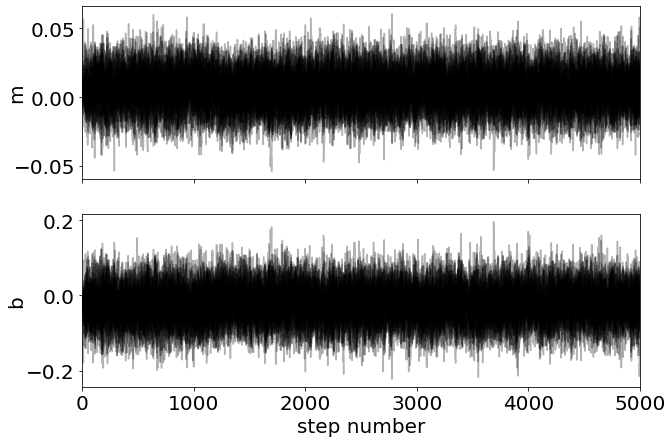

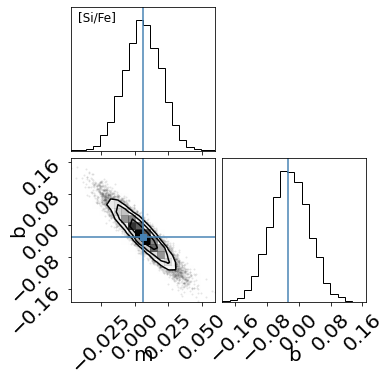

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ca/Fe] ###


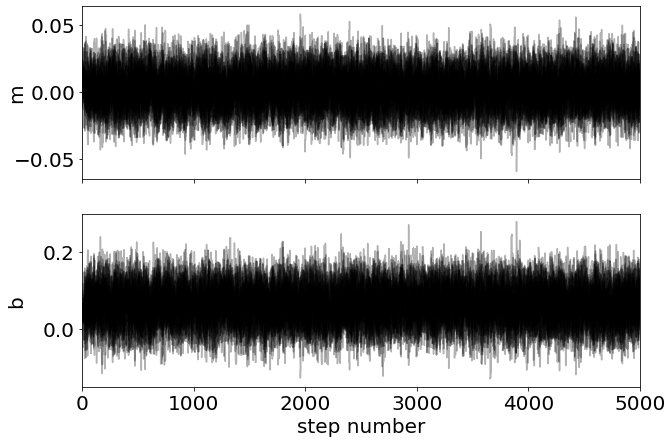

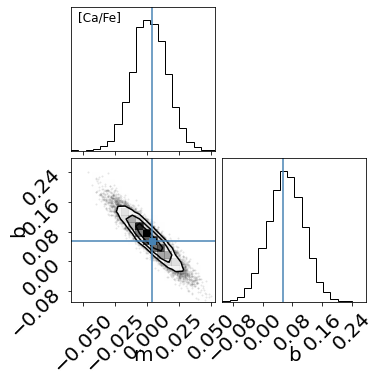

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Na/Fe] ###


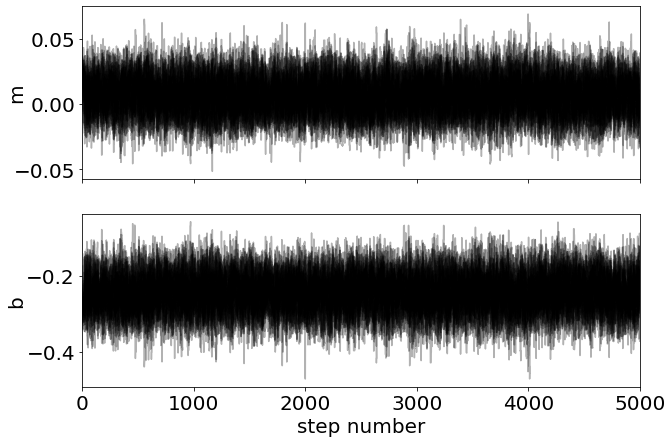

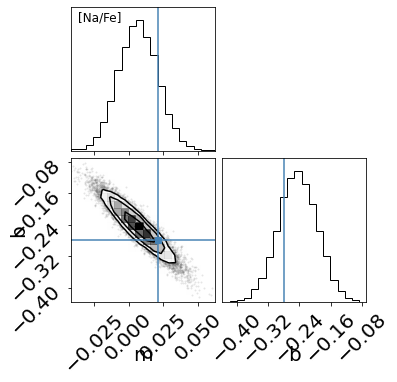

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Al/Fe] ###


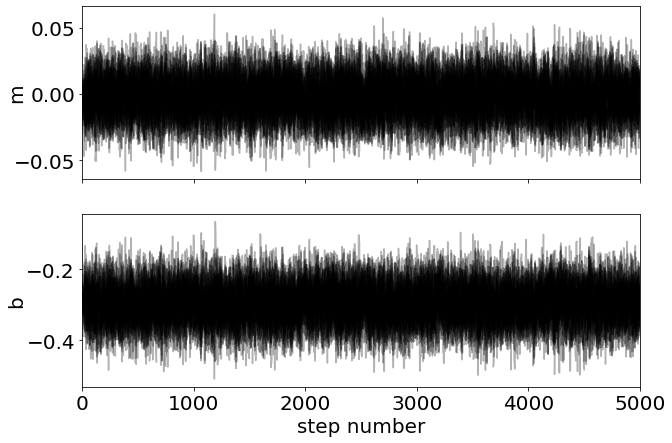

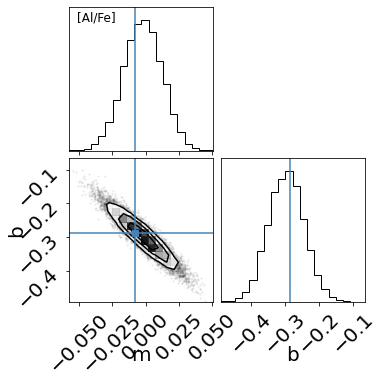

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Cr/Fe] ###


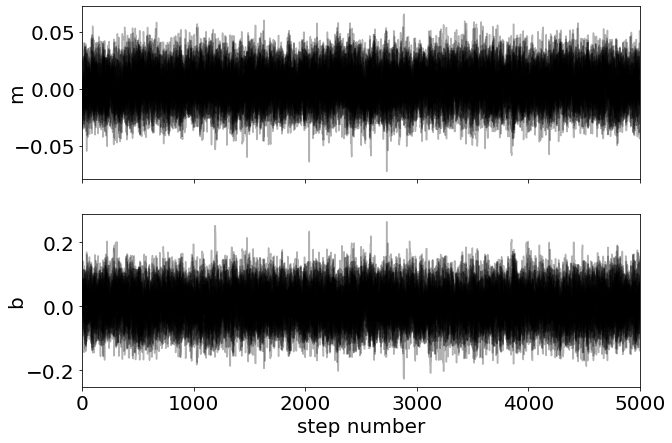

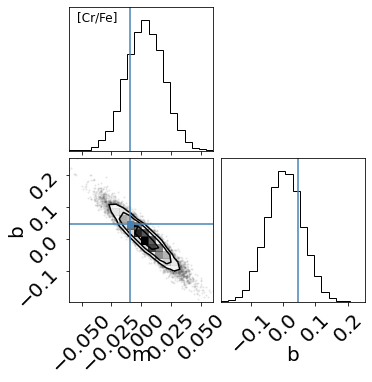

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Co/Fe] ###


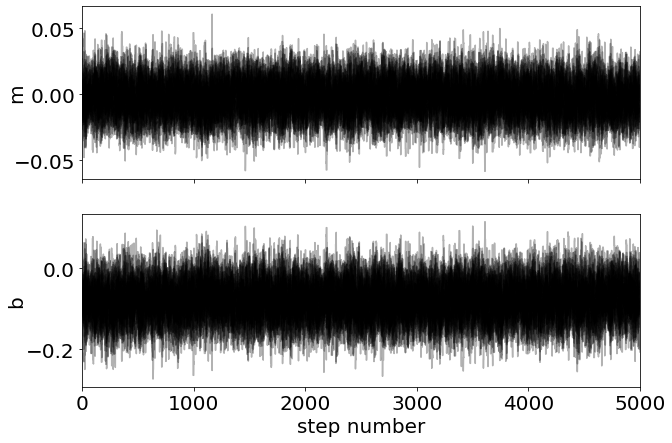

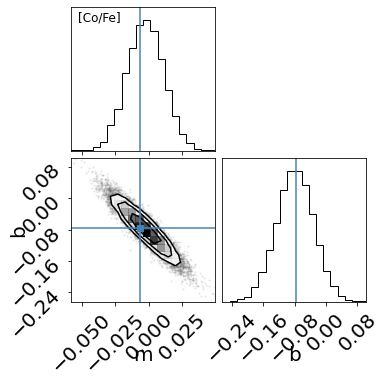

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ni/Fe] ###


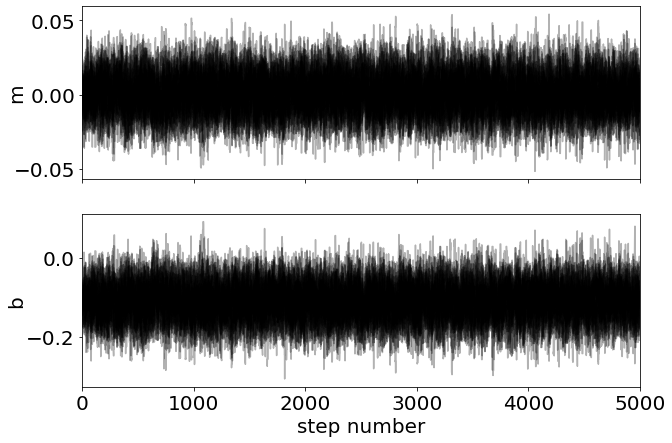

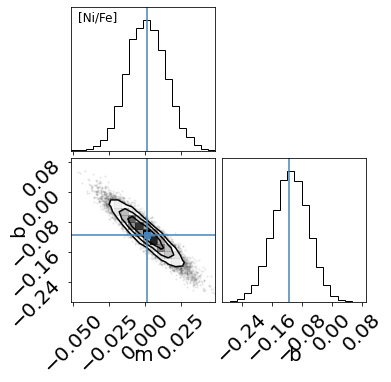

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [55]:
yless_regrads = []
yless_regrads_err = []
yless_reinter = []
yless_reinter_err = []

prune_fact = 3.
for i in tqdm_notebook(range(len(yless_grads))):
    
    def initialmodl(x):
        return yless_grads[i]*x+yless_inter[i]
    
    cln = np.where((np.isfinite(lmcyless[elems[i]])==True)&(lmcyless[elems[i]]!=-9999.0)&(lmcyless['SNR']>100.))
    plugin = initialmodl(radiusyless[cln])
    distmad = mad(plugin-lmcyless[elems[i]][cln]) 
    
    prune = np.where((lmcyless[elems[i]][cln]>-prune_fact*distmad+np.median(lmcyless[elems[i]][cln]))&
                     (lmcyless[elems[i]][cln]<prune_fact*distmad+np.median(lmcyless[elems[i]][cln]))) 
    
    prune_radius = radiusyless[cln][prune]
    prune_abund = lmcyless[elems[i]][cln][prune]
    prune_abund_err = lmcyless[elems[i]+'_ERR'][cln][prune]
    
    bins = np.arange(np.floor(np.min(prune_radius)),np.ceil(np.max(prune_radius))+1.0,1.0)
    bin_stats, bin_edges, bin_number = binned_statistic(prune_radius,prune_abund,statistic='median',bins=bins)
    bin_stats_err, _, _ = binned_statistic(prune_radius,prune_abund,
                                           statistic=lambda y: np.median(np.abs(y-np.median(y))),bins=bins)
    
    center_rad_bins = np.arange(len(bin_stats))+0.5
    
    m_guess = (bin_stats[1]-bin_stats[0])/(center_rad_bins[1]-center_rad_bins[0])
    b_guess = bin_stats[0]
    
    nll = lambda *args: -lnL(*args)
    initial = np.array([m_guess, b_guess]) + 1e-2*np.random.randn(2)
    soln = minimize(nll, initial, args=(center_rad_bins,bin_stats,0.5*np.ones(len(bin_stats)),bin_stats_err))
    mle_m, mle_b = soln.x
    
    pos = [mle_m,mle_b]+1e-2*np.random.randn(32,2)
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, args=(prune_radius,prune_abund,
                                                                  0.5*np.ones(len(prune_radius)),
                                                                  prune_abund_err))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('refit_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_m, mle_b])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('refit_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    yless_regrads.append(np.median(flat_samples[:,0]))
    yless_regrads_err.append(mad(flat_samples[:,0]))
    yless_reinter.append(np.median(flat_samples[:,1]))
    yless_reinter_err.append(mad(flat_samples[:,1]))

In [56]:
for i in range(len(regrads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],yless_regrads[i],
                                                                         yless_regrads_err[i],yless_reinter[i],
                                                                         yless_reinter_err[i]))

FE_H slope: -0.0108 +/- 0.0098; inter: -0.6424 +/- 0.0340
O_FE slope: 0.0039 +/- 0.0093; inter: 0.0425 +/- 0.0334
MG_FE slope: 0.0035 +/- 0.0090; inter: 0.0466 +/- 0.0318
SI_FE slope: 0.0057 +/- 0.0091; inter: -0.0228 +/- 0.0323
CA_FE slope: 0.0020 +/- 0.0091; inter: 0.0626 +/- 0.0318
NA_FE slope: 0.0067 +/- 0.0096; inter: -0.2449 +/- 0.0334
AL_FE slope: -0.0022 +/- 0.0099; inter: -0.2965 +/- 0.0360
CR_FE slope: 0.0029 +/- 0.0107; inter: 0.0038 +/- 0.0380
CO_FE slope: -0.0026 +/- 0.0093; inter: -0.0788 +/- 0.0322
NI_FE slope: 0.0005 +/- 0.0092; inter: -0.1100 +/- 0.0320


# Ymed Gradients

### [Fe/H] ###


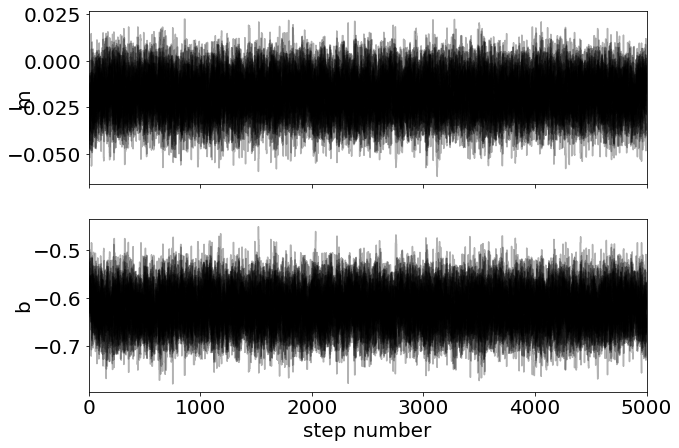

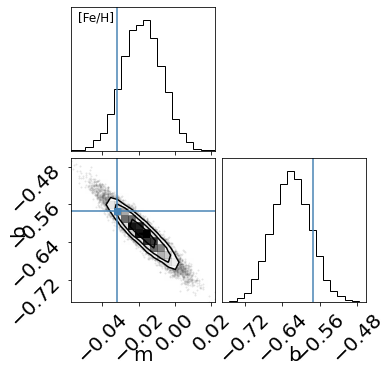

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [O/Fe] ###


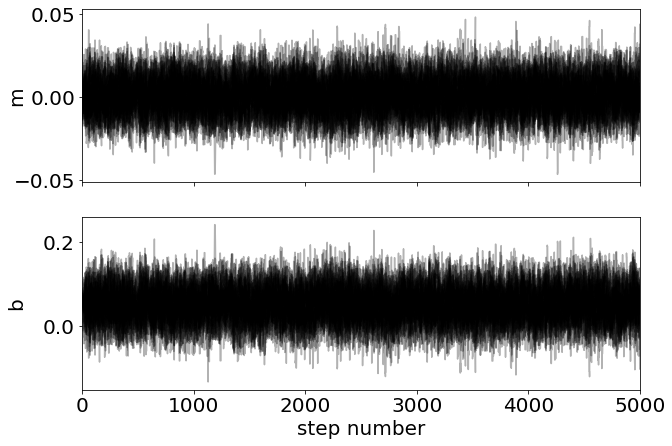

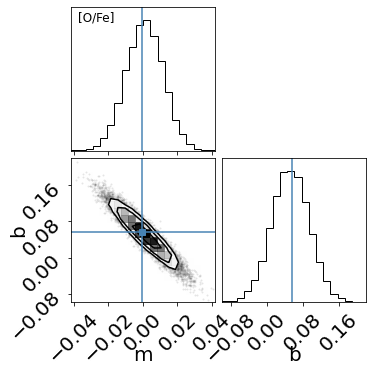

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Mg/Fe] ###


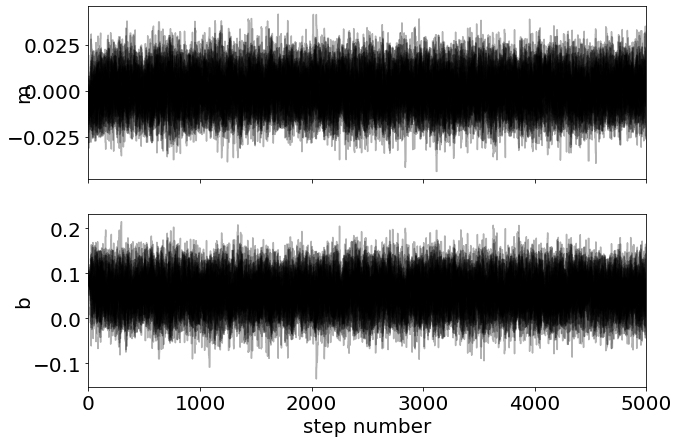

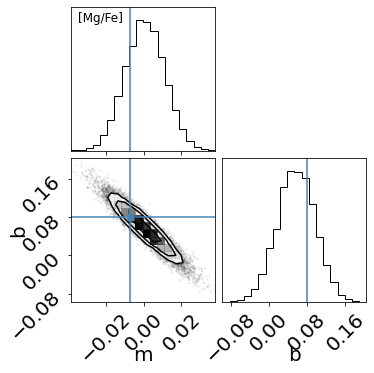

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Si/Fe] ###


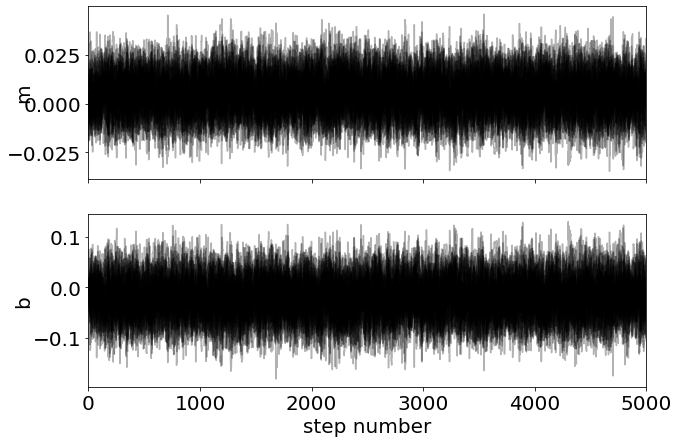

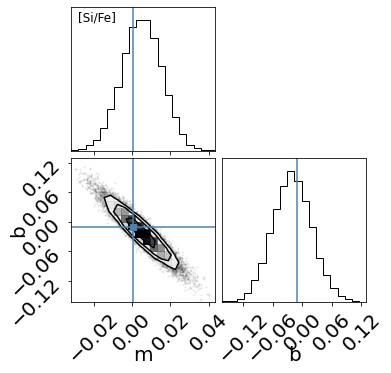

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ca/Fe] ###


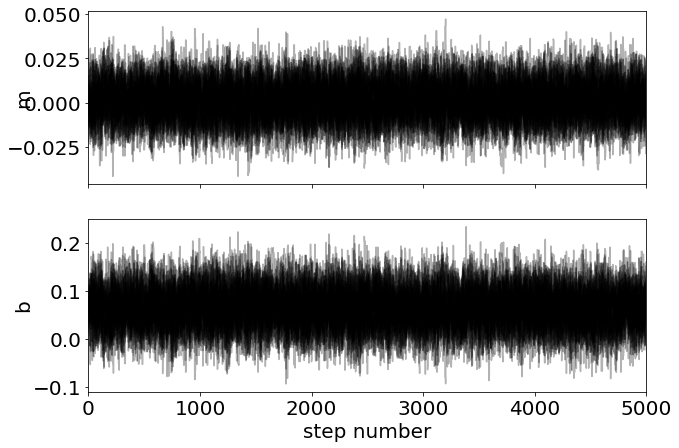

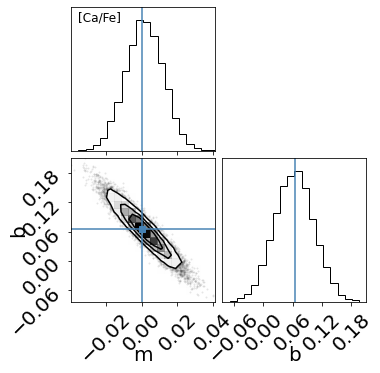

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Na/Fe] ###


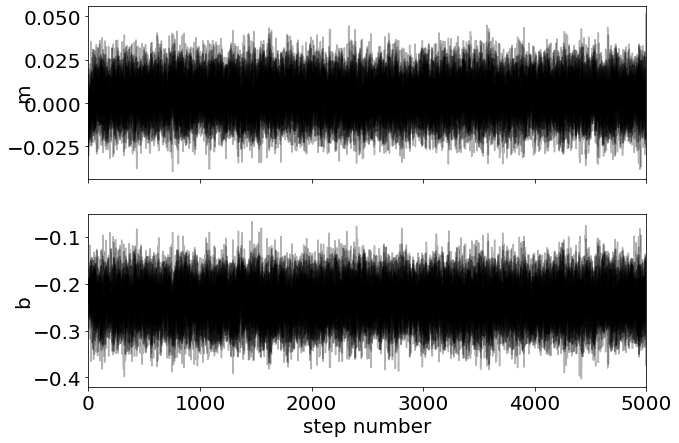

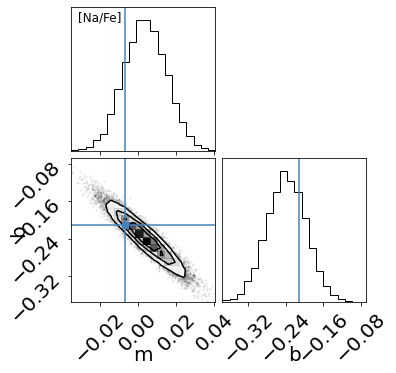

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Al/Fe] ###


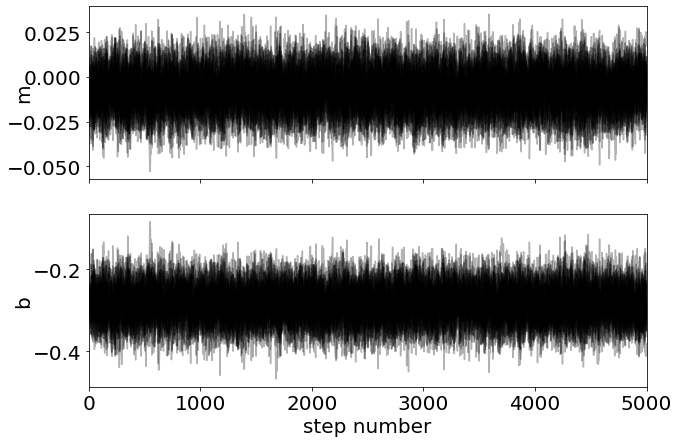

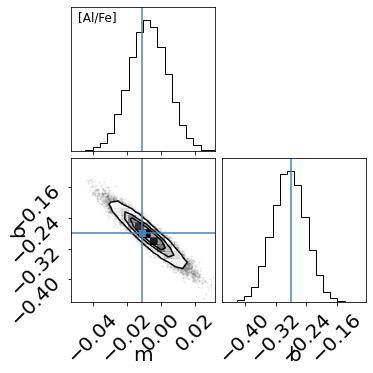

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Cr/Fe] ###


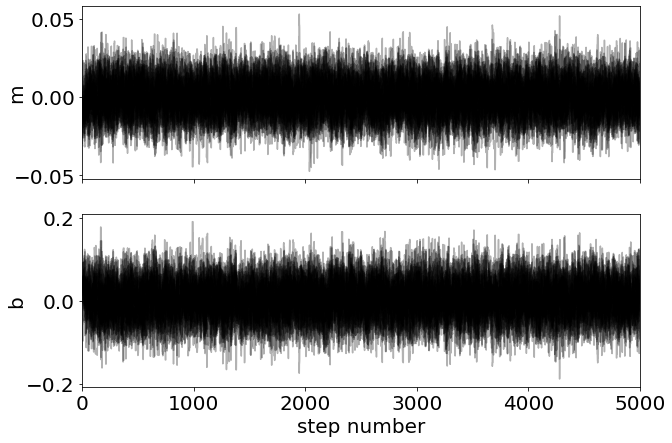

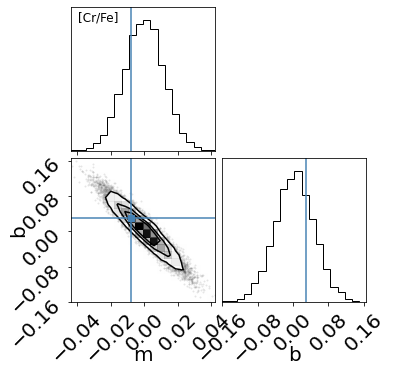

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Co/Fe] ###


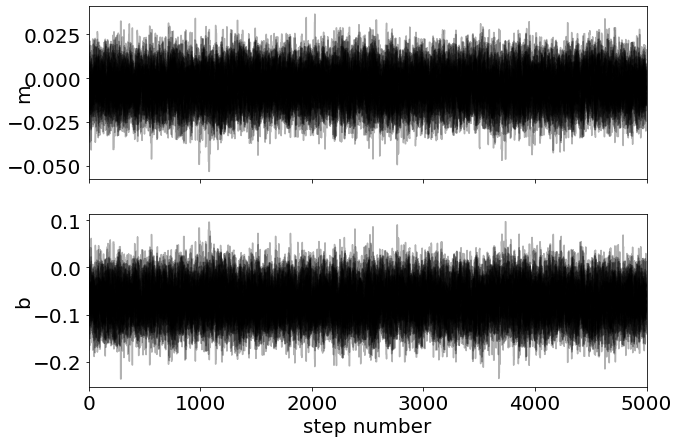

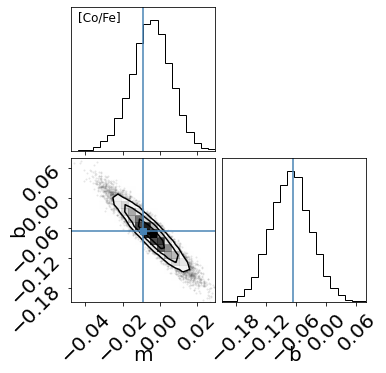

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ni/Fe] ###


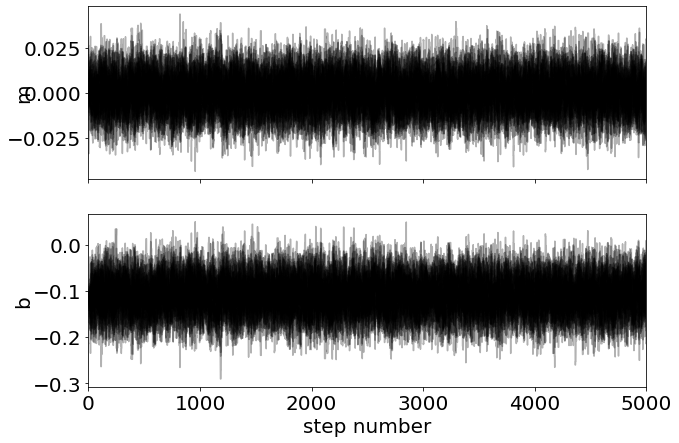

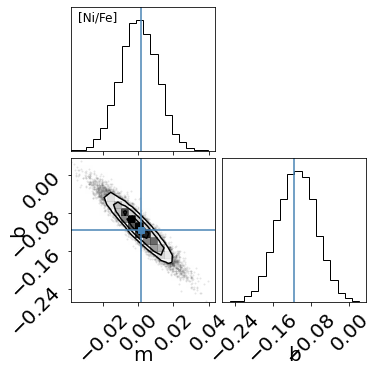

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [57]:
ymed_regrads = []
ymed_regrads_err = []
ymed_reinter = []
ymed_reinter_err = []

prune_fact = 3.
for i in tqdm_notebook(range(len(ymed_grads))):
    
    def initialmodl(x):
        return ymed_grads[i]*x+ymed_inter[i]
    
    cln = np.where((np.isfinite(lmcymed[elems[i]])==True)&(lmcymed[elems[i]]!=-9999.0)&(lmcymed['SNR']>100.))
    plugin = initialmodl(radiusymed[cln])
    distmad = mad(plugin-lmcymed[elems[i]][cln]) 
    
    prune = np.where((lmcymed[elems[i]][cln]>-prune_fact*distmad+np.median(lmcymed[elems[i]][cln]))&
                     (lmcymed[elems[i]][cln]<prune_fact*distmad+np.median(lmcymed[elems[i]][cln]))) 
    
    prune_radius = radiusymed[cln][prune]
    prune_abund = lmcymed[elems[i]][cln][prune]
    prune_abund_err = lmcymed[elems[i]+'_ERR'][cln][prune]
    
    bins = np.arange(np.floor(np.min(prune_radius)),np.ceil(np.max(prune_radius))+1.0,1.0)
    bin_stats, bin_edges, bin_number = binned_statistic(prune_radius,prune_abund,statistic='median',bins=bins)
    bin_stats_err, _, _ = binned_statistic(prune_radius,prune_abund,
                                           statistic=lambda y: np.median(np.abs(y-np.median(y))),bins=bins)
    
    center_rad_bins = np.arange(len(bin_stats))+0.5
    
    m_guess = (bin_stats[1]-bin_stats[0])/(center_rad_bins[1]-center_rad_bins[0])
    b_guess = bin_stats[0]
    
    nll = lambda *args: -lnL(*args)
    initial = np.array([m_guess, b_guess]) + 1e-2*np.random.randn(2)
    soln = minimize(nll, initial, args=(center_rad_bins,bin_stats,0.5*np.ones(len(bin_stats)),bin_stats_err))
    mle_m, mle_b = soln.x
    
    pos = [mle_m,mle_b]+1e-2*np.random.randn(32,2)
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, args=(prune_radius,prune_abund,
                                                                  0.5*np.ones(len(prune_radius)),
                                                                  prune_abund_err))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('refit_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_m, mle_b])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('refit_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    ymed_regrads.append(np.median(flat_samples[:,0]))
    ymed_regrads_err.append(mad(flat_samples[:,0]))
    ymed_reinter.append(np.median(flat_samples[:,1]))
    ymed_reinter_err.append(mad(flat_samples[:,1]))

In [58]:
for i in range(len(regrads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],ymed_regrads[i],
                                                                         ymed_regrads_err[i],ymed_reinter[i],
                                                                         ymed_reinter_err[i]))

FE_H slope: -0.0178 +/- 0.0074; inter: -0.6206 +/- 0.0276
O_FE slope: 0.0009 +/- 0.0073; inter: 0.0524 +/- 0.0280
MG_FE slope: 0.0006 +/- 0.0071; inter: 0.0570 +/- 0.0270
SI_FE slope: 0.0051 +/- 0.0070; inter: -0.0216 +/- 0.0266
CA_FE slope: 0.0014 +/- 0.0071; inter: 0.0630 +/- 0.0272
NA_FE slope: 0.0036 +/- 0.0076; inter: -0.2388 +/- 0.0286
AL_FE slope: -0.0074 +/- 0.0075; inter: -0.2839 +/- 0.0290
CR_FE slope: -0.0002 +/- 0.0078; inter: 0.0034 +/- 0.0296
CO_FE slope: -0.0045 +/- 0.0070; inter: -0.0708 +/- 0.0269
NI_FE slope: 0.0000 +/- 0.0072; inter: -0.1093 +/- 0.0271


# Omed Gradients

### [Fe/H] ###


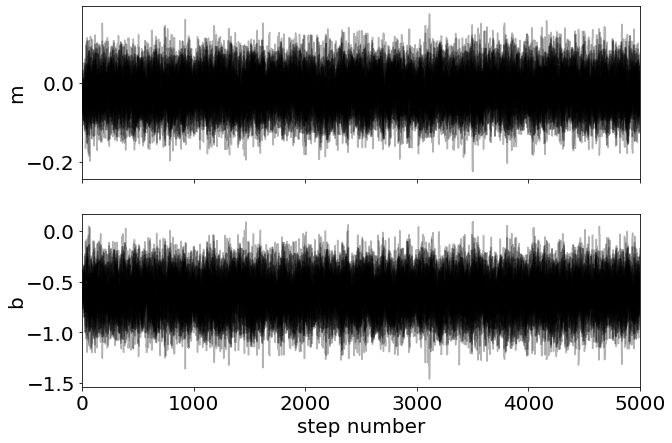

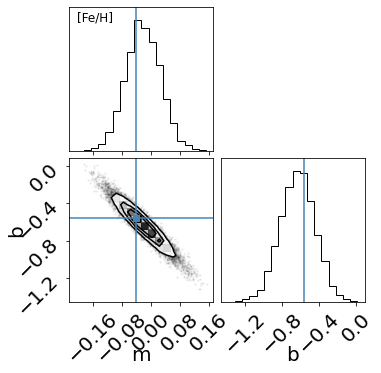

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [O/Fe] ###


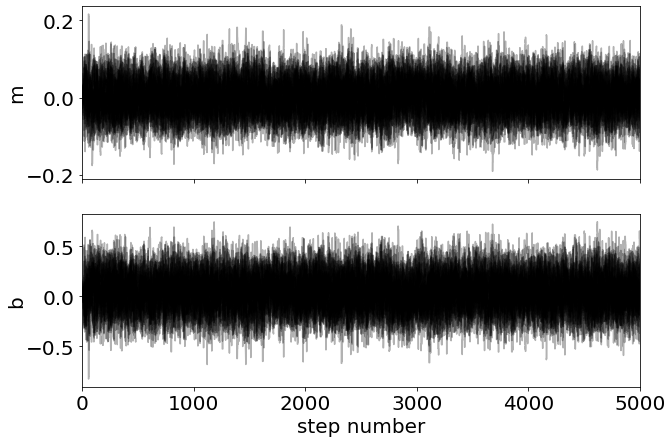

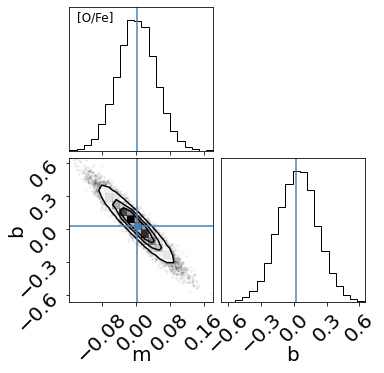

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Mg/Fe] ###


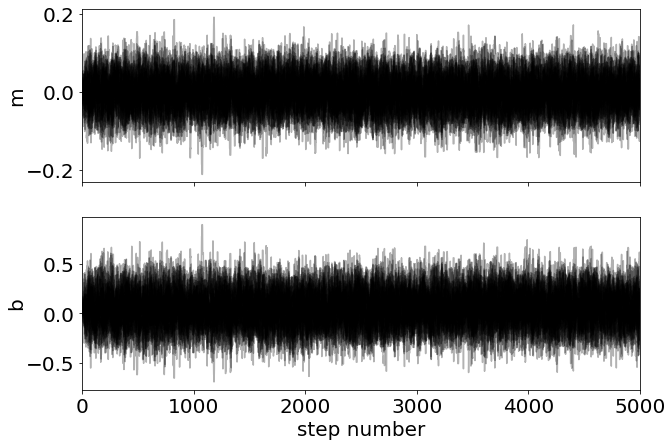

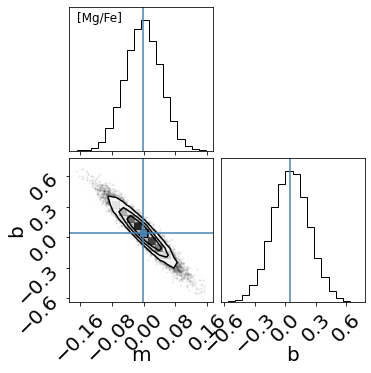

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Si/Fe] ###


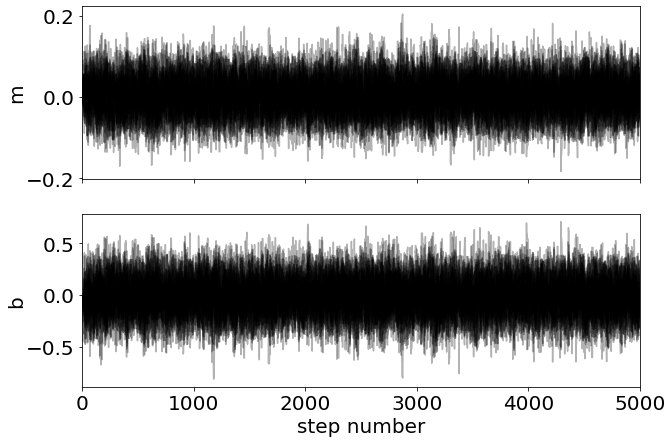

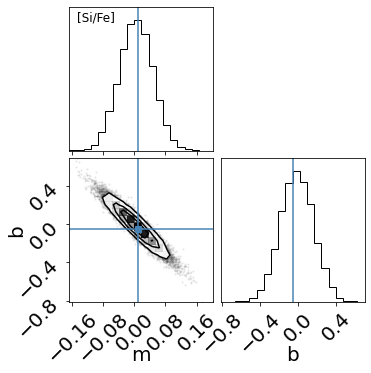

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ca/Fe] ###


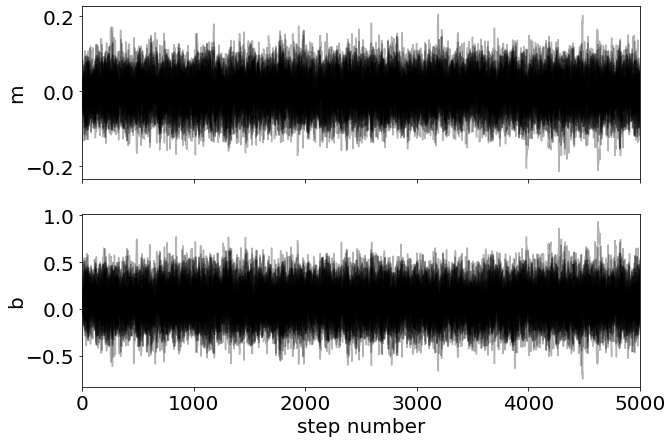

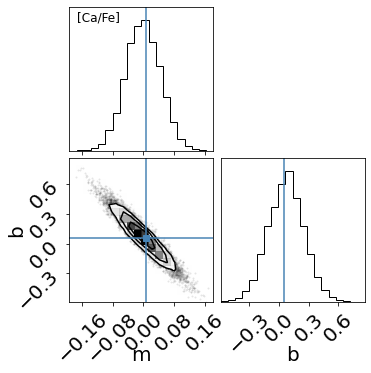

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Na/Fe] ###


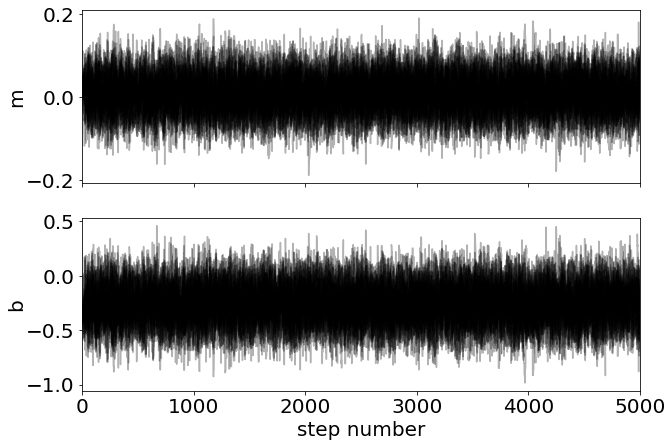

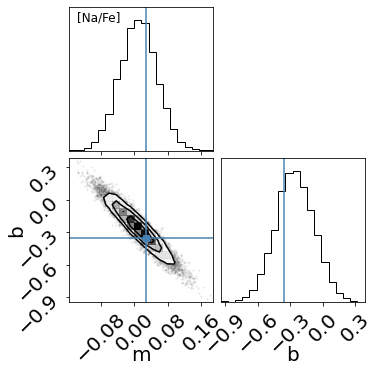

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Al/Fe] ###


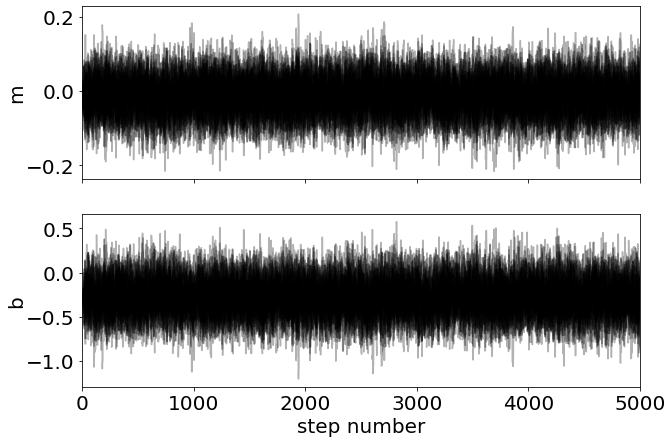

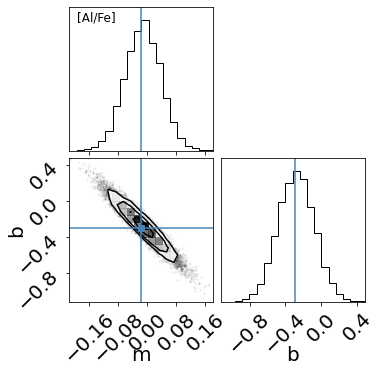

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Cr/Fe] ###


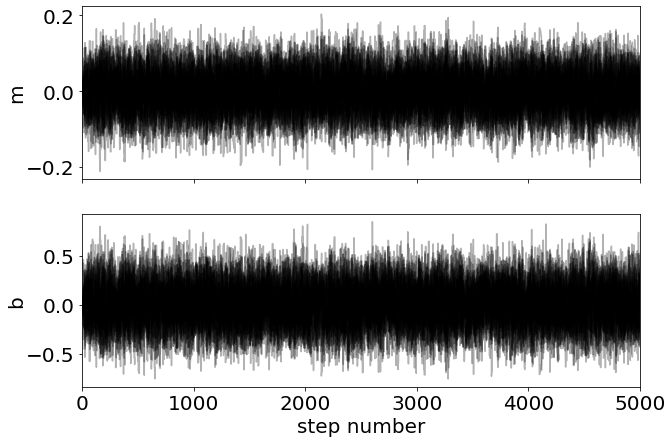

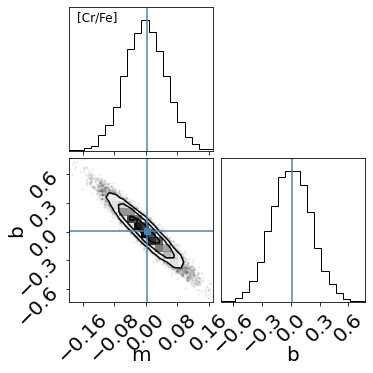

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Co/Fe] ###


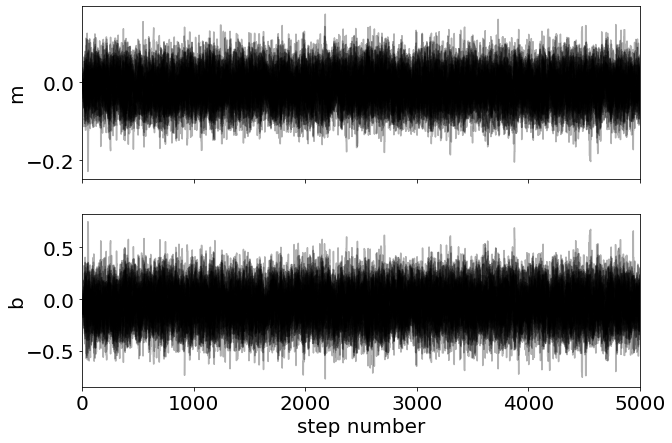

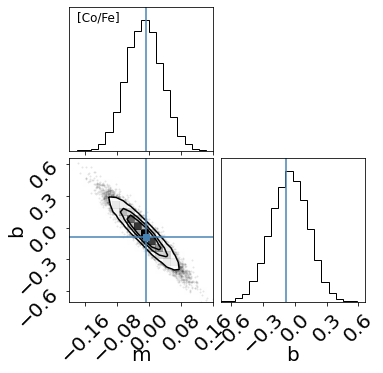

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ni/Fe] ###


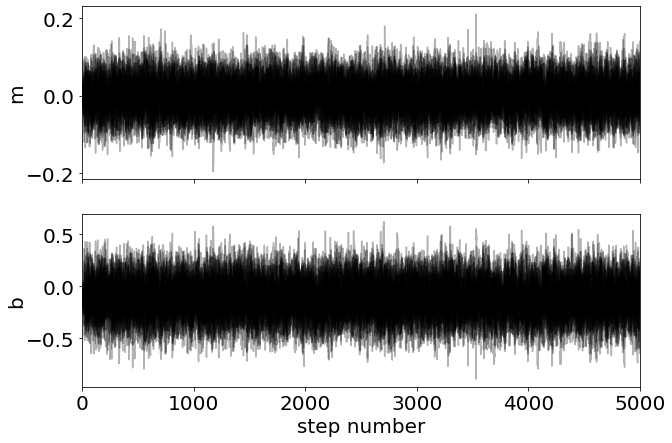

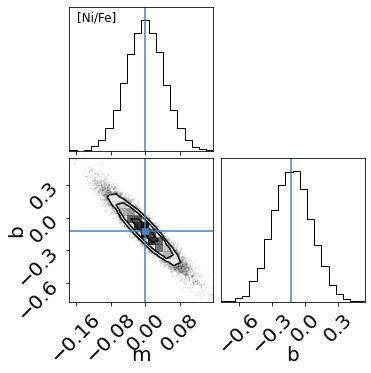

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [59]:
omed_regrads = []
omed_regrads_err = []
omed_reinter = []
omed_reinter_err = []

prune_fact = 3.
for i in tqdm_notebook(range(len(omed_grads))):
    
    def initialmodl(x):
        return omed_grads[i]*x+omed_inter[i]
    
    cln = np.where((np.isfinite(lmcomed[elems[i]])==True)&(lmcomed[elems[i]]!=-9999.0)&(lmcomed['SNR']>100.))
    plugin = initialmodl(radiusomed[cln])
    distmad = mad(plugin-lmcomed[elems[i]][cln]) 
    
    prune = np.where((lmcomed[elems[i]][cln]>-prune_fact*distmad+np.median(lmcomed[elems[i]][cln]))&
                     (lmcomed[elems[i]][cln]<prune_fact*distmad+np.median(lmcomed[elems[i]][cln]))) 
    
    prune_radius = radiusomed[cln][prune]
    prune_abund = lmcomed[elems[i]][cln][prune]
    prune_abund_err = lmcomed[elems[i]+'_ERR'][cln][prune]
    
    bins = np.arange(np.floor(np.min(prune_radius)),np.ceil(np.max(prune_radius))+1.0,1.0)
    bin_stats, bin_edges, bin_number = binned_statistic(prune_radius,prune_abund,statistic='median',bins=bins)
    bin_stats_err, _, _ = binned_statistic(prune_radius,prune_abund,
                                           statistic=lambda y: np.median(np.abs(y-np.median(y))),bins=bins)
    
    center_rad_bins = np.arange(len(bin_stats))+0.5
    
    m_guess = (bin_stats[1]-bin_stats[0])/(center_rad_bins[1]-center_rad_bins[0])
    b_guess = bin_stats[0]
    
    nll = lambda *args: -lnL(*args)
    initial = np.array([m_guess, b_guess]) + 1e-2*np.random.randn(2)
    soln = minimize(nll, initial, args=(center_rad_bins,bin_stats,0.5*np.ones(len(bin_stats)),bin_stats_err))
    mle_m, mle_b = soln.x
    
    pos = [mle_m,mle_b]+1e-2*np.random.randn(32,2)
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, args=(prune_radius,prune_abund,
                                                                  0.5*np.ones(len(prune_radius)),
                                                                  prune_abund_err))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('refit_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_m, mle_b])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('refit_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    omed_regrads.append(np.median(flat_samples[:,0]))
    omed_regrads_err.append(mad(flat_samples[:,0]))
    omed_reinter.append(np.median(flat_samples[:,1]))
    omed_reinter_err.append(mad(flat_samples[:,1]))

In [60]:
for i in range(len(regrads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],omed_regrads[i],
                                                                         omed_regrads_err[i],omed_reinter[i],
                                                                         omed_reinter_err[i]))

FE_H slope: -0.0217 +/- 0.0321; inter: -0.6294 +/- 0.1261
O_FE slope: 0.0011 +/- 0.0299; inter: 0.0396 +/- 0.1199
MG_FE slope: -0.0015 +/- 0.0304; inter: 0.0530 +/- 0.1220
SI_FE slope: 0.0036 +/- 0.0295; inter: -0.0131 +/- 0.1187
CA_FE slope: -0.0016 +/- 0.0305; inter: 0.0735 +/- 0.1210
NA_FE slope: 0.0095 +/- 0.0298; inter: -0.2608 +/- 0.1198
AL_FE slope: -0.0121 +/- 0.0336; inter: -0.2818 +/- 0.1380
CR_FE slope: -0.0011 +/- 0.0353; inter: 0.0047 +/- 0.1404
CO_FE slope: -0.0134 +/- 0.0302; inter: -0.0491 +/- 0.1212
NI_FE slope: -0.0006 +/- 0.0297; inter: -0.1174 +/- 0.1218


# Old Gradients

### [Fe/H] ###


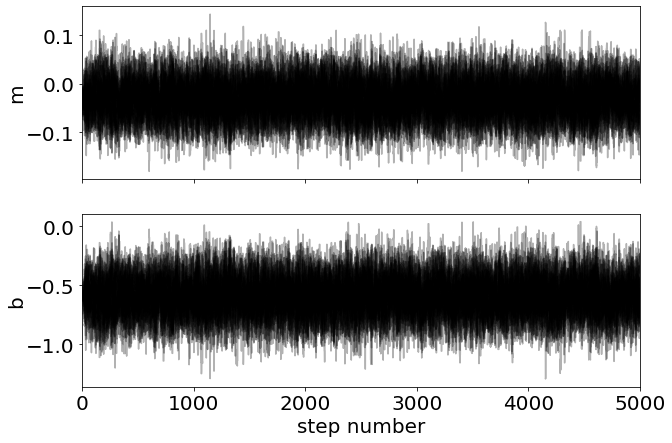

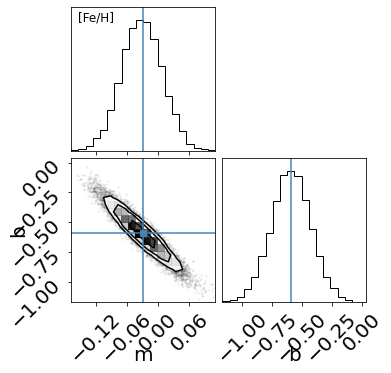

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [O/Fe] ###


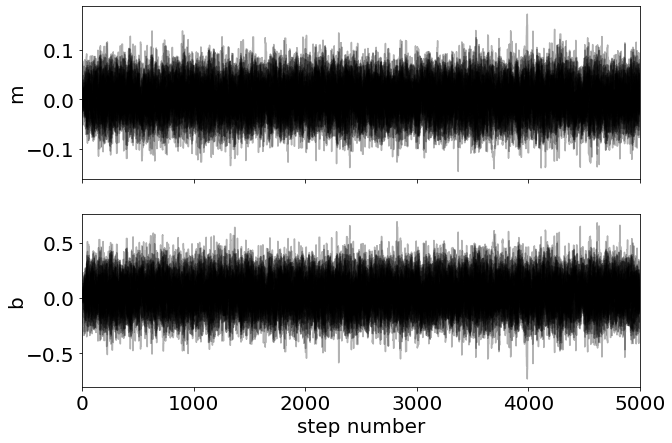

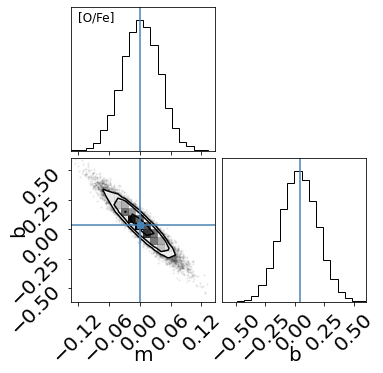

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Mg/Fe] ###


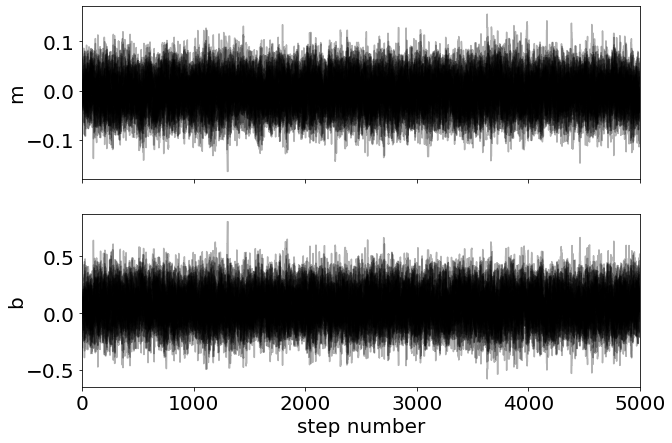

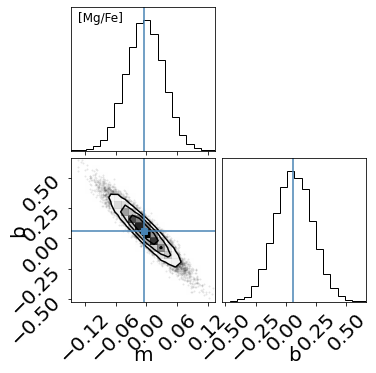

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Si/Fe] ###


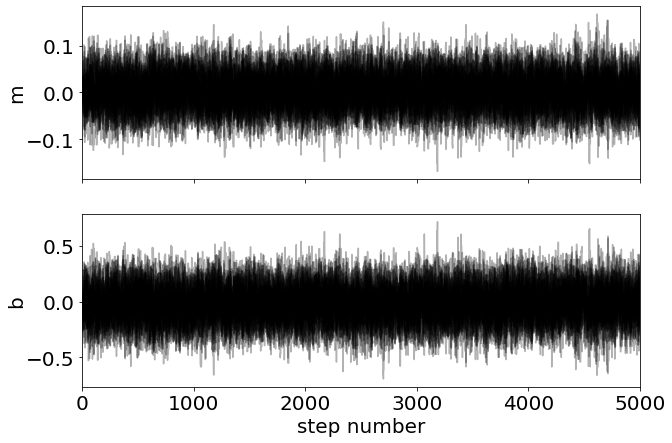

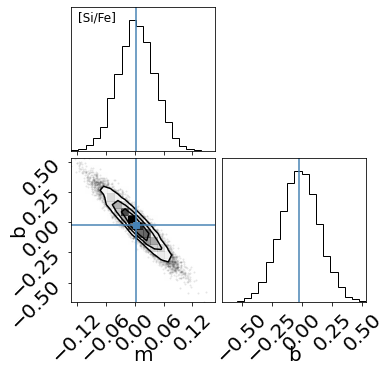

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ca/Fe] ###


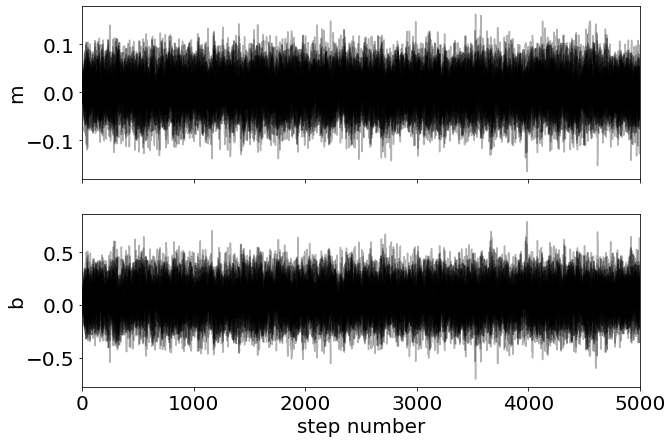

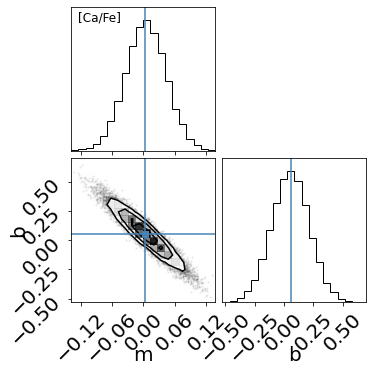

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Na/Fe] ###


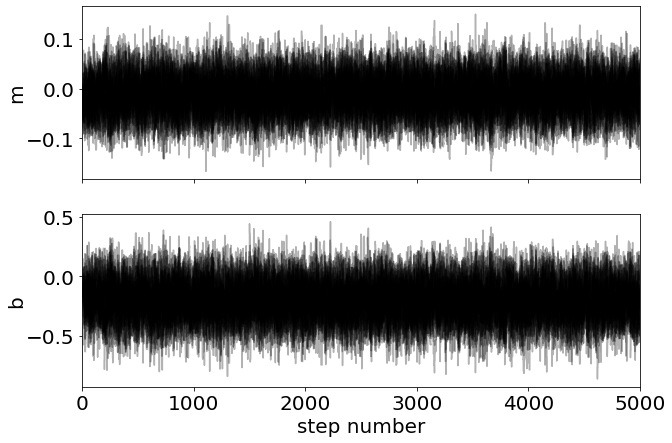

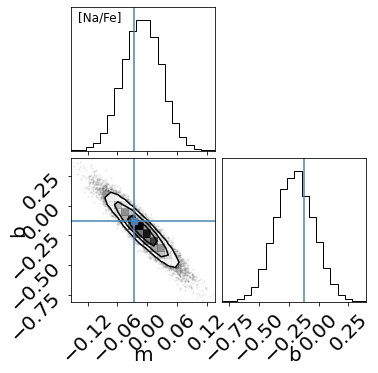

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Al/Fe] ###


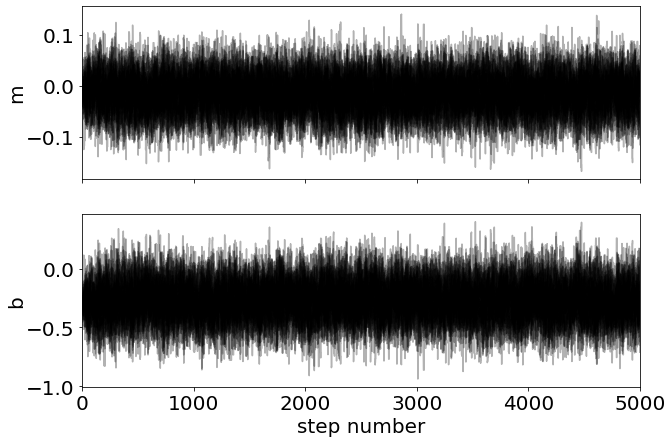

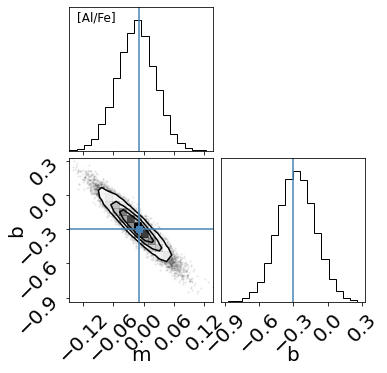

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Cr/Fe] ###


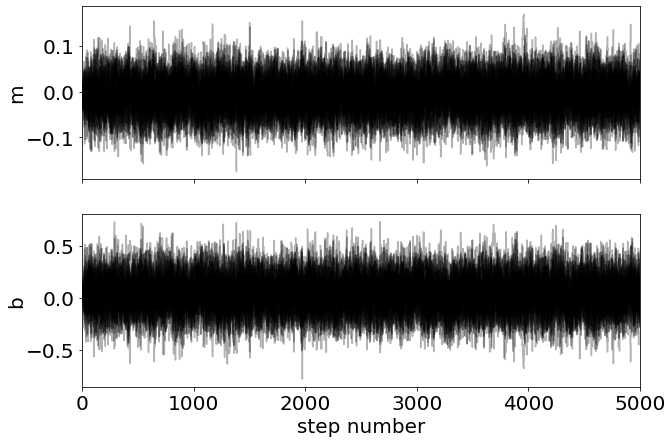

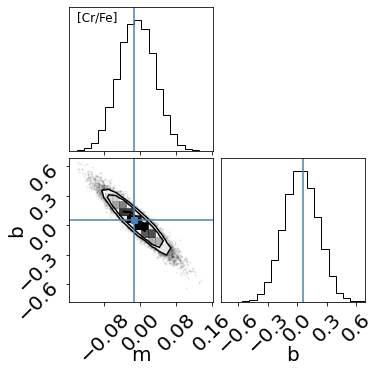

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Co/Fe] ###


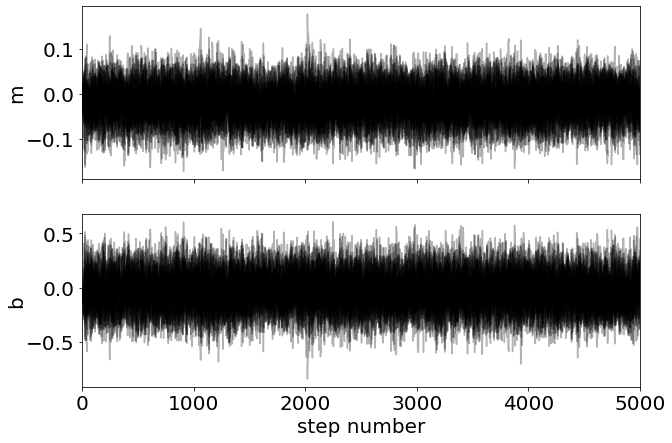

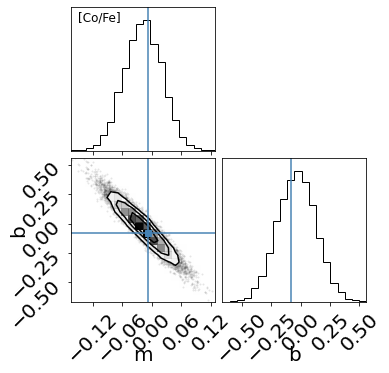

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ni/Fe] ###


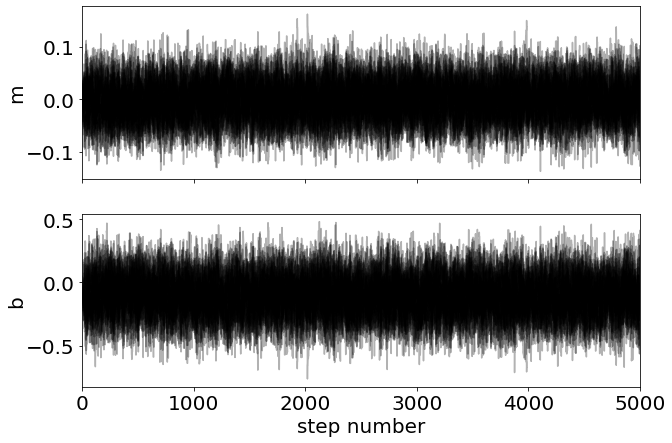

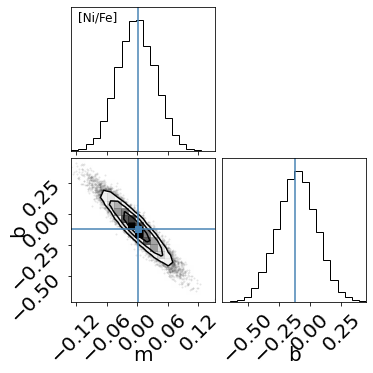

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [61]:
old_regrads = []
old_regrads_err = []
old_reinter = []
old_reinter_err = []

prune_fact = 3.
for i in tqdm_notebook(range(len(old_grads))):
    
    def initialmodl(x):
        return old_grads[i]*x+old_inter[i]
    
    cln = np.where((np.isfinite(lmcold[elems[i]])==True)&(lmcold[elems[i]]!=-9999.0)&(lmcold['SNR']>100.))
    plugin = initialmodl(radiusold[cln])
    distmad = mad(plugin-lmcold[elems[i]][cln]) 
    
    prune = np.where((lmcold[elems[i]][cln]>-prune_fact*distmad+np.median(lmcold[elems[i]][cln]))&
                     (lmcold[elems[i]][cln]<prune_fact*distmad+np.median(lmcold[elems[i]][cln]))) 
    
    prune_radius = radiusold[cln][prune]
    prune_abund = lmcold[elems[i]][cln][prune]
    prune_abund_err = lmcold[elems[i]+'_ERR'][cln][prune]
    
    bins = np.arange(np.floor(np.min(prune_radius)),np.ceil(np.max(prune_radius))+1.0,1.0)
    bin_stats, bin_edges, bin_number = binned_statistic(prune_radius,prune_abund,statistic='median',bins=bins)
    bin_stats_err, _, _ = binned_statistic(prune_radius,prune_abund,
                                           statistic=lambda y: np.median(np.abs(y-np.median(y))),bins=bins)
    
    center_rad_bins = np.arange(len(bin_stats))+0.5
    
    m_guess = (bin_stats[1]-bin_stats[0])/(center_rad_bins[1]-center_rad_bins[0])
    b_guess = bin_stats[0]
    
    nll = lambda *args: -lnL(*args)
    initial = np.array([m_guess, b_guess]) + 1e-2*np.random.randn(2)
    soln = minimize(nll, initial, args=(center_rad_bins,bin_stats,0.5*np.ones(len(bin_stats)),bin_stats_err))
    mle_m, mle_b = soln.x
    
    pos = [mle_m,mle_b]+1e-2*np.random.randn(32,2)
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, args=(prune_radius,prune_abund,
                                                                  0.5*np.ones(len(prune_radius)),
                                                                  prune_abund_err))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('refit_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_m, mle_b])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('refit_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    old_regrads.append(np.median(flat_samples[:,0]))
    old_regrads_err.append(mad(flat_samples[:,0]))
    old_reinter.append(np.median(flat_samples[:,1]))
    old_reinter_err.append(mad(flat_samples[:,1]))

In [62]:
for i in range(len(regrads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],old_regrads[i],
                                                                         old_regrads_err[i],old_reinter[i],
                                                                         old_reinter_err[i]))

FE_H slope: -0.0317 +/- 0.0263; inter: -0.5930 +/- 0.1107
O_FE slope: 0.0018 +/- 0.0244; inter: 0.0365 +/- 0.1054
MG_FE slope: -0.0029 +/- 0.0242; inter: 0.0629 +/- 0.1055
SI_FE slope: 0.0026 +/- 0.0253; inter: -0.0171 +/- 0.1071
CA_FE slope: 0.0041 +/- 0.0260; inter: 0.0523 +/- 0.1079
NA_FE slope: -0.0101 +/- 0.0259; inter: -0.2031 +/- 0.1124
AL_FE slope: -0.0148 +/- 0.0250; inter: -0.2724 +/- 0.1118
CR_FE slope: -0.0081 +/- 0.0274; inter: 0.0372 +/- 0.1185
CO_FE slope: -0.0177 +/- 0.0263; inter: -0.0323 +/- 0.1128
NI_FE slope: -0.0022 +/- 0.0251; inter: -0.1061 +/- 0.1064


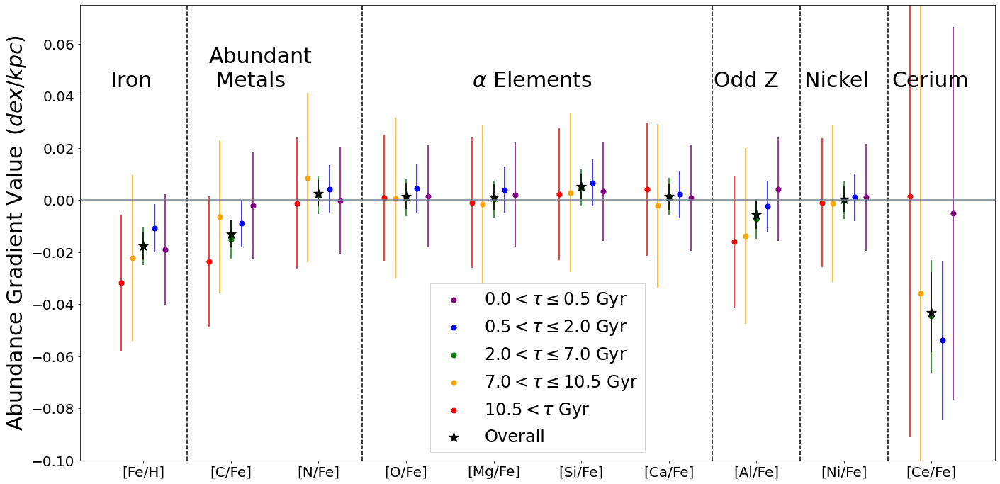

In [83]:
####################
### Summary plot ###
####################

# elements: Fe, C, N, O, Mg, Si, Ca, Al, Ni, Ce
    
idx = [np.squeeze(np.where(np.asarray(elems)=='FE_H')),np.squeeze(np.where(np.asarray(elems)=='O_FE')),
       np.squeeze(np.where(np.asarray(elems)=='MG_FE')),np.squeeze(np.where(np.asarray(elems)=='SI_FE')),
       np.squeeze(np.where(np.asarray(elems)=='CA_FE')),np.squeeze(np.where(np.asarray(elems)=='NA_FE')),
       np.squeeze(np.where(np.asarray(elems)=='AL_FE')),np.squeeze(np.where(np.asarray(elems)=='CR_FE')),
       np.squeeze(np.where(np.asarray(elems)=='CO_FE')),np.squeeze(np.where(np.asarray(elems)=='NI_FE'))]

good_young = []
good_yless = []
good_ymed = []
good_omed = []
good_old = []
good_over = []

err_young = []
err_yless = []
err_ymed = []
err_omed = []
err_old = []
err_over = []

for i in idx:
    good_young.append(young_regrads[i])
    good_yless.append(yless_regrads[i])
    good_ymed.append(ymed_regrads[i])
    good_omed.append(omed_regrads[i])
    good_old.append(old_regrads[i])
    good_over.append(regrads[i])
    
    err_young.append(young_regrads_err[i])
    err_yless.append(yless_regrads_err[i])
    err_ymed.append(ymed_regrads_err[i])
    err_omed.append(omed_regrads_err[i])
    err_old.append(old_regrads_err[i])
    err_over.append(regrads_err[i])

matplotlib.rcParams.update({'font.size': 20})
fig = plt.figure(figsize=[20,10])

plt.scatter(np.add(np.arange(10),0.25),good_young,c='purple',label='$0.0 < \\tau \leq 0.5$ Gyr',s=50)
plt.errorbar(np.add(np.arange(10),0.25),good_young,yerr=err_young,c='purple',ls='none')

plt.scatter(np.add(np.arange(10),0.125),good_yless,c='blue',label='$0.5 < \\tau \leq 2.0$ Gyr',s=50)
plt.errorbar(np.add(np.arange(10),0.125),good_yless,yerr=err_yless,c='blue',ls='none')

plt.scatter([0,1,2,3,4,5,6,7,8,9],good_ymed,c='green',label='$2.0 < \\tau \leq 7.0$ Gyr',s=50)
plt.errorbar([0,1,2,3,4,5,6,7,8,9],good_ymed,yerr=err_ymed,c='green',ls='none')

plt.scatter(np.subtract(np.arange(10),0.125),good_omed,c='orange',label='$7.0 < \\tau \leq 10.5$ Gyr',s=50)
plt.errorbar(np.subtract(np.arange(10),0.125),good_omed,yerr=err_omed,c='orange',ls='none')

plt.scatter(np.subtract(np.arange(10),0.25),good_old,c='red',label='$10.5 < \\tau $ Gyr',s=50)
plt.errorbar(np.subtract(np.arange(10),0.25),good_old,yerr=err_old,c='red',ls='none')

plt.scatter([0,1,2,3,4,5,6,7,8,9],good_over,marker='*',c='black',label='Overall',s=200)
plt.errorbar([0,1,2,3,4,5,6,7,8,9],good_over,yerr=err_over,c='black',ls='none')

xplotlab = ['[Fe/H]','[O/Fe]','[Mg/Fe]','[Si/Fe]','[Ca/Fe]','[Na/Fe]','[Al/Fe]','[Cr/Fe]','[Co/Fe]','[Ni/Fe]']

xplotpos = [0,1,2,3,4,5,6,7,8,9]#,10] 
plt.xticks(xplotpos,xplotlab)

plt.axvline(0.5,c='k',ls='--')
plt.axvline(4.5,c='k',ls='--')
plt.axvline(6.5,c='k',ls='--')
plt.axhline(0.0,c='slategrey',ls='-')
plt.ylabel('Abundance Gradient Value $\,(dex/kpc)$',fontsize=30)

# plt.gca().set_ylim(top=0.05)

plt.text(-0.375,0.0425,'Iron',fontsize=30)
plt.text(1.75,0.0425,'$\\alpha$ Elements',fontsize=30)
plt.text(5.0,0.0425,'Odd Z',fontsize=30)
plt.text(7.4,0.0425,'Iron Peak',fontsize=30)

# plt.ylim(bottom=-0.045)
# plt.ylim(-0.05,0.05)
plt.ylim(-0.1,0.075)

plt.legend(loc='bottom center',frameon=True,fancybox=False,fontsize='large')
plt.tight_layout()
plt.title(r'DR17 MCMC Original Elements')
plt.savefig('dr17mcmcoriginalsummary.png',bbox_inches='tight')
plt.show()

# 3 MAD Cut and Refit

### [C/Fe] ###


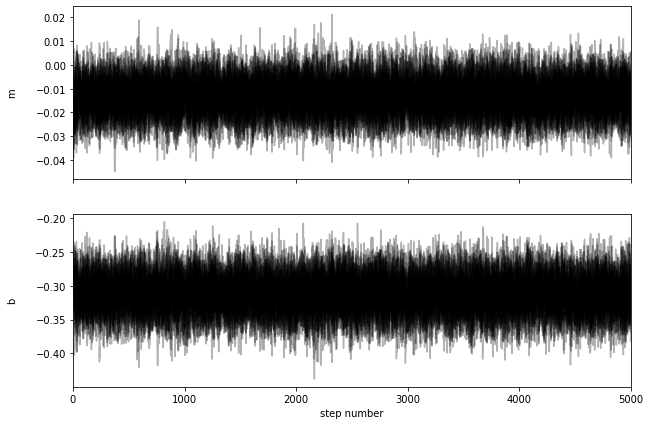

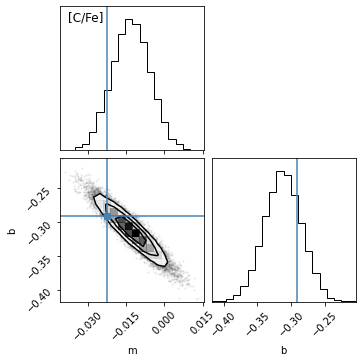

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [N/Fe] ###


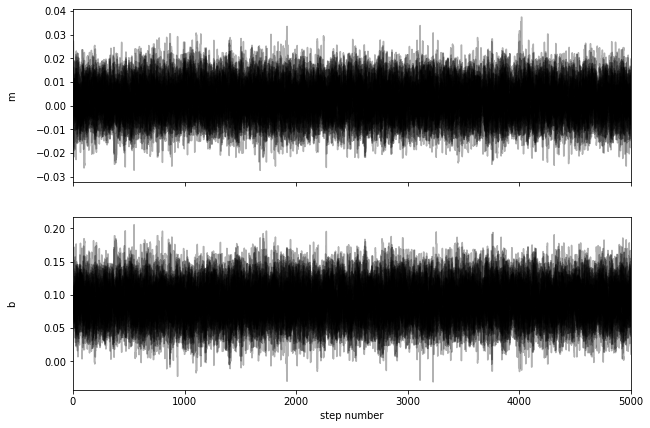

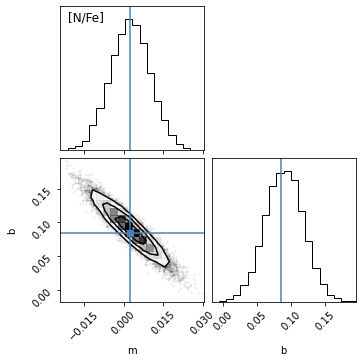

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [O/Fe] ###


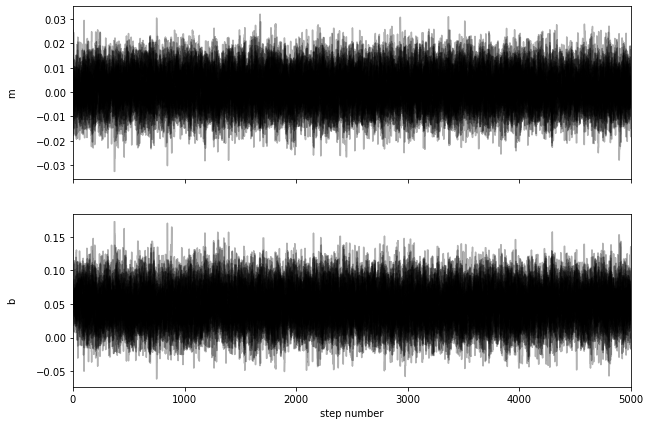

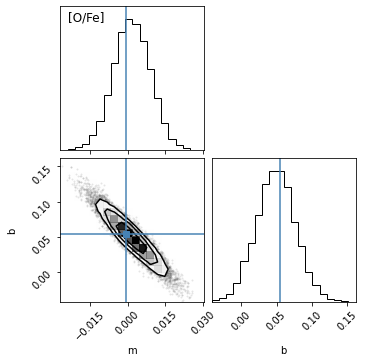

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Mg/Fe] ###


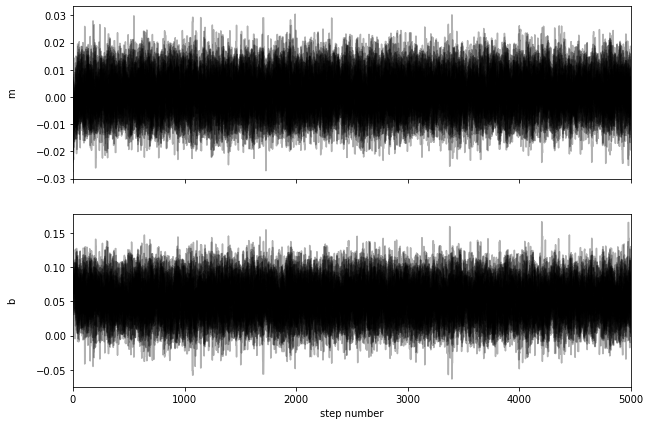

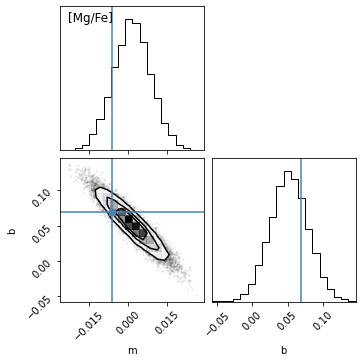

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Al/Fe] ###


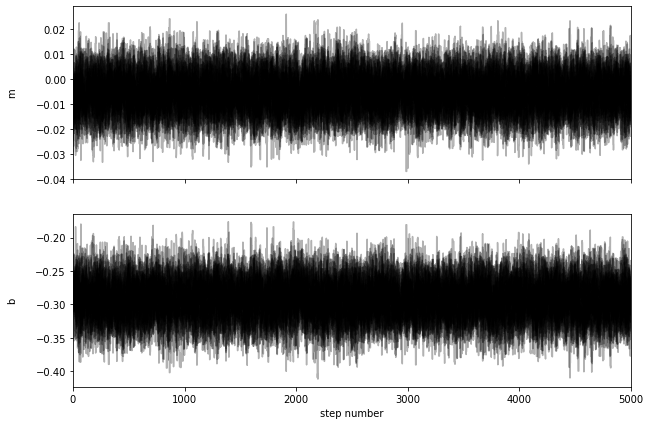

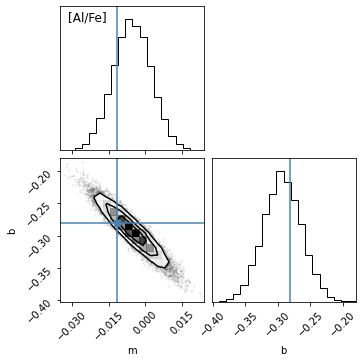

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Si/Fe] ###


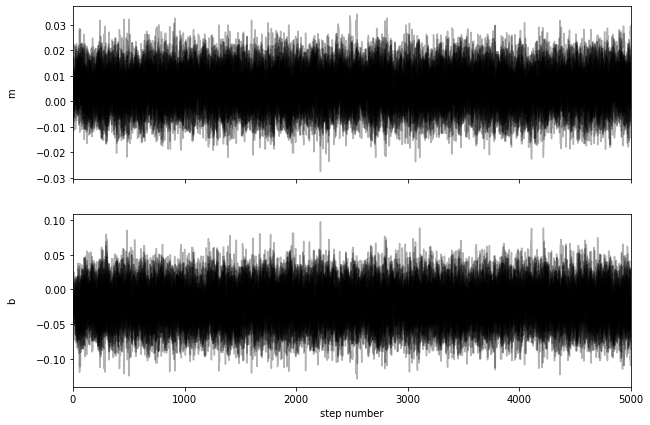

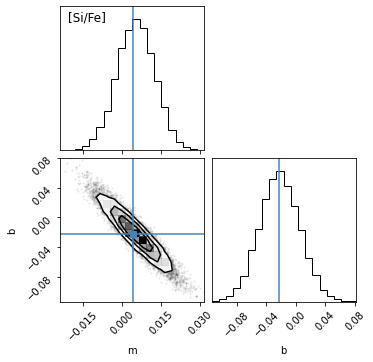

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ca/Fe] ###


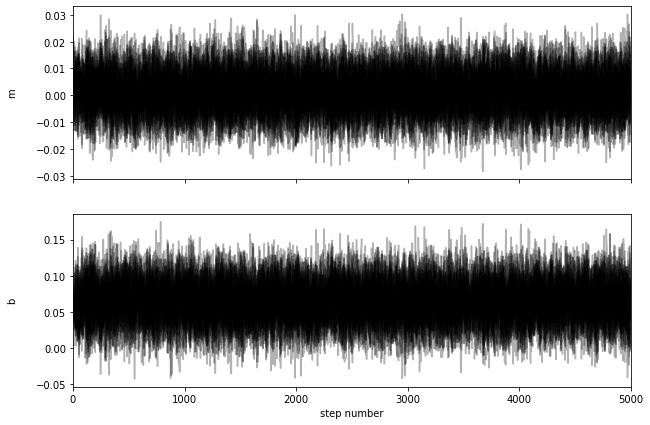

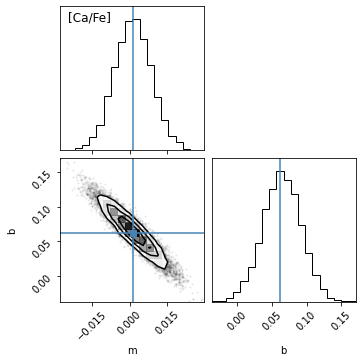

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Fe/H] ###


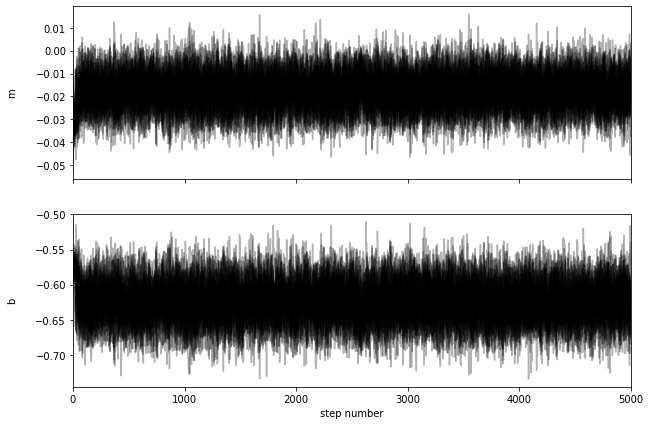

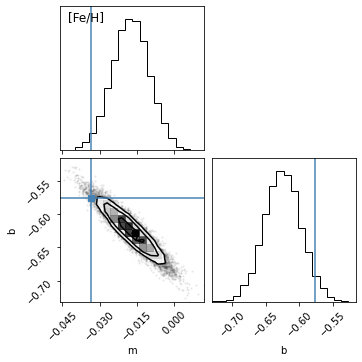

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ni/Fe] ###


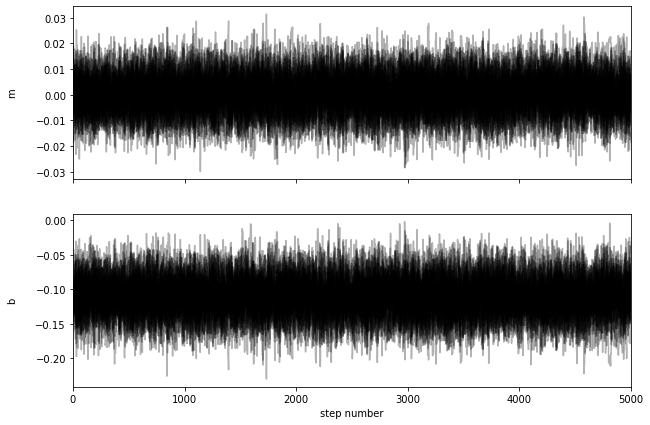

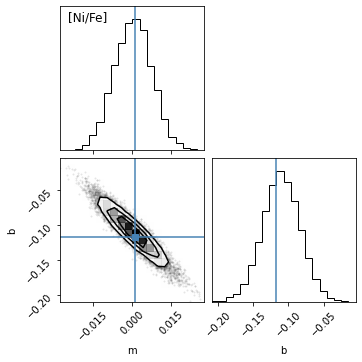

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [Ce/Fe] ###


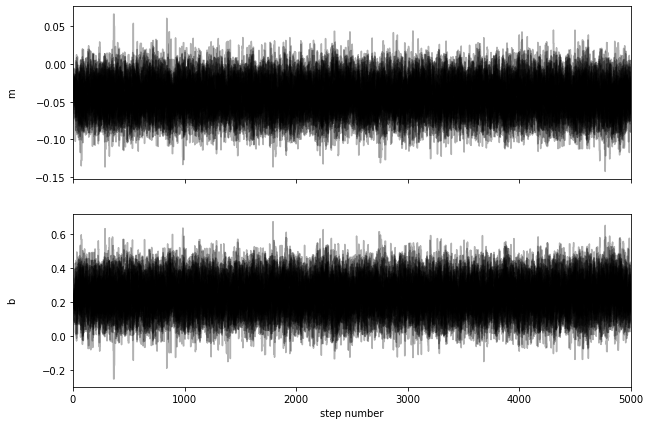

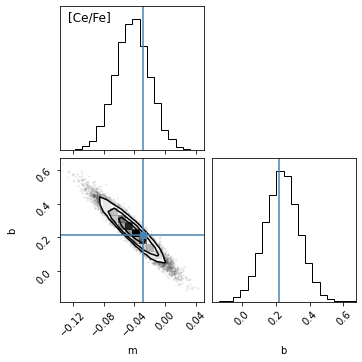

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### [$\alpha$/Fe] ###


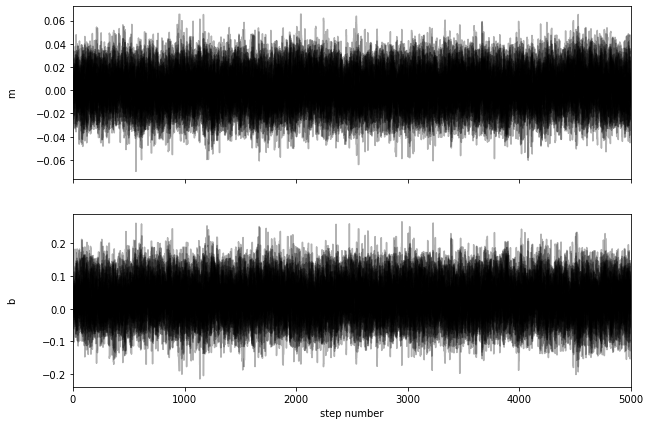

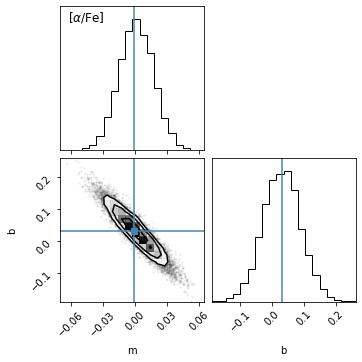

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [22]:
remle_ms = []
remle_bs = []

regrads = []
regrads_err = []
reinter = []
reinter_err = []

prune_fact = 3.
for i in tqdm_notebook(range(len(grads))):
    
    def initialmodl(x):
        return grads[i]*x+inter[i]
    
    cln = np.where((np.isfinite(lmc[elems[i]])==True)&(lmc[elems[i]]!=-9999.0)&(lmc['SNR']>100.))
    plugin = initialmodl(radius[cln])
    distmad = mad(plugin-lmc[elems[i]][cln]) 
    
    prune = np.where((lmc[elems[i]][cln]>-prune_fact*distmad+np.median(lmc[elems[i]][cln]))&
                     (lmc[elems[i]][cln]<prune_fact*distmad+np.median(lmc[elems[i]][cln]))) 
    
    prune_radius = radius[cln][prune]
    prune_abund = lmc[elems[i]][cln][prune]
    prune_abund_err = lmc[elems[i]+'_ERR'][cln][prune]
    
    bins = np.arange(np.floor(np.min(prune_radius)),np.ceil(np.max(prune_radius))+1.0,1.0)
    bin_stats, bin_edges, bin_number = binned_statistic(prune_radius,prune_abund,statistic='median',bins=bins)
    bin_stats_err, _, _ = binned_statistic(prune_radius,prune_abund,
                                           statistic=lambda y: np.median(np.abs(y-np.median(y))),bins=bins)
    
    center_rad_bins = np.arange(len(bin_stats))+0.5
    
    m_guess = (bin_stats[1]-bin_stats[0])/(center_rad_bins[1]-center_rad_bins[0])
    b_guess = bin_stats[0]
    
    nll = lambda *args: -lnL(*args)
    initial = np.array([m_guess, b_guess]) + 1e-3*np.random.randn(2)
    soln = minimize(nll, initial, args=(center_rad_bins,bin_stats,0.5*np.ones(len(bin_stats)),bin_stats_err))
    mle_m, mle_b = soln.x
    
    remle_ms.append(mle_m)
    remle_bs.append(mle_b)
    
    pos = [mle_m,mle_b]+1e-2*np.random.randn(32,2)
    
    sampler = emcee.EnsembleSampler(pos.shape[0], pos.shape[1], lnProb, args=(prune_radius,prune_abund,
                                                                  0.5*np.ones(len(prune_radius)),
                                                                  prune_abund_err))
    sampler.run_mcmc(pos, 5000, progress=False)
    
    print('### {} ###'.format(labs[i]))
    
    fig, axes = plt.subplots(2,figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["m", "b"]
    for j in range(pos.shape[1]):
        ax = axes[j]
        ax.plot(samples[:, :, j], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[j])
        ax.yaxis.set_label_coords(-0.1, 0.5)

    axes[-1].set_xlabel("step number");
    plt.savefig('refit_sampler_{}'.format(elems[i]))
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    
    fig = corner.corner(flat_samples, labels=labels, truths=[mle_m, mle_b])
    fig.text(0.2,0.89,r'{}'.format(labs[i]),fontsize=12)
    plt.savefig('refit_corner_{}'.format(elems[i]))
    plt.show()

    for k in range(pos.shape[1]):
        txt = "\mathrm{{{3}}} = {0:.4f}_{{-{1:.4f}}}^{{{2:.4f}}}"
        txt = txt.format(np.median(flat_samples[:,k]), mad(flat_samples[:,k]), mad(flat_samples[:,k]), labels[k])
        display(Math(txt))
        
    regrads.append(np.median(flat_samples[:,0]))
    regrads_err.append(mad(flat_samples[:,0]))
    reinter.append(np.median(flat_samples[:,1]))
    reinter_err.append(mad(flat_samples[:,1]))

In [23]:
for i in range(len(regrads)):
    print('{} slope: {:.4f} +/- {:.4f}; inter: {:.4f} +/- {:.4f}'.format(elems[i],regrads[i],regrads_err[i],
                                                                          reinter[i],reinter_err[i]))

C_FE slope: -0.0131 +/- 0.0051; inter: -0.3125 +/- 0.0187
N_FE slope: 0.0026 +/- 0.0051; inter: 0.0900 +/- 0.0193
O_FE slope: 0.0016 +/- 0.0050; inter: 0.0488 +/- 0.0185
MG_FE slope: 0.0015 +/- 0.0049; inter: 0.0520 +/- 0.0179
AL_FE slope: -0.0055 +/- 0.0052; inter: -0.2931 +/- 0.0199
SI_FE slope: 0.0053 +/- 0.0049; inter: -0.0221 +/- 0.0184
CA_FE slope: 0.0012 +/- 0.0050; inter: 0.0642 +/- 0.0187
FE_H slope: -0.0175 +/- 0.0051; inter: -0.6250 +/- 0.0184
NI_FE slope: 0.0003 +/- 0.0049; inter: -0.1104 +/- 0.0180
CE_FE slope: -0.0428 +/- 0.0151; inter: 0.2381 +/- 0.0669
ALPHA_FE slope: 0.0012 +/- 0.0111; inter: 0.0299 +/- 0.0394
